正在加载和处理CGSS2003数据...
数据加载成功，数据形状: (5894, 898)

年龄数据统计摘要

【受访者】
  有效样本数: 5,894
  平均年龄: 43.38 岁
  中位数年龄: 43.00 岁
  标准差: 13.11
  年龄范围: 15 - 77 岁
  四分位数: Q1=33.0, Q3=53.0
  年龄组分布:
    30-45岁: 2,279 人 (38.7%)
    45-60岁: 1,803 人 (30.6%)
    18-30岁: 998 人 (16.9%)
    60岁以上: 750 人 (12.7%)
    18岁以下: 64 人 (1.1%)

【父亲】
  有效样本数: 4,849
  平均年龄: 72.45 岁
  中位数年龄: 72.00 岁
  标准差: 14.57
  年龄范围: 38 - 120 岁
  四分位数: Q1=62.0, Q3=82.0

【母亲】
  有效样本数: 4,977
  平均年龄: 69.49 岁
  中位数年龄: 70.00 岁
  标准差: 14.05
  年龄范围: 35 - 120 岁
  四分位数: Q1=59.0, Q3=79.0

【配偶】
  有效样本数: 5,137
  平均年龄: 45.86 岁
  中位数年龄: 45.00 岁
  标准差: 12.14
  年龄范围: 19 - 89 岁
  四分位数: Q1=36.0, Q3=54.0

【家庭成员5】
  有效样本数: 4,102
  平均年龄: 19.77 岁
  中位数年龄: 17.00 岁
  标准差: 14.55
  年龄范围: 0 - 96 岁
  四分位数: Q1=11.0, Q3=25.0

【家庭成员6】
  有效样本数: 1,312
  平均年龄: 23.50 岁
  中位数年龄: 21.00 岁
  标准差: 17.42
  年龄范围: 0 - 98 岁
  四分位数: Q1=12.0, Q3=30.0

【家庭成员7】
  有效样本数: 557
  平均年龄: 17.53 岁
  中位数年龄: 13.00 岁
  标准差: 16.89
  年龄范围: 0 - 92 岁
  四分位数: Q1=5.0, Q3=25.0

【家庭成员9】
  有效样本数: 81
  平均年龄: 

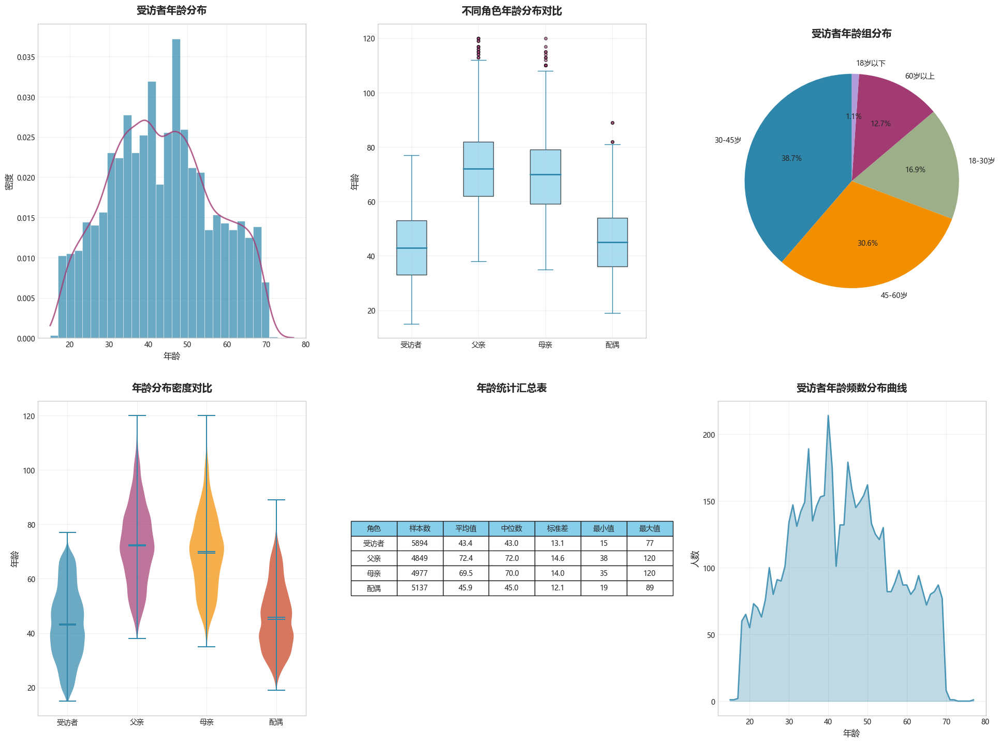


正在生成详细年龄分析图表...


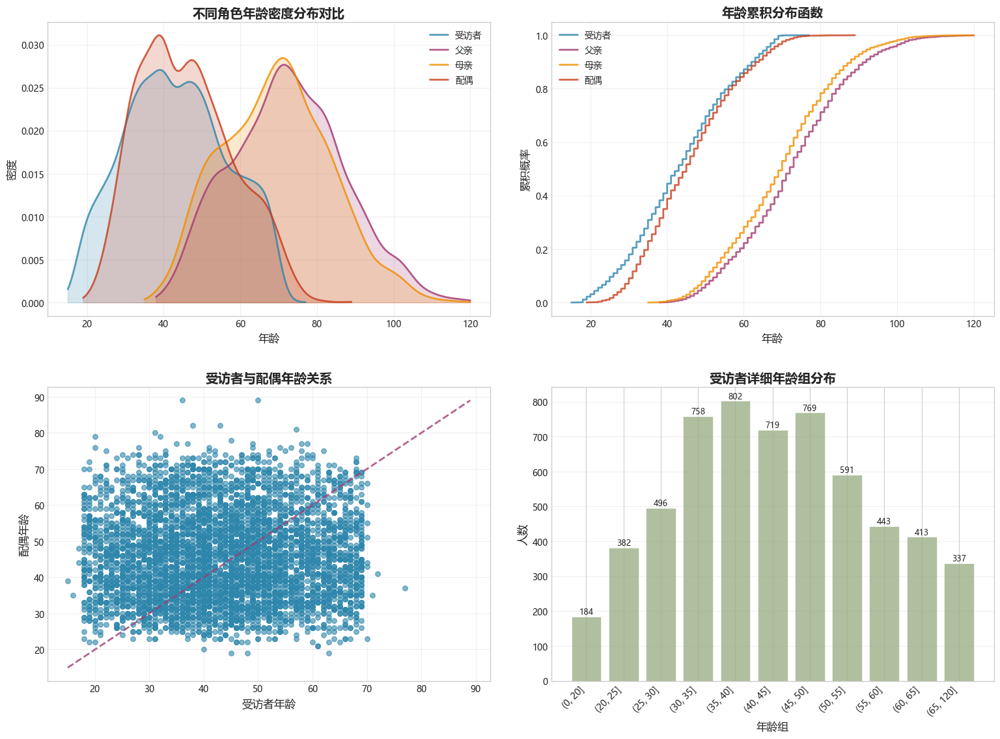


可视化图表已生成完成！
- CGSS2003_年龄分布综合分析.png: 包含直方图、箱线图、饼图、小提琴图、统计表和趋势图
- CGSS2003_年龄详细分析.png: 包含密度对比图、累积分布函数、年龄关系散点图和详细分组


In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
import warnings
warnings.filterwarnings('ignore')

# 后设置中文字体（推荐使用微软雅黑）
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']  # 改用更通用的字体
plt.rcParams['axes.unicode_minus'] = False





# 设置顶刊风格的配色方案 - 低饱和度、协调美观
COLORS = {
    'primary': '#2E86AB',      # 深蓝色
    'secondary': '#A23B72',    # 深玫红
    'tertiary': '#F18F01',     # 温暖橙色  
    'quaternary': '#C73E1D',   # 深红色
    'light_blue': '#87CEEB',   # 浅蓝色
    'sage_green': '#9CAF88',   # 鼠尾草绿
    'warm_gray': '#8D8680',    # 暖灰色
    'soft_purple': '#B19CD9'   # 柔和紫色
}

# 设置全局样式
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette([COLORS['primary'], COLORS['secondary'], COLORS['tertiary'], 
                COLORS['quaternary'], COLORS['sage_green'], COLORS['soft_purple']])

def load_and_process_data(file_path):
    """
    加载并处理CGSS数据
    """
    try:
        # 读取dta文件，设置convert_categoricals=False避免标签重复问题
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"数据加载成功，数据形状: {df.shape}")
        
        # 年龄相关字段处理
        current_year = 2003  # 调查年份
        
        # 计算各种年龄
        age_vars = {}
        
        # 受访者年龄
        if 'birth' in df.columns:
            df['age'] = current_year - df['birth']
            age_vars['受访者'] = df['age']
        
        # 父亲年龄
        if 'f_birth' in df.columns:
            df['f_age'] = current_year - df['f_birth']
            age_vars['父亲'] = df['f_age']
        
        # 母亲年龄
        if 'm_birth' in df.columns:
            df['m_age'] = current_year - df['m_birth']
            age_vars['母亲'] = df['m_age']
        
        # 配偶年龄
        if 's_birth' in df.columns:
            df['s_age'] = current_year - df['s_birth']
            age_vars['配偶'] = df['s_age']
        
        # 家庭成员年龄（第5-10人）
        for i in range(5, 11):
            birth_col = f'birth{i:02d}' if i >= 10 else f'birth0{i}'
            if birth_col in df.columns:
                df[f'age_{i:02d}'] = current_year - df[birth_col]
                age_vars[f'家庭成员{i}'] = df[f'age_{i:02d}']
        
        # 清理异常值（年龄应在合理范围内）
        for key in age_vars:
            age_vars[key] = age_vars[key][(age_vars[key] >= 0) & (age_vars[key] <= 120)]
        
        return df, age_vars
    
    except Exception as e:
        print(f"数据加载失败: {e}")
        return None, None

def create_age_distribution_plots(age_vars):
    """
    创建年龄分布的多种可视化图表
    """
    # 设置图表大小和布局
    fig = plt.figure(figsize=(20, 15))
    # 后设置中文字体（推荐使用微软雅黑）
    plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']  # 改用更通用的字体
    plt.rcParams['axes.unicode_minus'] = False
    # 1. 受访者年龄分布直方图 + 密度曲线
    ax1 = plt.subplot(2, 3, 1)
    if '受访者' in age_vars and len(age_vars['受访者']) > 0:
        ages = age_vars['受访者'].dropna()
        
        # 直方图
        n, bins, patches = ax1.hist(ages, bins=30, alpha=0.7, color=COLORS['primary'], 
                                   density=True, edgecolor='white', linewidth=0.5)
        
        # 密度曲线
        from scipy import stats
        density = stats.gaussian_kde(ages)
        xs = np.linspace(ages.min(), ages.max(), 200)
        ax1.plot(xs, density(xs), color=COLORS['secondary'], linewidth=2, alpha=0.8)
        
        ax1.set_title('受访者年龄分布', fontsize=14, fontweight='bold', pad=15)
        ax1.set_xlabel('年龄', fontsize=12)
        ax1.set_ylabel('密度', fontsize=12)
        ax1.grid(True, alpha=0.3)
    
    # 2. 箱线图对比
    ax2 = plt.subplot(2, 3, 2)
    main_ages = ['受访者', '父亲', '母亲', '配偶']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role].dropna()) > 10:  # 至少10个有效数据
            box_data.append(age_vars[role].dropna())
            box_labels.append(role)
    
    if box_data:
        box_plot = ax2.boxplot(box_data, labels=box_labels, patch_artist=True,
                              boxprops=dict(facecolor=COLORS['light_blue'], alpha=0.7),
                              medianprops=dict(color=COLORS['primary'], linewidth=2),
                              whiskerprops=dict(color=COLORS['primary']),
                              capprops=dict(color=COLORS['primary']),
                              flierprops=dict(marker='o', markerfacecolor=COLORS['secondary'], 
                                            markersize=4, alpha=0.6))
        
        ax2.set_title('不同角色年龄分布对比', fontsize=14, fontweight='bold', pad=15)
        ax2.set_ylabel('年龄', fontsize=12)
        ax2.grid(True, alpha=0.3)
    
    # 3. 年龄分组饼图
    ax3 = plt.subplot(2, 3, 3)
    if '受访者' in age_vars:
        ages = age_vars['受访者'].dropna()
        
        # 创建年龄组
        age_groups = pd.cut(ages, bins=[0, 18, 30, 45, 60, 120], 
                           labels=['18岁以下', '18-30岁', '30-45岁', '45-60岁', '60岁以上'])
        age_counts = age_groups.value_counts()
        
        colors = [COLORS['primary'], COLORS['tertiary'], COLORS['sage_green'], 
                 COLORS['secondary'], COLORS['soft_purple']]
        
        wedges, texts, autotexts = ax3.pie(age_counts.values, labels=age_counts.index,
                                          autopct='%1.1f%%', colors=colors[:len(age_counts)],
                                          startangle=90, textprops={'fontsize': 10})
        
        ax3.set_title('受访者年龄组分布', fontsize=14, fontweight='bold', pad=15)
    
    # 4. 小提琴图
    ax4 = plt.subplot(2, 3, 4)
    if len(box_data) > 1:
        violin_data = pd.DataFrame({label: pd.Series(data) for label, data in zip(box_labels, box_data)})
        
        parts = ax4.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True)
        
        # 设置小提琴图颜色
        for i, pc in enumerate(parts['bodies']):
            pc.set_facecolor(list(COLORS.values())[i % len(COLORS)])
            pc.set_alpha(0.7)
        
        ax4.set_xticks(range(len(box_labels)))
        ax4.set_xticklabels(box_labels)
        ax4.set_title('年龄分布密度对比', fontsize=14, fontweight='bold', pad=15)
        ax4.set_ylabel('年龄', fontsize=12)
        ax4.grid(True, alpha=0.3)
    
    # 5. 年龄统计表格（作为热力图展示）
    ax5 = plt.subplot(2, 3, 5)
    
    # 创建统计数据
    stats_data = []
    for role in ['受访者', '父亲', '母亲', '配偶']:
        if role in age_vars and len(age_vars[role].dropna()) > 0:
            ages = age_vars[role].dropna()
            stats_data.append([
                role,
                len(ages),
                f"{ages.mean():.1f}",
                f"{ages.median():.1f}",
                f"{ages.std():.1f}",
                f"{ages.min():.0f}",
                f"{ages.max():.0f}"
            ])
    
    if stats_data:
        stats_df = pd.DataFrame(stats_data, 
                               columns=['角色', '样本数', '平均值', '中位数', '标准差', '最小值', '最大值'])
        
        # 创建表格
        ax5.axis('tight')
        ax5.axis('off')
        table = ax5.table(cellText=stats_df.values, colLabels=stats_df.columns,
                         cellLoc='center', loc='center',
                         colColours=[COLORS['light_blue']] * len(stats_df.columns))
        table.auto_set_font_size(False)
        table.set_fontsize(10)
        table.scale(1.2, 1.5)
        
        ax5.set_title('年龄统计汇总表', fontsize=14, fontweight='bold', pad=15)
    
    # 6. 年龄与性别的交叉分析（如果有性别数据）
    ax6 = plt.subplot(2, 3, 6)
    
    # 这里创建一个年龄趋势图
    if '受访者' in age_vars:
        ages = age_vars['受访者'].dropna()
        age_range = range(int(ages.min()), int(ages.max()) + 1)
        age_counts = [sum(ages.astype(int) == age) for age in age_range]
        
        ax6.plot(age_range, age_counts, color=COLORS['primary'], linewidth=2, alpha=0.8)
        ax6.fill_between(age_range, age_counts, alpha=0.3, color=COLORS['primary'])
        
        ax6.set_title('受访者年龄频数分布曲线', fontsize=14, fontweight='bold', pad=15)
        ax6.set_xlabel('年龄', fontsize=12)
        ax6.set_ylabel('人数', fontsize=12)
        ax6.grid(True, alpha=0.3)
    
    plt.tight_layout(pad=3.0)
    return fig

def create_detailed_analysis(age_vars):
    """
    创建详细的年龄分析图表
    """
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # 1. 年龄分布的核密度估计对比
    ax1 = axes[0, 0]
    main_roles = ['受访者', '父亲', '母亲', '配偶']
    colors = [COLORS['primary'], COLORS['secondary'], COLORS['tertiary'], COLORS['quaternary']]
    
    for i, role in enumerate(main_roles):
        if role in age_vars and len(age_vars[role].dropna()) > 10:
            ages = age_vars[role].dropna()
            from scipy import stats
            density = stats.gaussian_kde(ages)
            xs = np.linspace(ages.min(), ages.max(), 200)
            ax1.plot(xs, density(xs), label=role, color=colors[i], linewidth=2, alpha=0.8)
            ax1.fill_between(xs, density(xs), alpha=0.2, color=colors[i])
    
    ax1.set_title('不同角色年龄密度分布对比', fontsize=14, fontweight='bold')
    ax1.set_xlabel('年龄', fontsize=12)
    ax1.set_ylabel('密度', fontsize=12)
    ax1.legend()
    ax1.grid(True, alpha=0.3)
    
    # 2. 累积分布函数
    ax2 = axes[0, 1]
    for i, role in enumerate(main_roles):
        if role in age_vars and len(age_vars[role].dropna()) > 10:
            ages = age_vars[role].dropna().sort_values()
            cumulative = np.arange(1, len(ages) + 1) / len(ages)
            ax2.plot(ages, cumulative, label=role, color=colors[i], linewidth=2, alpha=0.8)
    
    ax2.set_title('年龄累积分布函数', fontsize=14, fontweight='bold')
    ax2.set_xlabel('年龄', fontsize=12)
    ax2.set_ylabel('累积概率', fontsize=12)
    ax2.legend()
    ax2.grid(True, alpha=0.3)
    
    # 3. 年龄差异分析（如果有配偶数据）
    ax3 = axes[1, 0]
    if '受访者' in age_vars and '配偶' in age_vars:
        # 计算有效的受访者-配偶对
        respondent_ages = age_vars['受访者'].dropna()
        spouse_ages = age_vars['配偶'].dropna()
        # 后设置中文字体（推荐使用微软雅黑）
        plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']  # 改用更通用的字体
        plt.rcParams['axes.unicode_minus'] = False
        if len(respondent_ages) > 0 and len(spouse_ages) > 0:
            # 创建散点图
            # 这里简化处理，使用相同索引的数据
            min_len = min(len(respondent_ages), len(spouse_ages))
            x_data = respondent_ages.iloc[:min_len]
            y_data = spouse_ages.iloc[:min_len]
            
            ax3.scatter(x_data, y_data, alpha=0.6, color=COLORS['primary'], s=30)
            
            # 添加对角线
            min_age = min(x_data.min(), y_data.min())
            max_age = max(x_data.max(), y_data.max())
            ax3.plot([min_age, max_age], [min_age, max_age], 
                    '--', color=COLORS['secondary'], alpha=0.8, linewidth=2)
            
            ax3.set_title('受访者与配偶年龄关系', fontsize=14, fontweight='bold')
            ax3.set_xlabel('受访者年龄', fontsize=12)
            ax3.set_ylabel('配偶年龄', fontsize=12)
            ax3.grid(True, alpha=0.3)
    
    # 4. 年龄分组的详细统计
    ax4 = axes[1, 1]
    if '受访者' in age_vars:
        ages = age_vars['受访者'].dropna()
        
        # 创建更细致的年龄组
        age_bins = [0, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 120]
        age_groups = pd.cut(ages, bins=age_bins)
        age_counts = age_groups.value_counts().sort_index()
        
        bars = ax4.bar(range(len(age_counts)), age_counts.values, 
                      color=COLORS['sage_green'], alpha=0.8, edgecolor='white', linewidth=0.5)
        
        # 添加数值标签
        for i, bar in enumerate(bars):
            height = bar.get_height()
            ax4.text(bar.get_x() + bar.get_width()/2., height + 0.5,
                    f'{int(height)}', ha='center', va='bottom', fontsize=9)
        
        ax4.set_title('受访者详细年龄组分布', fontsize=14, fontweight='bold')
        ax4.set_xlabel('年龄组', fontsize=12)
        ax4.set_ylabel('人数', fontsize=12)
        ax4.set_xticks(range(len(age_counts)))
        ax4.set_xticklabels([str(interval) for interval in age_counts.index], 
                           rotation=45, ha='right')
        ax4.grid(True, alpha=0.3, axis='y')
    
    plt.tight_layout(pad=3.0)
    return fig

def print_age_summary(age_vars):
    """
    打印年龄数据的详细统计摘要
    """
    print("\n" + "="*80)
    print("年龄数据统计摘要")
    print("="*80)
    
    for role, ages in age_vars.items():
        if len(ages.dropna()) > 0:
            valid_ages = ages.dropna()
            print(f"\n【{role}】")
            print(f"  有效样本数: {len(valid_ages):,}")
            print(f"  平均年龄: {valid_ages.mean():.2f} 岁")
            print(f"  中位数年龄: {valid_ages.median():.2f} 岁")
            print(f"  标准差: {valid_ages.std():.2f}")
            print(f"  年龄范围: {valid_ages.min():.0f} - {valid_ages.max():.0f} 岁")
            print(f"  四分位数: Q1={valid_ages.quantile(0.25):.1f}, Q3={valid_ages.quantile(0.75):.1f}")
            
            # 年龄组分布
            if role == '受访者':  # 只对受访者做详细分组
                age_groups = pd.cut(valid_ages, bins=[0, 18, 30, 45, 60, 120], 
                                   labels=['18岁以下', '18-30岁', '30-45岁', '45-60岁', '60岁以上'])
                group_counts = age_groups.value_counts()
                print(f"  年龄组分布:")
                for group, count in group_counts.items():
                    pct = (count / len(valid_ages)) * 100
                    print(f"    {group}: {count:,} 人 ({pct:.1f}%)")

def main():
    """
    主函数
    """
    # 文件路径
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\1.CGSS2003.dta"
    
    print("正在加载和处理CGSS2003数据...")
    
    # 加载数据
    df, age_vars = load_and_process_data(file_path)
    
    if df is None:
        print("数据加载失败，请检查文件路径和格式")
        return
    
    # 打印统计摘要
    print_age_summary(age_vars)
    
    # 创建主要可视化图表
    print("\n正在生成主要年龄分布可视化图表...")
    fig1 = create_age_distribution_plots(age_vars)
    plt.savefig('CGSS2003_年龄分布综合分析.png', dpi=300, bbox_inches='tight', 
                facecolor='white', edgecolor='none')
    plt.show()
    
    # 创建详细分析图表
    print("\n正在生成详细年龄分析图表...")
    fig2 = create_detailed_analysis(age_vars)
    plt.savefig('CGSS2003_年龄详细分析.png', dpi=300, bbox_inches='tight', 
                facecolor='white', edgecolor='none')
    plt.show()
    
    print("\n可视化图表已生成完成！")
    print("- CGSS2003_年龄分布综合分析.png: 包含直方图、箱线图、饼图、小提琴图、统计表和趋势图")
    print("- CGSS2003_年龄详细分析.png: 包含密度对比图、累积分布函数、年龄关系散点图和详细分组")

if __name__ == "__main__":
    main()

Loading and processing CGSS2003 data...
Data cleaning: Removing age > 100, invalid education codes (-3,-2,-1,11,12,13)
Data loaded successfully, shape: (5894, 898)

Data summary after cleaning:
Age variables: ['Respondent', 'Father', 'Mother', 'Spouse'] (samples > 100 years removed)
Education variables: ['Respondent', 'Father', 'Mother', 'Spouse'] (invalid codes removed)
Income variables: ['Monthly Income', 'Yearly Income', 'Household Income']

1. Generating age distribution violin plot (Morandi Blue)...


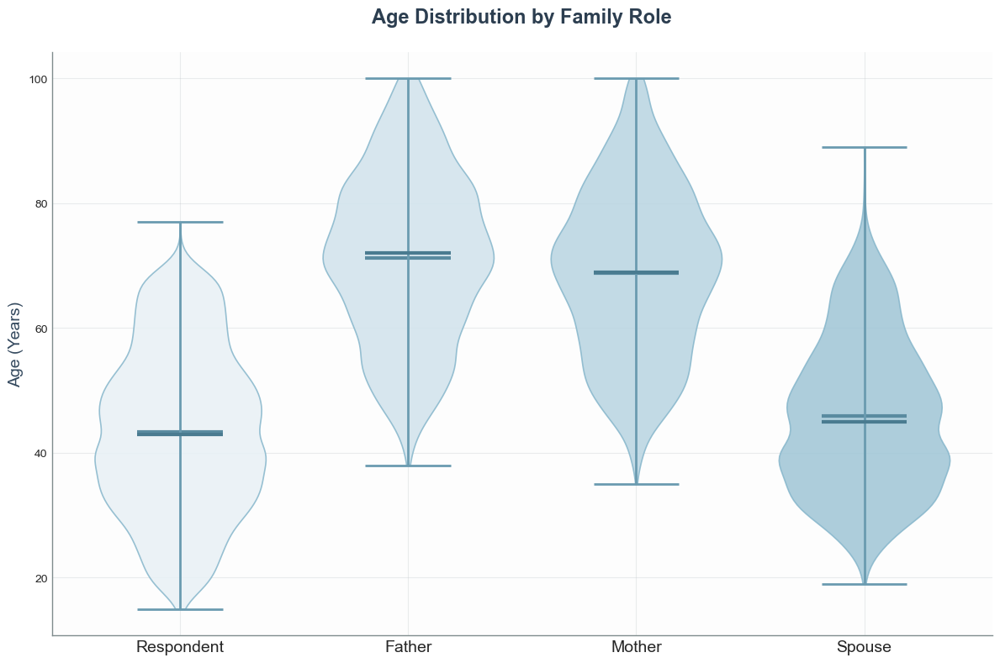

Age violin plot saved successfully!

2. Generating education violin plot (Morandi Green)...


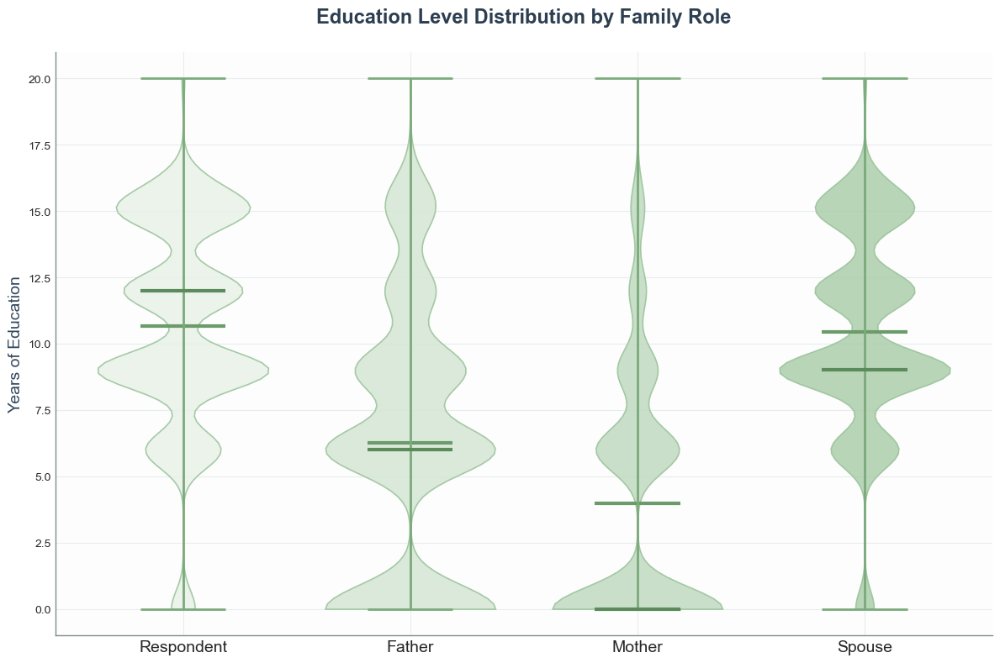

Education violin plot saved successfully!

3. Generating income violin plot (Morandi Orange)...


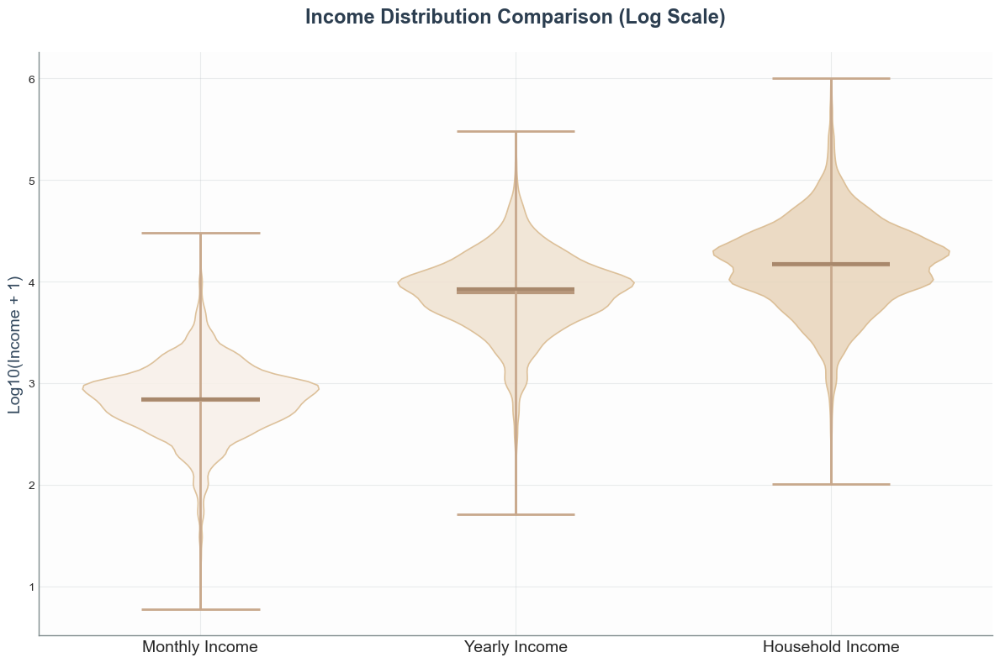

Income violin plot saved successfully!

4. Generating education heatmap (Morandi Purple)...


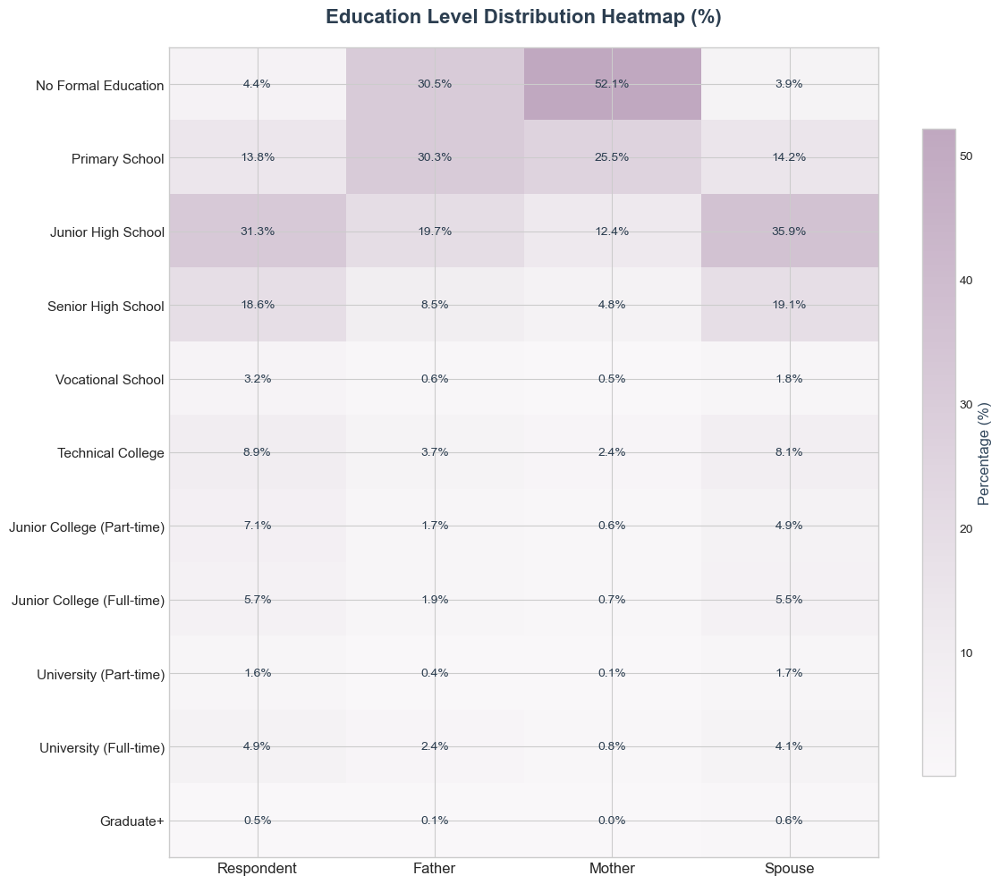

Education heatmap saved successfully!

5. Generating income density plots (Morandi Teal)...


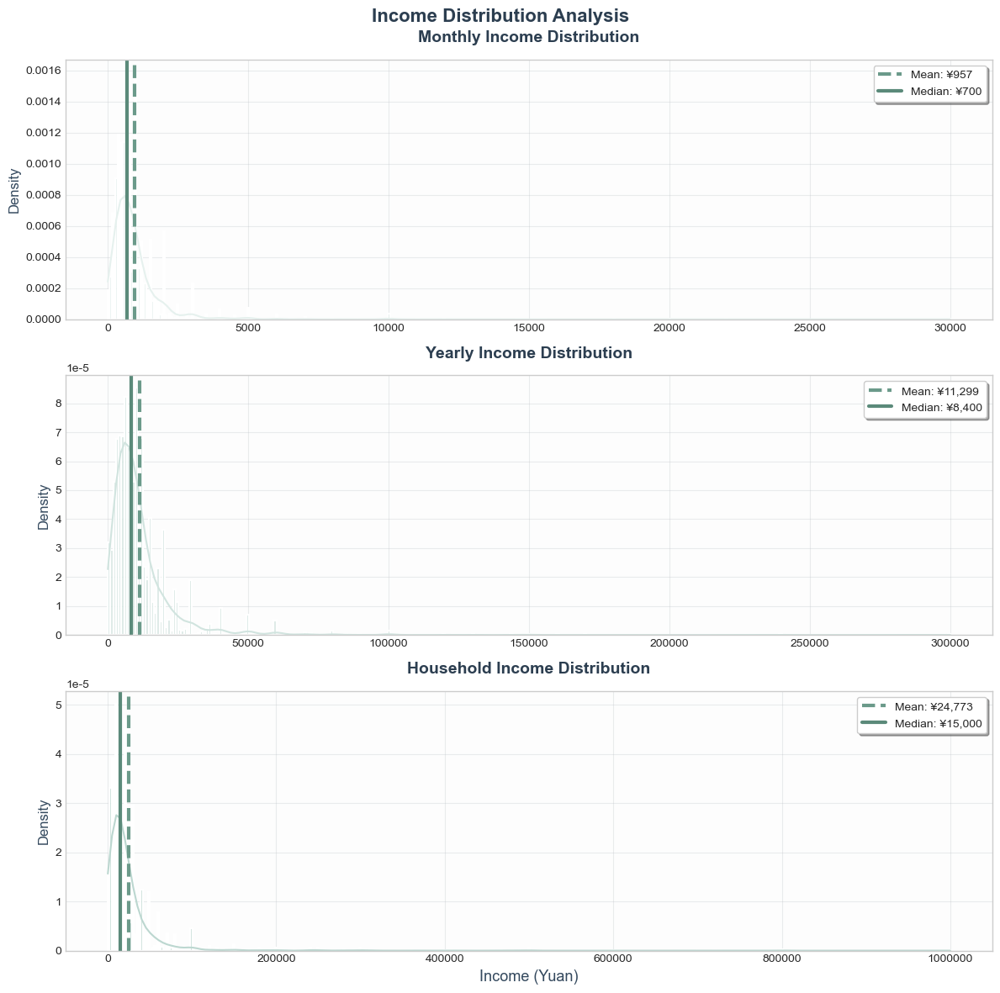

Income density plots saved successfully!

6. Generating education stacked bar chart (Morandi Pink)...


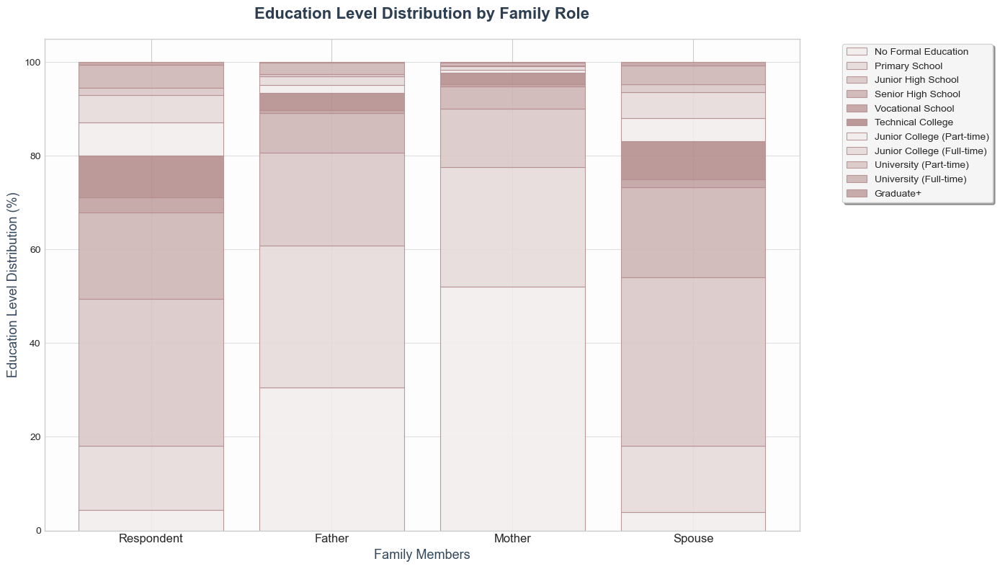

Education stacked bar chart saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files:
- age_distribution_violin.png (Morandi Blue)
- education_violin_plot.png (Morandi Green)
- income_violin_plot.png (Morandi Orange)
- education_heatmap.png (Morandi Purple)
- income_density_plots.png (Morandi Teal)
- education_stacked_bar.png (Morandi Pink)


In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - remove ages > 100 first
        current_year = 2003
        age_vars = {}
        
        # Respondent age
        if 'birth' in df.columns:
            df['age'] = current_year - df['birth']
            age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
            age_vars['Respondent'] = age_clean
        
        # Father age
        if 'f_birth' in df.columns:
            df['f_age'] = current_year - df['f_birth']
            f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
            age_vars['Father'] = f_age_clean
        
        # Mother age
        if 'm_birth' in df.columns:
            df['m_age'] = current_year - df['m_birth']
            m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
            age_vars['Mother'] = m_age_clean
        
        # Spouse age
        if 's_birth' in df.columns:
            df['s_age'] = current_year - df['s_birth']
            s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
            age_vars['Spouse'] = s_age_clean
        
        # Education processing with proper labels and data cleaning
        education_labels = {
            0: 'No Formal Education',    # 未受过正式教育
            1: 'Primary School',         # 小学
            2: 'Junior High School',     # 初中
            3: 'Senior High School',     # 高中
            4: 'Vocational School',      # 职高、技校
            5: 'Technical College',      # 中专
            6: 'Junior College (Part-time)', # 大专(非全日制)
            7: 'Junior College (Full-time)', # 大专(全日制)
            8: 'University (Part-time)',     # 本科(非全日制)
            9: 'University (Full-time)',     # 本科(全日制)
            10: 'Graduate+'              # 研究生以上
        }
        
        # Valid education codes (remove -3, -2, -1, 11, 12, 13)
        valid_educ_codes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
        
        educ_vars = {}
        if 'educ' in df.columns:
            educ_clean = df['educ'][df['educ'].isin(valid_educ_codes)]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean
        
        if 'f_educ' in df.columns:
            f_educ_clean = df['f_educ'][df['f_educ'].isin(valid_educ_codes)]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean
        
        if 'm_educ' in df.columns:
            m_educ_clean = df['m_educ'][df['m_educ'].isin(valid_educ_codes)]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean
        
        if 's_educ' in df.columns:
            s_educ_clean = df['s_educ'][df['s_educ'].isin(valid_educ_codes)]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean
        
        # Income processing - clean outliers
        income_vars = {}
        if 'incmonth' in df.columns:
            monthly_income = df['incmonth'][(df['incmonth'] > 0) & (df['incmonth'] < 50000)]
            if len(monthly_income) > 0:
                income_vars['Monthly Income'] = monthly_income
        
        if 'incyear' in df.columns:
            yearly_income = df['incyear'][(df['incyear'] > 0) & (df['incyear'] < 1000000)]
            if len(yearly_income) > 0:
                income_vars['Yearly Income'] = yearly_income
        
        if 'hhyrinc' in df.columns:
            household_income = df['hhyrinc'][(df['hhyrinc'] > 0) & (df['hhyrinc'] < 2000000)]
            if len(household_income) > 0:
                income_vars['Household Income'] = household_income
        
        return df, age_vars, educ_vars, income_vars, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_morandi_colormap(base_color, name):
    """
    Create Morandi style gradient colormap
    """
    if base_color == 'blue':
        colors = ['#F8FAFB', '#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6', '#86B6CB']
    elif base_color == 'green':
        colors = ['#F7F9F7', '#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC', '#98C298']
    elif base_color == 'orange':
        colors = ['#FDF9F6', '#F8F0E8', '#F0E2D1', '#E8D4BA', '#E0C6A3', '#D8B88C']
    elif base_color == 'purple':
        colors = ['#F9F7F9', '#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0']
    elif base_color == 'teal':
        colors = ['#F6F9F8', '#E6F1EE', '#D1E4DF', '#BCD7D0', '#A7CAC1', '#92BDB2']
    elif base_color == 'pink':
        colors = ['#FAF8F8', '#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5', '#C2A2A2']
    else:
        colors = ['#F8F8F8', '#E8E8E8', '#D8D8D8', '#C8C8C8', '#B8B8B8', '#A8A8A8']
    
    return LinearSegmentedColormap.from_list(name, colors, N=100)

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blue_cmap = create_morandi_colormap('blue', 'morandi_blue')
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role].dropna()) > 10:
            box_data.append(age_vars[role].dropna())
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8))
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - convert education codes to numeric scores for violin plot
    education_scores = {0: 0, 1: 6, 2: 9, 3: 12, 4: 12, 5: 15, 6: 15, 7: 15, 8: 16, 9: 16, 10: 20}
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8))
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_income_violin_plot(income_vars, output_path):
    """
    Create violin plot for income distribution - Morandi Orange
    """
    morandi_oranges = ['#F8F0E8', '#F0E2D1', '#E8D4BA', '#E0C6A3']
    
    # Prepare data - use log scale for better visualization
    box_data = []
    box_labels = []
    
    for income_type, data in income_vars.items():
        if len(data) > 10:
            # Use log transformation for better visualization
            log_data = np.log10(data + 1)
            box_data.append(log_data)
            box_labels.append(income_type)
    
    plt.figure(figsize=(12, 8))
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi orange gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_oranges)
            pc.set_facecolor(morandi_oranges[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#D8B88C')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#B8987C')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#A8886C')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#C8A88C')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Income Distribution Comparison (Log Scale)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Log10(Income + 1)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_violin_plot.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income violin plot saved successfully!")

def create_education_heatmap(educ_vars, education_labels, output_path):
    """
    Create heatmap for education levels - Morandi Purple
    """
    morandi_purple_cmap = create_morandi_colormap('purple', 'morandi_purple')
    
    # Prepare data matrix
    roles = list(educ_vars.keys())
    education_data = []
    educ_level_names = []
    
    # Get all unique education levels
    all_levels = set()
    for data in educ_vars.values():
        all_levels.update(data.unique())
    all_levels = sorted([x for x in all_levels if not pd.isna(x)])
    
    # Create matrix
    for level in all_levels:
        level_name = education_labels.get(level, f'Level {level}')
        educ_level_names.append(level_name)
        row_data = []
        for role in roles:
            count = sum(educ_vars[role] == level)
            total = len(educ_vars[role])
            percentage = (count / total * 100) if total > 0 else 0
            row_data.append(percentage)
        education_data.append(row_data)
    
    # Create heatmap
    plt.figure(figsize=(12, 10))
    education_matrix = np.array(education_data)
    
    im = plt.imshow(education_matrix, cmap=morandi_purple_cmap, aspect='auto')
    
    # Set ticks and labels
    plt.xticks(range(len(roles)), roles, fontsize=12)
    plt.yticks(range(len(educ_level_names)), educ_level_names, fontsize=11)
    plt.title('Education Level Distribution Heatmap (%)', fontsize=16, fontweight='bold', 
             pad=20, color='#2C3E50')
    
    # Add colorbar
    cbar = plt.colorbar(im, shrink=0.8)
    cbar.set_label('Percentage (%)', fontsize=12, color='#34495E')
    
    # Add text annotations
    for i in range(len(educ_level_names)):
        for j in range(len(roles)):
            text = plt.text(j, i, f'{education_matrix[i, j]:.1f}%',
                           ha="center", va="center", color='#2C3E50', fontsize=10)
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_heatmap.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education heatmap saved successfully!")

def create_income_density_plot(income_vars, output_path):
    """
    Create density plots for income - Morandi Teal
    """
    morandi_teals = ['#E6F1EE', '#D1E4DF', '#BCD7D0', '#A7CAC1']
    
    fig, axes = plt.subplots(len(income_vars), 1, figsize=(12, 4*len(income_vars)))
    
    if len(income_vars) == 1:
        axes = [axes]
    
    for i, (income_type, data) in enumerate(income_vars.items()):
        if len(data) > 10:
            # Use seaborn for smooth density plot
            sns.histplot(data, kde=True, stat='density', alpha=0.7, 
                        color=morandi_teals[i % len(morandi_teals)], ax=axes[i],
                        edgecolor='white', linewidth=1.5)
            
            # Add statistics
            mean_val = data.mean()
            median_val = data.median()
            
            axes[i].axvline(mean_val, color='#6B9A8A', linestyle='--', linewidth=3, 
                          label=f'Mean: ¥{mean_val:,.0f}')
            axes[i].axvline(median_val, color='#5B8A7A', linestyle='-', linewidth=3,
                          label=f'Median: ¥{median_val:,.0f}')
            
            axes[i].set_ylabel('Density', fontsize=12, color='#34495E')
            axes[i].set_title(f'{income_type} Distribution', 
                            fontsize=14, fontweight='bold', color='#2C3E50', pad=15)
            axes[i].legend(loc='upper right', frameon=True, fancybox=True, shadow=True)
            axes[i].grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
            axes[i].set_facecolor('#FDFDFD')
            
            # Format x-axis
            axes[i].ticklabel_format(style='plain', axis='x')
            axes[i].set_xlabel('')
    
    plt.xlabel('Income (Yuan)', fontsize=13, color='#34495E')
    plt.suptitle('Income Distribution Analysis', fontsize=16, fontweight='bold', 
                y=0.98, color='#2C3E50')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plots.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plots saved successfully!")

def create_education_stacked_bar(educ_vars, education_labels, output_path):
    """
    Create stacked bar chart for education - Morandi Pink
    """
    morandi_pink_cmap = create_morandi_colormap('pink', 'morandi_pink')
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5', '#C2A2A2', '#B68F8F']
    
    plt.figure(figsize=(14, 8))
    
    # Prepare data for stacked bar chart
    roles = list(educ_vars.keys())
    education_data = {}
    
    # Get all education levels present in data
    all_levels = set()
    for data in educ_vars.values():
        all_levels.update(data.unique())
    all_levels = sorted([x for x in all_levels if not pd.isna(x)])
    
    for role, data in educ_vars.items():
        # Count education levels
        educ_counts = data.value_counts()
        
        # Map to education level names and percentages
        total = len(data)
        for level_code in all_levels:
            level_name = education_labels.get(level_code, f'Level {level_code}')
            count = educ_counts.get(level_code, 0)
            percentage = (count / total * 100) if total > 0 else 0
            
            if level_name not in education_data:
                education_data[level_name] = {}
            education_data[level_name][role] = percentage
    
    # Convert to DataFrame
    education_df = pd.DataFrame(education_data).fillna(0)
    
    # Create stacked bar chart
    x_pos = np.arange(len(roles))
    bottom = np.zeros(len(roles))
    
    for i, (educ_level, values) in enumerate(education_df.items()):
        color_idx = i % len(morandi_pinks)
        color = morandi_pinks[color_idx]
        
        plt.bar(x_pos, values, bottom=bottom, label=educ_level, 
                color=color, alpha=0.9, edgecolor='#B68F8F', linewidth=0.8)
        bottom += values
    
    plt.xlabel('Family Members', fontsize=13, color='#34495E')
    plt.ylabel('Education Level Distribution (%)', fontsize=13, color='#34495E')
    plt.title('Education Level Distribution by Family Role', fontsize=16, fontweight='bold', 
             pad=20, color='#2C3E50')
    plt.xticks(x_pos, roles, fontsize=12)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', frameon=True, 
              fancybox=True, shadow=True, framealpha=0.9)
    
    plt.grid(True, alpha=0.25, axis='y', color='#7F8C8D')
    plt.gca().set_facecolor('#FDFDFD')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_stacked_bar.png', dpi=300, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education stacked bar chart saved successfully!")

def main():
    """
    Main function
    """
    # File path
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\1.CGSS2003.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2003 data...")
    print("Data cleaning: Removing age > 100, invalid education codes (-3,-2,-1,11,12,13)")
    
    # Load data
    df, age_vars, educ_vars, income_vars, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nData summary after cleaning:")
    print(f"Age variables: {list(age_vars.keys())} (samples > 100 years removed)")
    print(f"Education variables: {list(educ_vars.keys())} (invalid codes removed)")
    print(f"Income variables: {list(income_vars.keys())}")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating income violin plot (Morandi Orange)...")
    create_income_violin_plot(income_vars, output_path)
    
    print("\n4. Generating education heatmap (Morandi Purple)...")
    create_education_heatmap(educ_vars, education_labels, output_path)
    
    print("\n5. Generating income density plots (Morandi Teal)...")
    create_income_density_plot(income_vars, output_path)
    
    print("\n6. Generating education stacked bar chart (Morandi Pink)...")
    create_education_stacked_bar(educ_vars, education_labels, output_path)
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files:")
    print("- age_distribution_violin.png (Morandi Blue)")
    print("- education_violin_plot.png (Morandi Green)")
    print("- income_violin_plot.png (Morandi Orange)")
    print("- education_heatmap.png (Morandi Purple)")
    print("- income_density_plots.png (Morandi Teal)")
    print("- education_stacked_bar.png (Morandi Pink)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2003 data...
Data cleaning: Removing age > 100, invalid education codes (-3,-2,-1,11,12,13)
Data loaded successfully, shape: (5894, 898)

Data summary after cleaning:
Age variables: ['Respondent', 'Father', 'Mother', 'Spouse'] (samples > 100 years removed)
Education variables: ['Respondent', 'Father', 'Mother', 'Spouse'] (invalid codes removed)
Income variables: ['Monthly Income', 'Yearly Income', 'Household Income']

1. Generating age distribution violin plot (Morandi Blue)...


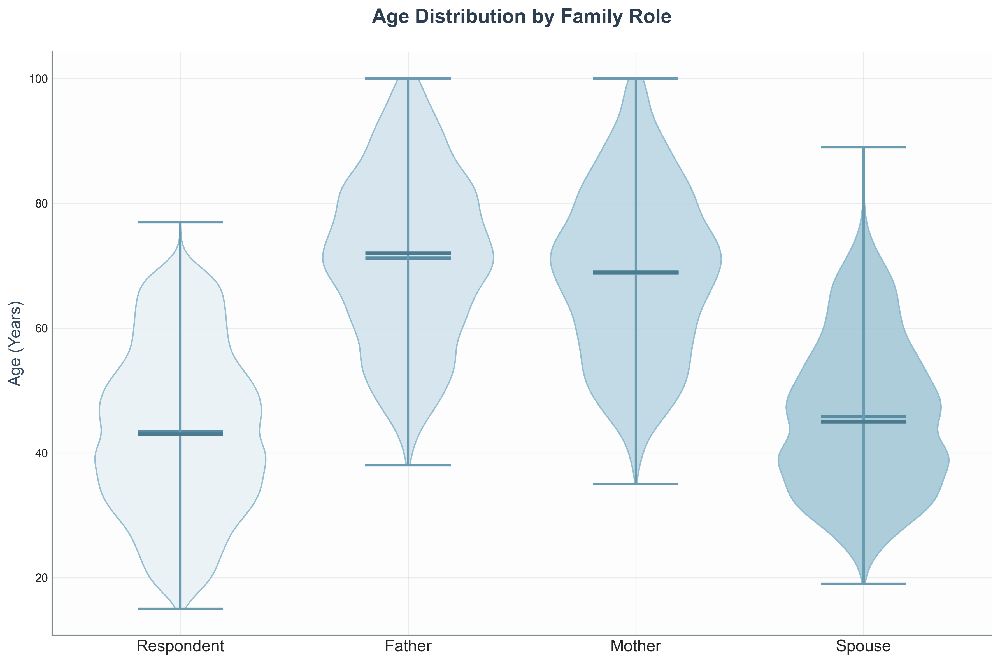

Age violin plot saved successfully!

2. Generating education violin plot (Morandi Green)...


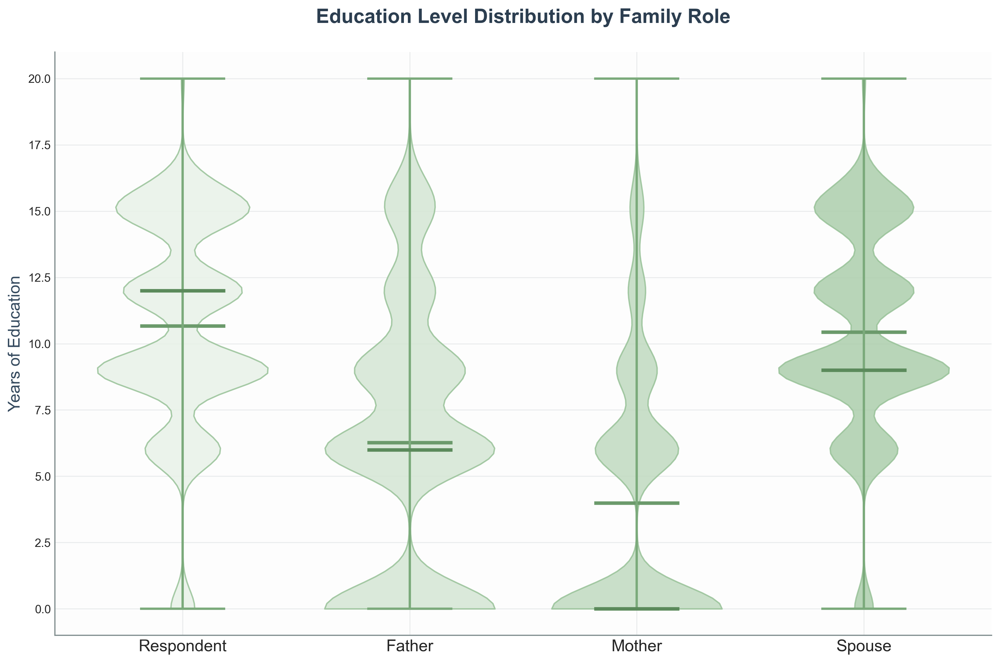

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


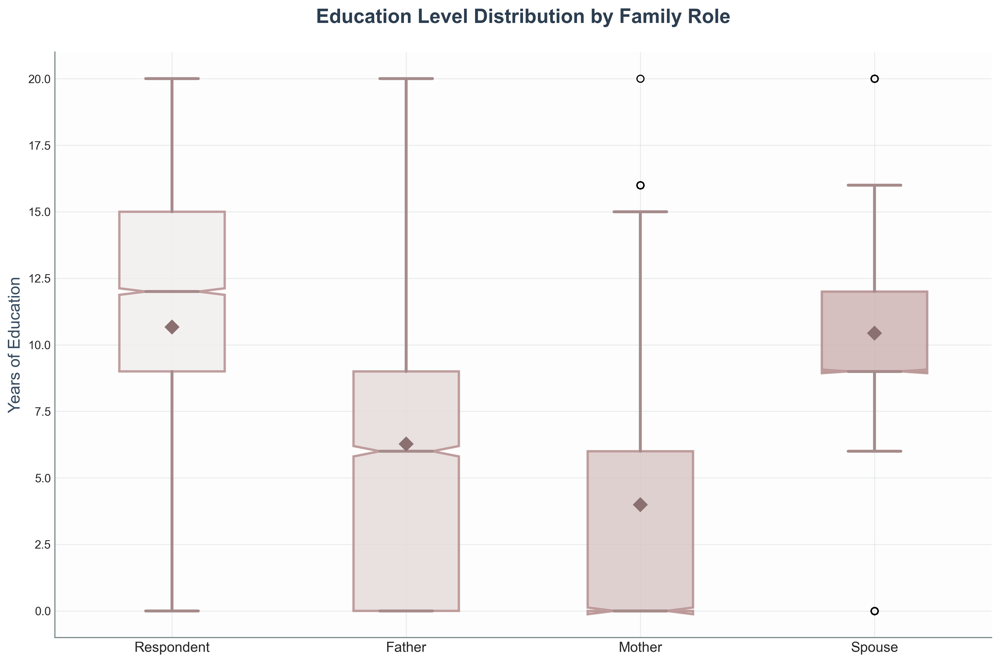

Education box plot saved successfully!

4. Generating income violin plot (Morandi Orange)...


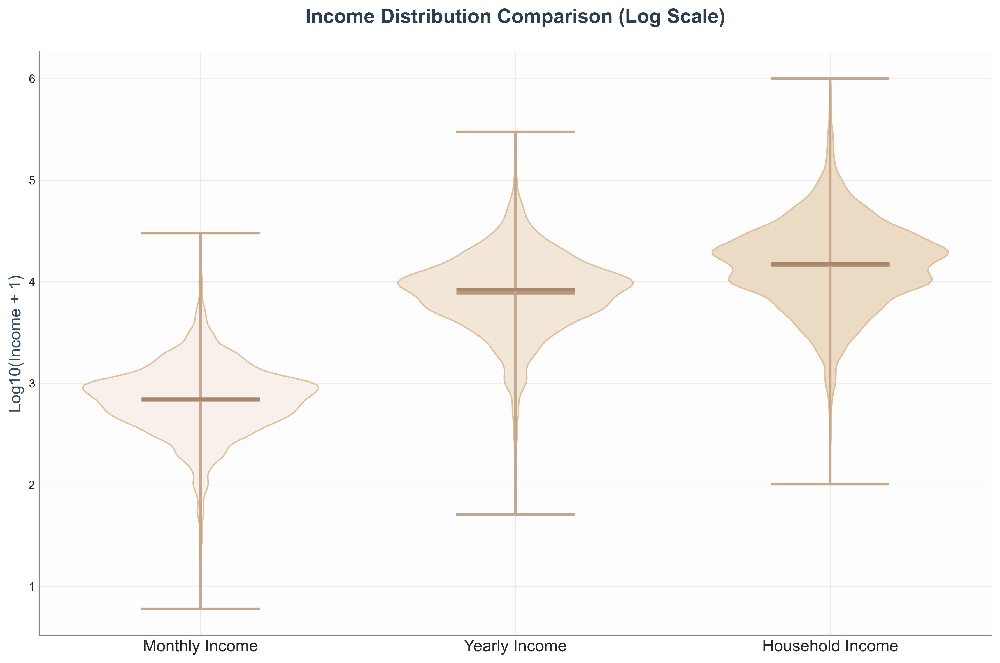

Income violin plot saved successfully!

5. Generating income box plot (Morandi Purple)...


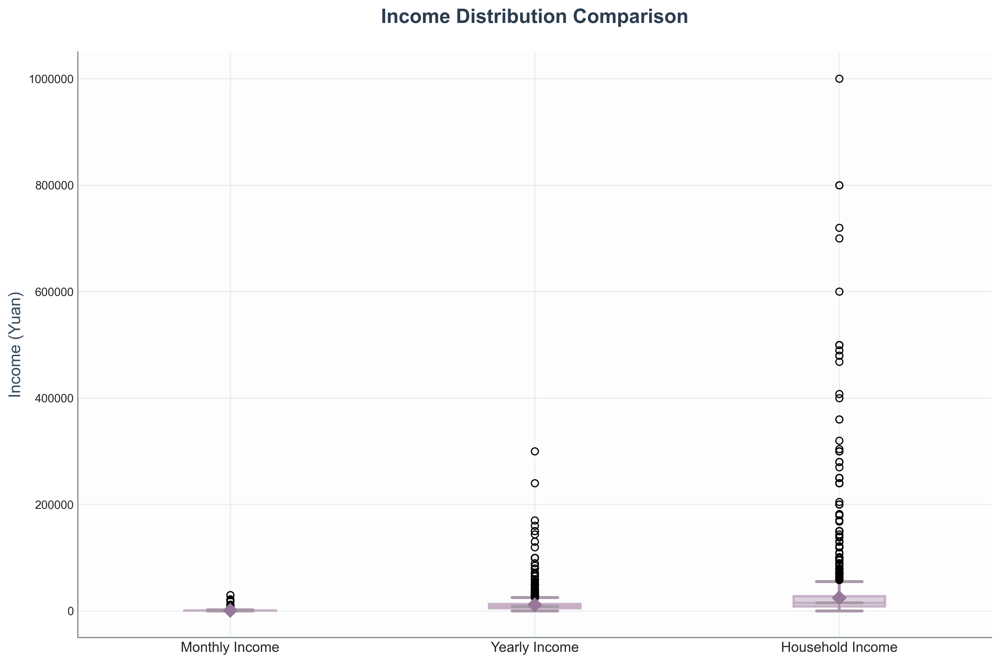

Income box plot saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files:
- age_distribution_violin.png (Morandi Blue)
- education_violin_plot.png (Morandi Green)
- education_box_plot.png (Morandi Pink)
- income_violin_plot.png (Morandi Orange)
- income_box_plot.png (Morandi Purple)


In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - remove ages > 100 first
        current_year = 2003
        age_vars = {}
        
        # Respondent age
        if 'birth' in df.columns:
            df['age'] = current_year - df['birth']
            age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
            age_vars['Respondent'] = age_clean
        
        # Father age
        if 'f_birth' in df.columns:
            df['f_age'] = current_year - df['f_birth']
            f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
            age_vars['Father'] = f_age_clean
        
        # Mother age
        if 'm_birth' in df.columns:
            df['m_age'] = current_year - df['m_birth']
            m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
            age_vars['Mother'] = m_age_clean
        
        # Spouse age
        if 's_birth' in df.columns:
            df['s_age'] = current_year - df['s_birth']
            s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
            age_vars['Spouse'] = s_age_clean
        
        # Education processing with proper labels and data cleaning
        education_labels = {
            0: 'No Formal Education',    # 未受过正式教育
            1: 'Primary School',         # 小学
            2: 'Junior High School',     # 初中
            3: 'Senior High School',     # 高中
            4: 'Vocational School',      # 职高、技校
            5: 'Technical College',      # 中专
            6: 'Junior College (Part-time)', # 大专(非全日制)
            7: 'Junior College (Full-time)', # 大专(全日制)
            8: 'University (Part-time)',     # 本科(非全日制)
            9: 'University (Full-time)',     # 本科(全日制)
            10: 'Graduate+'              # 研究生以上
        }
        
        # Valid education codes (remove -3, -2, -1, 11, 12, 13)
        valid_educ_codes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
        
        educ_vars = {}
        if 'educ' in df.columns:
            educ_clean = df['educ'][df['educ'].isin(valid_educ_codes)]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean
        
        if 'f_educ' in df.columns:
            f_educ_clean = df['f_educ'][df['f_educ'].isin(valid_educ_codes)]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean
        
        if 'm_educ' in df.columns:
            m_educ_clean = df['m_educ'][df['m_educ'].isin(valid_educ_codes)]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean
        
        if 's_educ' in df.columns:
            s_educ_clean = df['s_educ'][df['s_educ'].isin(valid_educ_codes)]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean
        
        # Income processing - clean outliers
        income_vars = {}
        if 'incmonth' in df.columns:
            monthly_income = df['incmonth'][(df['incmonth'] > 0) & (df['incmonth'] < 50000)]
            if len(monthly_income) > 0:
                income_vars['Monthly Income'] = monthly_income
        
        if 'incyear' in df.columns:
            yearly_income = df['incyear'][(df['incyear'] > 0) & (df['incyear'] < 1000000)]
            if len(yearly_income) > 0:
                income_vars['Yearly Income'] = yearly_income
        
        if 'hhyrinc' in df.columns:
            household_income = df['hhyrinc'][(df['hhyrinc'] > 0) & (df['hhyrinc'] < 2000000)]
            if len(household_income) > 0:
                income_vars['Household Income'] = household_income
        
        return df, age_vars, educ_vars, income_vars, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role].dropna()) > 10:
            box_data.append(age_vars[role].dropna())
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - convert education codes to numeric scores for violin plot
    education_scores = {0: 0, 1: 6, 2: 9, 3: 12, 4: 12, 5: 15, 6: 15, 7: 15, 8: 16, 9: 16, 10: 20}
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {0: 0, 1: 6, 2: 9, 3: 12, 4: 12, 5: 15, 6: 15, 7: 15, 8: 16, 9: 16, 10: 20}
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_violin_plot(income_vars, output_path):
    """
    Create violin plot for income distribution - Morandi Orange
    """
    morandi_oranges = ['#F8F0E8', '#F0E2D1', '#E8D4BA', '#E0C6A3']
    
    # Prepare data - use log scale for better visualization
    box_data = []
    box_labels = []
    
    for income_type, data in income_vars.items():
        if len(data) > 10:
            # Use log transformation for better visualization
            log_data = np.log10(data + 1)
            box_data.append(log_data)
            box_labels.append(income_type)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi orange gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_oranges)
            pc.set_facecolor(morandi_oranges[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#D8B88C')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#B8987C')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#A8886C')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#C8A88C')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Income Distribution Comparison (Log Scale)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Log10(Income + 1)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_violin_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income violin plot saved successfully!")

def create_income_box_plot(income_vars, output_path):
    """
    Create box plot for income distribution - Morandi Purple
    """
    morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC']
    
    # Prepare data for box plot
    plot_data = []
    plot_labels = []
    
    for income_type, data in income_vars.items():
        if len(data) > 10:
            plot_data.append(data)
            plot_labels.append(income_type)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(plot_data) > 0:
        bp = plt.boxplot(plot_data, labels=plot_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi purple colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_purples[i % len(morandi_purples)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#C0A8C0')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A898A8', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#987898', 
                markeredgecolor='#987898', markersize=8)
        
        plt.title('Income Distribution Comparison', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Income (Yuan)', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format y-axis
        plt.ticklabel_format(style='plain', axis='y')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_box_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income box plot saved successfully!")

def main():
    """
    Main function
    """
    # File path
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\1.CGSS2003.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2003 data...")
    print("Data cleaning: Removing age > 100, invalid education codes (-3,-2,-1,11,12,13)")
    
    # Load data
    df, age_vars, educ_vars, income_vars, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nData summary after cleaning:")
    print(f"Age variables: {list(age_vars.keys())} (samples > 100 years removed)")
    print(f"Education variables: {list(educ_vars.keys())} (invalid codes removed)")
    print(f"Income variables: {list(income_vars.keys())}")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    print("\n4. Generating income violin plot (Morandi Orange)...")
    create_income_violin_plot(income_vars, output_path)
    
    print("\n5. Generating income box plot (Morandi Purple)...")
    create_income_box_plot(income_vars, output_path)
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files:")
    print("- age_distribution_violin.png (Morandi Blue)")
    print("- education_violin_plot.png (Morandi Green)")
    print("- education_box_plot.png (Morandi Pink)")
    print("- income_violin_plot.png (Morandi Orange)")
    print("- income_box_plot.png (Morandi Purple)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2003 data...
Data cleaning: Removing age > 100, invalid education codes (-3,-2,-1,11,12,13)
Data loaded successfully, shape: (5894, 898)

Data summary after cleaning:
Age variables: ['Respondent', 'Father', 'Mother', 'Spouse'] (samples > 100 years removed)
Education variables: ['Respondent', 'Father', 'Mother', 'Spouse'] (invalid codes removed)
Yearly income: 4491 valid samples

1. Generating age distribution violin plot (Morandi Blue)...


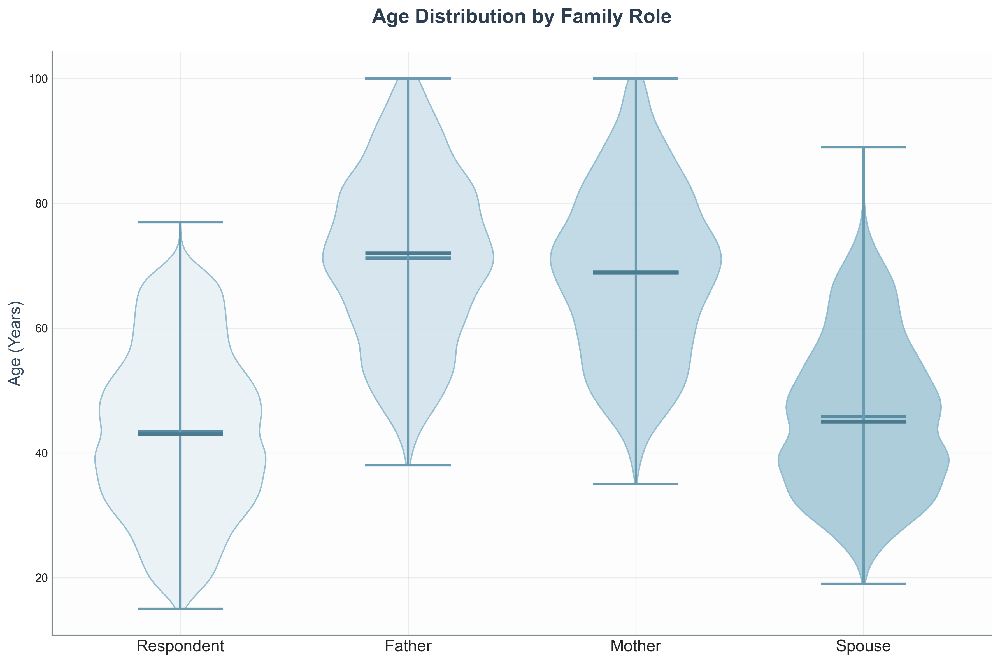

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


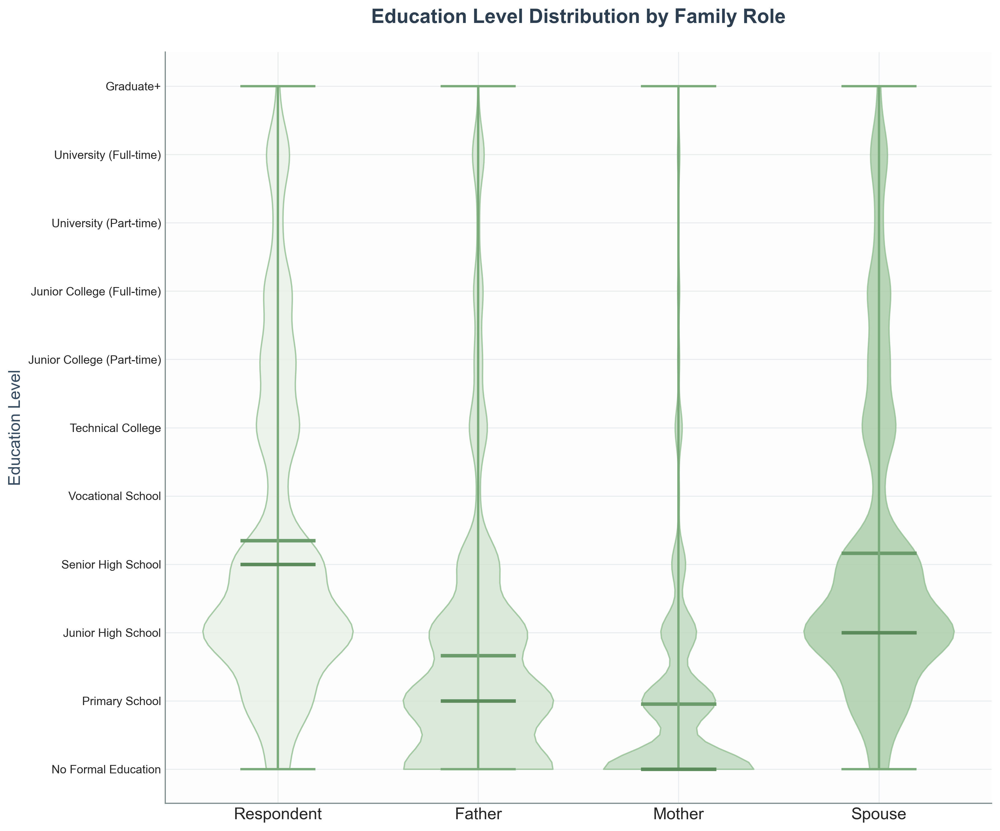

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


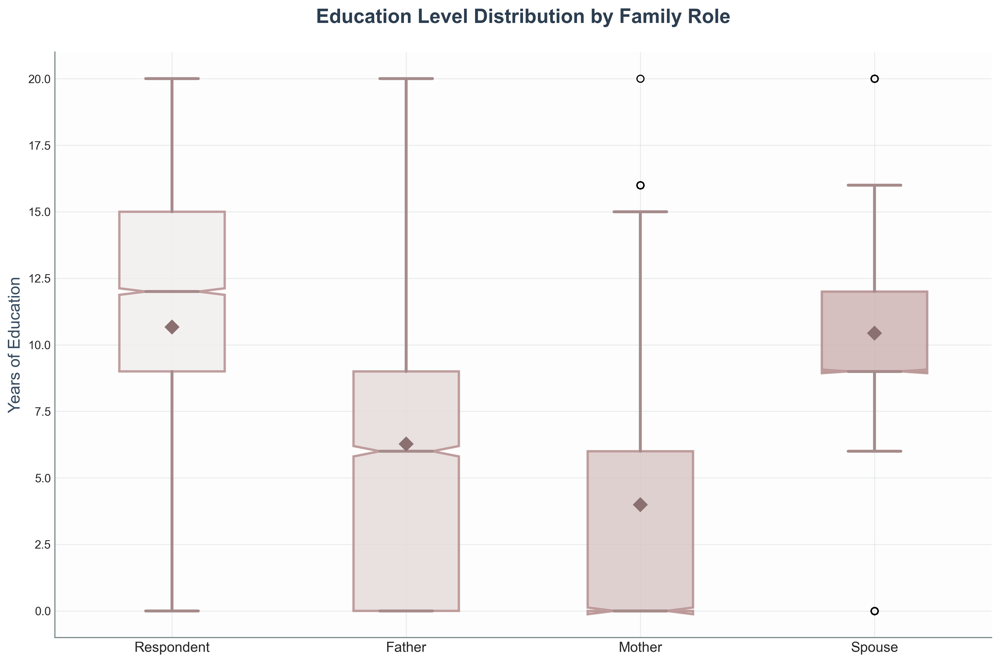

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


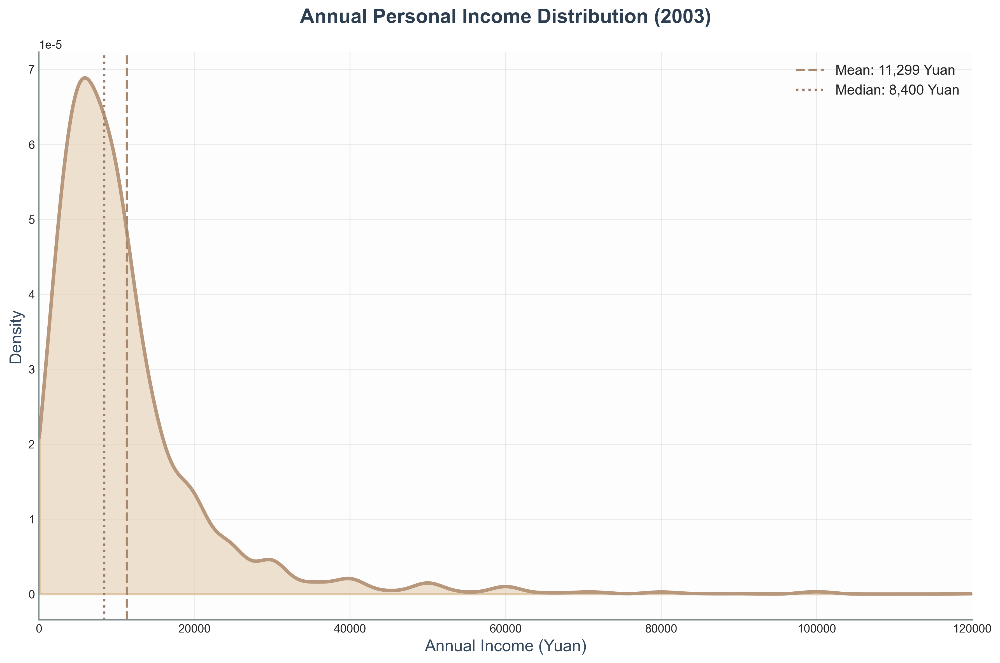

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


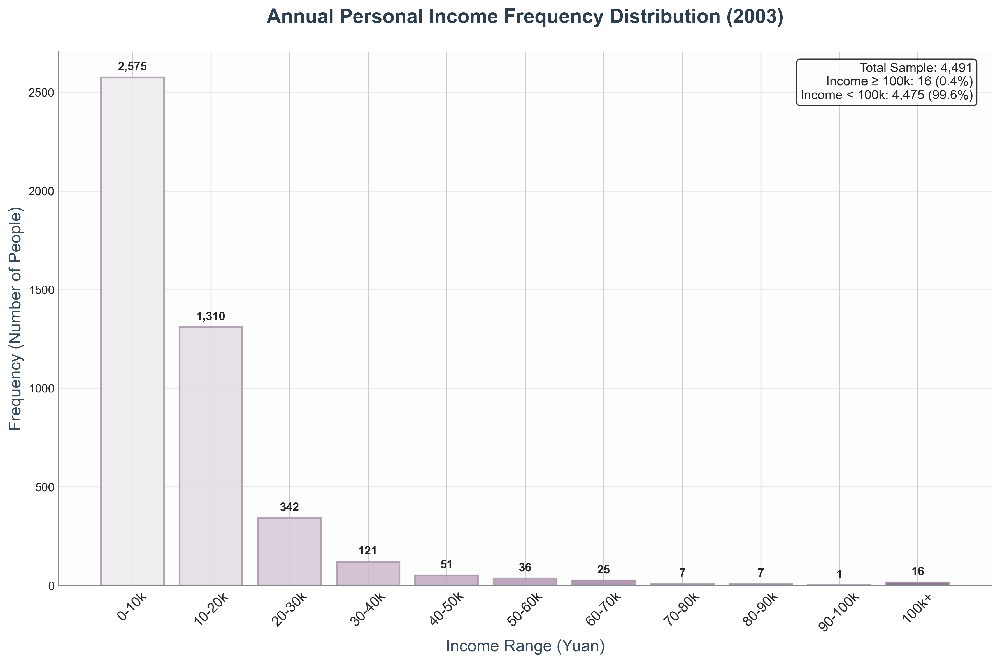

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files:
- age_distribution_violin.png (Morandi Blue)
- education_violin_plot.png (Morandi Green, with actual education labels)
- education_box_plot.png (Morandi Pink)
- income_density_plot.png (Morandi Orange, yearly income ≤120k)
- income_histogram.png (Morandi Purple, frequency distribution with 100k+ group)


In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - remove ages > 100 first
        current_year = 2003
        age_vars = {}
        
        # Respondent age
        if 'birth' in df.columns:
            df['age'] = current_year - df['birth']
            age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
            age_vars['Respondent'] = age_clean
        
        # Father age
        if 'f_birth' in df.columns:
            df['f_age'] = current_year - df['f_birth']
            f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
            age_vars['Father'] = f_age_clean
        
        # Mother age
        if 'm_birth' in df.columns:
            df['m_age'] = current_year - df['m_birth']
            m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
            age_vars['Mother'] = m_age_clean
        
        # Spouse age
        if 's_birth' in df.columns:
            df['s_age'] = current_year - df['s_birth']
            s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
            age_vars['Spouse'] = s_age_clean
        
        # Education processing with proper labels and data cleaning
        education_labels = {
            0: 'No Formal Education',    # 未受过正式教育
            1: 'Primary School',         # 小学
            2: 'Junior High School',     # 初中
            3: 'Senior High School',     # 高中
            4: 'Vocational School',      # 职高、技校
            5: 'Technical College',      # 中专
            6: 'Junior College (Part-time)', # 大专(非全日制)
            7: 'Junior College (Full-time)', # 大专(全日制)
            8: 'University (Part-time)',     # 本科(非全日制)
            9: 'University (Full-time)',     # 本科(全日制)
            10: 'Graduate+'              # 研究生以上
        }
        
        # Valid education codes (remove -3, -2, -1, 11, 12, 13)
        valid_educ_codes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
        
        educ_vars = {}
        if 'educ' in df.columns:
            educ_clean = df['educ'][df['educ'].isin(valid_educ_codes)]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean
        
        if 'f_educ' in df.columns:
            f_educ_clean = df['f_educ'][df['f_educ'].isin(valid_educ_codes)]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean
        
        if 'm_educ' in df.columns:
            m_educ_clean = df['m_educ'][df['m_educ'].isin(valid_educ_codes)]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean
        
        if 's_educ' in df.columns:
            s_educ_clean = df['s_educ'][df['s_educ'].isin(valid_educ_codes)]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean
        
        # Income processing - only yearly income
        yearly_income = None
        if 'incyear' in df.columns:
            yearly_income = df['incyear'][(df['incyear'] > 0) & (df['incyear'] < 1000000)]
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role].dropna()) > 10:
            box_data.append(age_vars[role].dropna())
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data.dropna())
            box_labels.append(role)
    
    plt.figure(figsize=(12, 10), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings
        education_ticks = list(range(0, 11))
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=10, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {0: 0, 1: 6, 2: 9, 3: 12, 4: 12, 5: 15, 6: 15, 7: 15, 8: 16, 9: 16, 10: 20}
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 120,000
        display_income = yearly_income[yearly_income <= 120000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 120000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        std_income = yearly_income.std()
        above_120k = len(yearly_income[yearly_income > 120000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 120000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 120000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2003)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 120000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 100k+ as the last group
        bins = [0, 10000, 20000, 30000, 40000, 50000, 60000, 70000, 80000, 90000, 100000, float('inf')]
        bin_labels = ['0-10k', '10-20k', '20-30k', '30-40k', '40-50k', '50-60k', 
                     '60-70k', '70-80k', '80-90k', '90-100k', '100k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 100k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 100k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2003)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_100k = counts[-1]
        above_100k_pct = (above_100k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 100k: {above_100k:,} ({above_100k_pct:.1f}%)\n'
        stats_text += f'Income < 100k: {total_sample - above_100k:,} ({100-above_100k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function
    """
    # File path
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\1.CGSS2003.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2003 data...")
    print("Data cleaning: Removing age > 100, invalid education codes (-3,-2,-1,11,12,13)")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nData summary after cleaning:")
    print(f"Age variables: {list(age_vars.keys())} (samples > 100 years removed)")
    print(f"Education variables: {list(educ_vars.keys())} (invalid codes removed)")
    if yearly_income is not None:
        print(f"Yearly income: {len(yearly_income)} valid samples")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    print("\n4. Generating yearly income density plot (Morandi Orange)...")
    create_income_density_plot(yearly_income, output_path)
    
    print("\n5. Generating yearly income histogram (Morandi Purple)...")
    create_income_histogram(yearly_income, output_path)
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files:")
    print("- age_distribution_violin.png (Morandi Blue)")
    print("- education_violin_plot.png (Morandi Green, with actual education labels)")
    print("- education_box_plot.png (Morandi Pink)")
    print("- income_density_plot.png (Morandi Orange, yearly income ≤120k)")
    print("- income_histogram.png (Morandi Purple, frequency distribution with 100k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2006 data...
Data cleaning: Removing age > 100, invalid education codes, income refusals/unknowns
Data loaded successfully, shape: (10151, 1311)

CGSS2006 Data summary after cleaning:
  Respondent age: 10151 valid samples
  Father age: 6280 valid samples
  Mother age: 6192 valid samples
  Spouse age: 601 valid samples
  Respondent education: 10151 valid samples
  Father education: 7133 valid samples
  Mother education: 6921 valid samples
  Spouse education: 614 valid samples
  Yearly income (2005): 8219 valid samples
  Income range: 20 - 670,000 Yuan
  Mean income: 10,160 Yuan
  Median income: 6,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


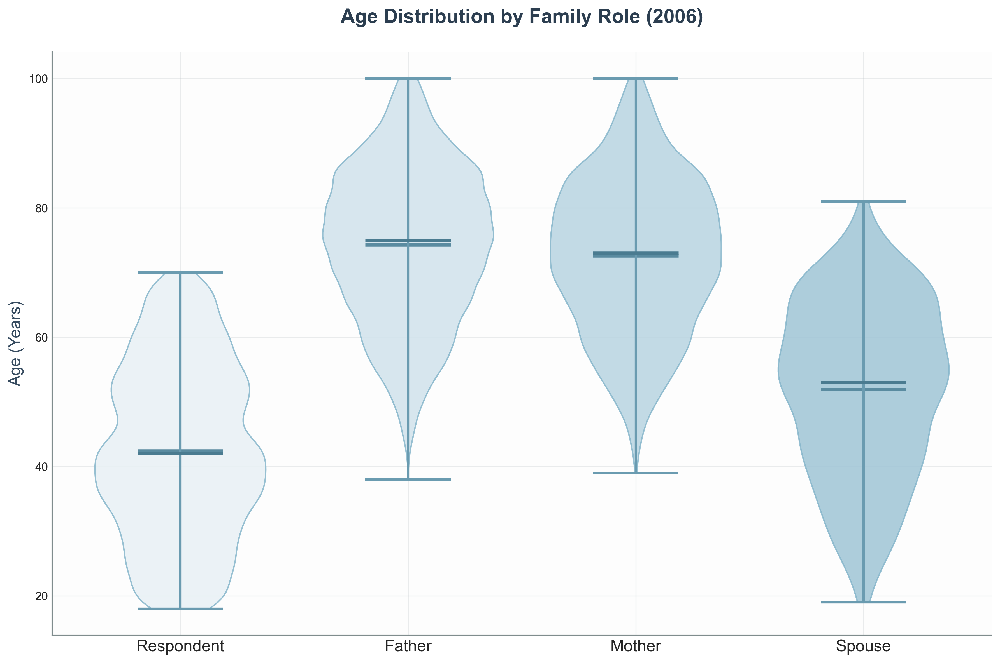

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


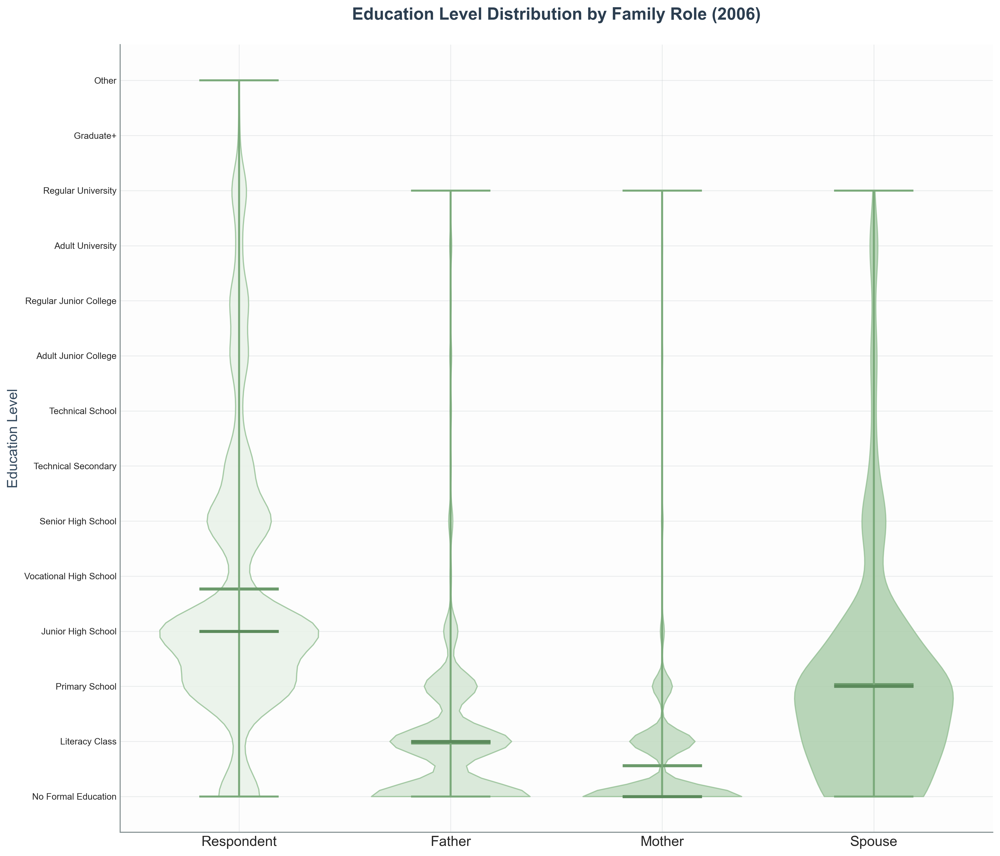

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


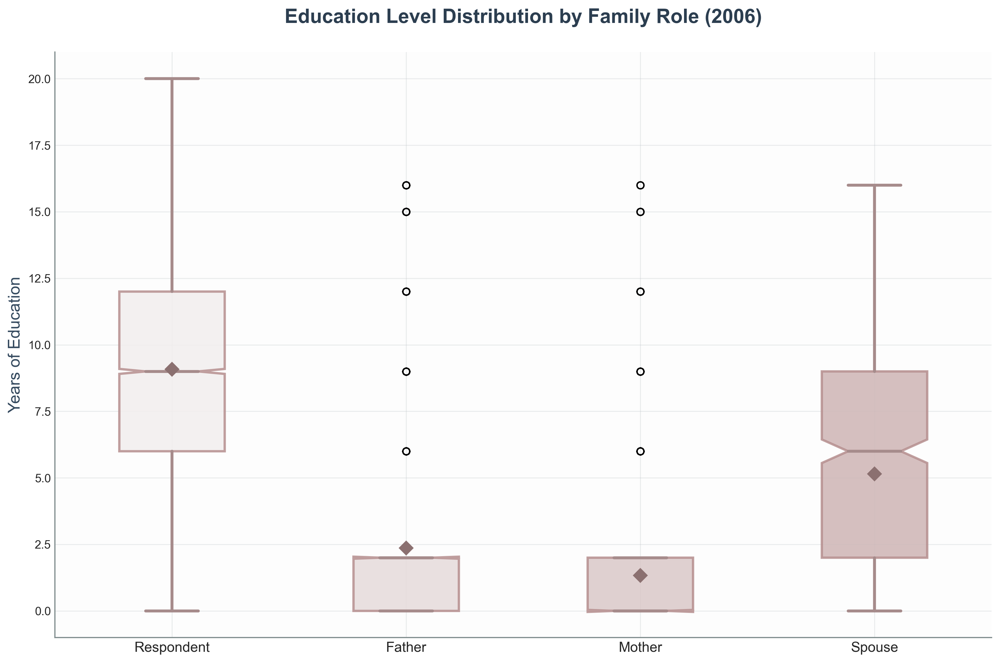

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


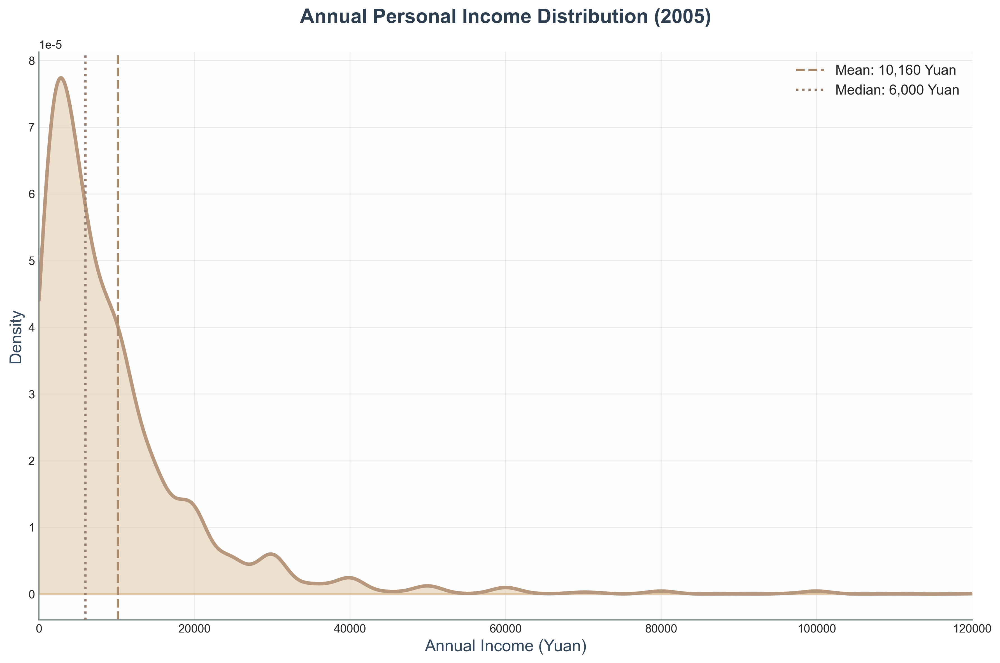

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


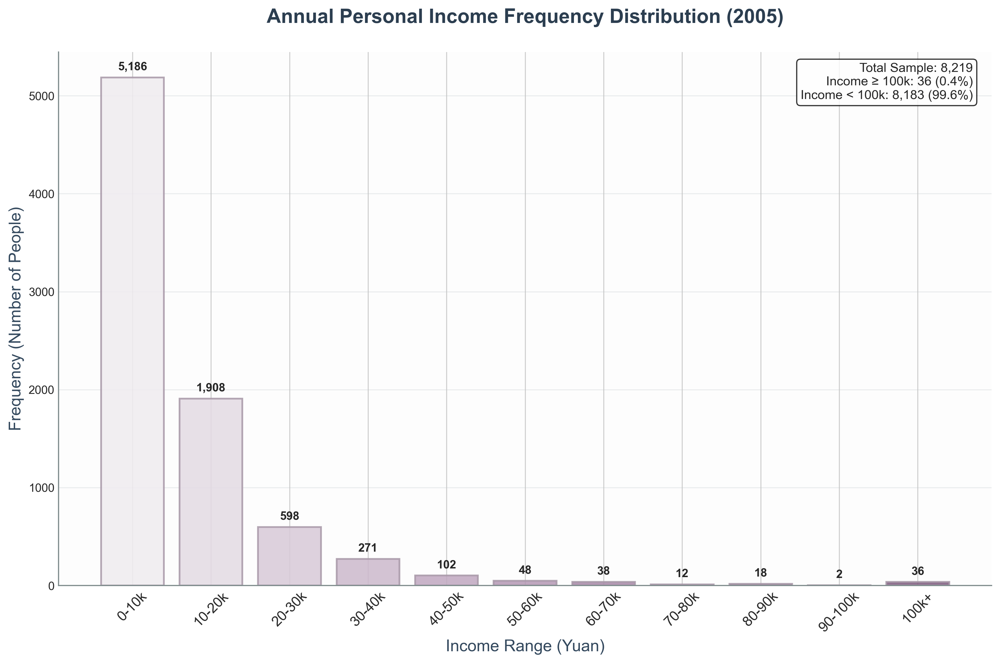

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2006:
- age_distribution_violin_2006.png (Morandi Blue)
- education_violin_plot_2006.png (Morandi Green, with actual education labels)
- education_box_plot_2006.png (Morandi Pink)
- income_density_plot_2006.png (Morandi Orange, 2005 income ≤120k)
- income_histogram_2006.png (Morandi Purple, frequency distribution with 100k+ group)


In [24]:
 #  - 2006年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2006 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2006年调查
        current_year = 2006
        age_vars = {}
        
        # Respondent age (from qa02 - 出生年月)
        if 'qa02' in df.columns:
            # Convert date to birth year, then calculate age
            df['birth_year'] = pd.to_datetime(df['qa02'], errors='coerce').dt.year
            df['age'] = current_year - df['birth_year']
            age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
            age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from qd10c31 - 父亲出生年)
        if 'qd10c31' in df.columns:
            # Remove missing values (coded as .)
            valid_father_birth = df['qd10c31'][(df['qd10c31'] > 1900) & (df['qd10c31'] < 2000)]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from qd10c32 - 母亲出生年)
        if 'qd10c32' in df.columns:
            # Remove missing values (coded as .)
            valid_mother_birth = df['qd10c32'][(df['qd10c32'] > 1900) & (df['qd10c32'] < 2000)]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from qd10c33 - 配偶出生年)
        if 'qd10c33' in df.columns:
            # Remove missing values (coded as .)
            valid_spouse_birth = df['qd10c33'][(df['qd10c33'] > 1900) & (df['qd10c33'] < 2000)]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2006年教育变量，基于实际数据编码1-14
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Literacy Class',             # 扫盲班
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+',                 # 研究生及以上
            14: 'Other'                      # 其他
        }
        
        # Valid education codes (1-14, excluding missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]
        
        educ_vars = {}
        # Respondent education (from qa05a - 最高教育程度)
        if 'qa05a' in df.columns:
            educ_clean = df['qa05a'][df['qa05a'].isin(valid_educ_codes)]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from qd10e31 - 父亲教育程度)
        if 'qd10e31' in df.columns:
            # Remove 98 (不知道), 99 (拒绝回答), and missing values
            f_educ_clean = df['qd10e31'][(df['qd10e31'].isin(valid_educ_codes))]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from qd10e32 - 母亲教育程度)  
        if 'qd10e32' in df.columns:
            # Remove 98 (不知道), 99 (拒绝回答), and missing values
            m_educ_clean = df['qd10e32'][(df['qd10e32'].isin(valid_educ_codes))]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from qd10e33 - 配偶教育程度)
        if 'qd10e33' in df.columns:
            # Remove 98 (不知道), 99 (拒绝回答), and missing values
            s_educ_clean = df['qd10e33'][(df['qd10e33'].isin(valid_educ_codes))]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用qd35a (个人2005年总收入)
        yearly_income = None
        if 'qd35a' in df.columns:
            # Remove 0 (没有), 9999997 (不适用), 9999998 (不知道/不清楚), 9999999 (拒绝回答)
            # Keep only positive numeric income values
            income_clean = df['qd35a'][(df['qd35a'] > 0) & 
                                      (df['qd35a'] < 9999990) & 
                                      (df['qd35a'] < 2000000)]  # Remove extreme outliers
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2006)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2006.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2006)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings
        education_ticks = list(range(1, 15))  # 2006年教育编码从1到14
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2006.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Literacy Class
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20, # Graduate+
        14: 12  # Other
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2006)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2006.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 120,000
        display_income = yearly_income[yearly_income <= 120000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 120000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_120k = len(yearly_income[yearly_income > 120000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 120000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 120000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2005)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 120000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2006.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 100k+ as the last group
        bins = [0, 10000, 20000, 30000, 40000, 50000, 60000, 70000, 80000, 90000, 100000, float('inf')]
        bin_labels = ['0-10k', '10-20k', '20-30k', '30-40k', '40-50k', '50-60k', 
                     '60-70k', '70-80k', '80-90k', '90-100k', '100k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 100k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 100k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2005)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_100k = counts[-1]
        above_100k_pct = (above_100k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 100k: {above_100k:,} ({above_100k_pct:.1f}%)\n'
        stats_text += f'Income < 100k: {total_sample - above_100k:,} ({100-above_100k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2006.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2006 data visualization
    """
    # File path - 2006年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\2.CGSS2006.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2006 data...")
    print("Data cleaning: Removing age > 100, invalid education codes, income refusals/unknowns")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2006 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2005): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2006:")
    print("- age_distribution_violin_2006.png (Morandi Blue)")
    print("- education_violin_plot_2006.png (Morandi Green, with actual education labels)")
    print("- education_box_plot_2006.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2006.png (Morandi Orange, 2005 income ≤120k)")
        print("- income_histogram_2006.png (Morandi Purple, frequency distribution with 100k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2008 data...
Data cleaning: Removing age > 100, invalid education codes (including '其他'), income refusals/unknowns, and codes like 9998/9999
Data loaded successfully, shape: (6000, 1504)

CGSS2008 Data summary after cleaning:
  Respondent age: 6000 valid samples
  Father age: 5557 valid samples
  Mother age: 5698 valid samples
  Spouse age: 4999 valid samples
  Respondent education: 5988 valid samples
  Father education: 5918 valid samples
  Mother education: 5962 valid samples
  Spouse education: 4990 valid samples
  Yearly income (2007): 4754 valid samples
  Income range: 100 - 1,000,000 Yuan
  Mean income: 15,150 Yuan
  Median income: 10,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


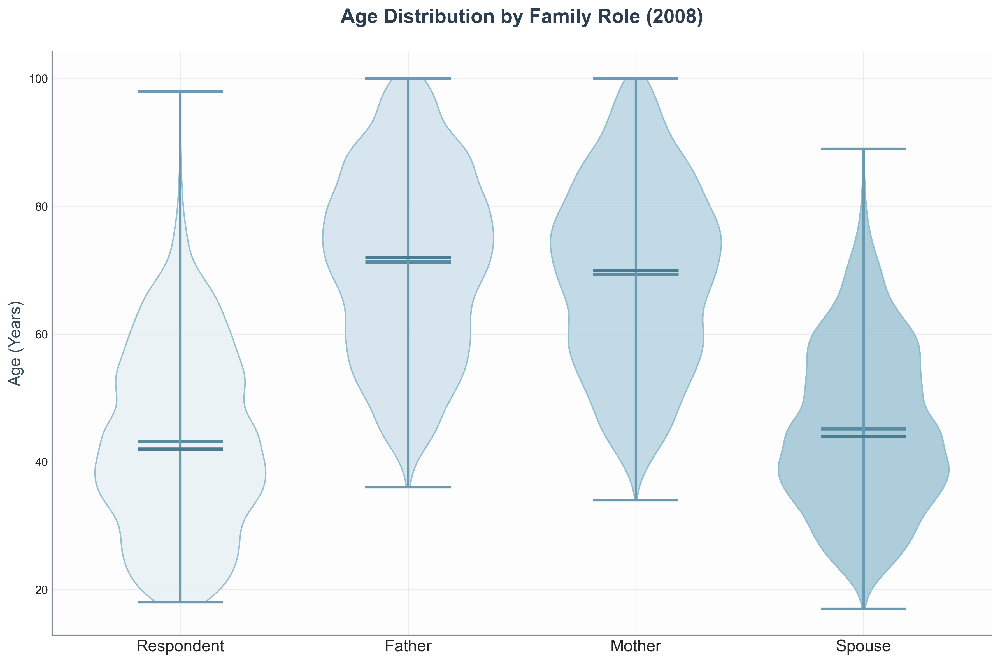

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


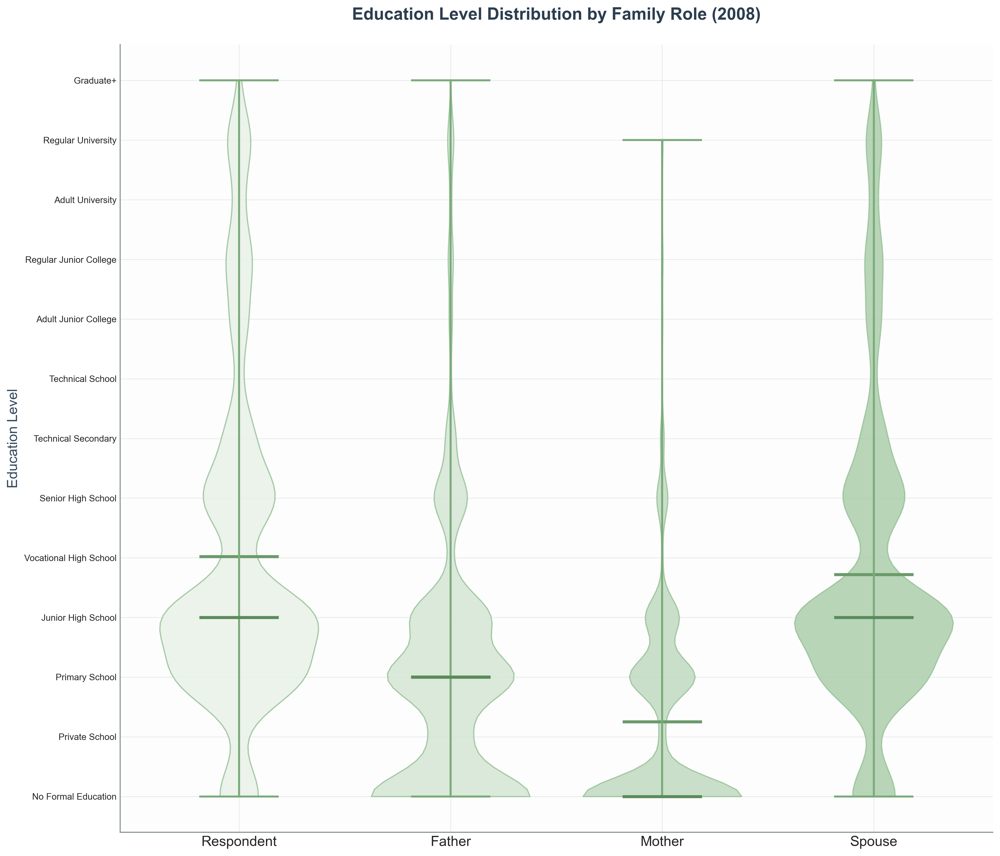

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


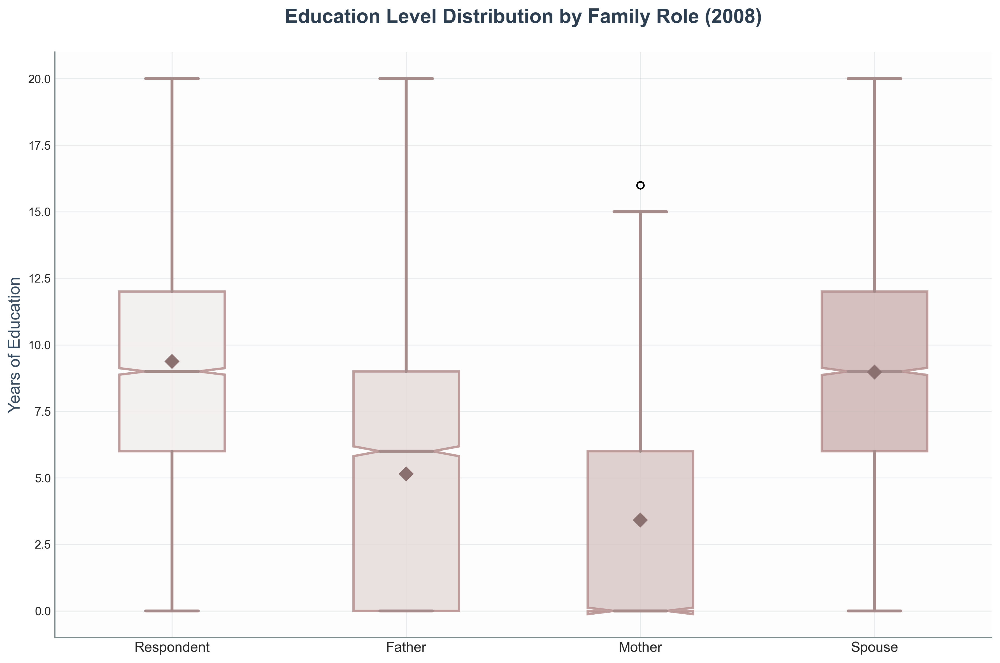

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


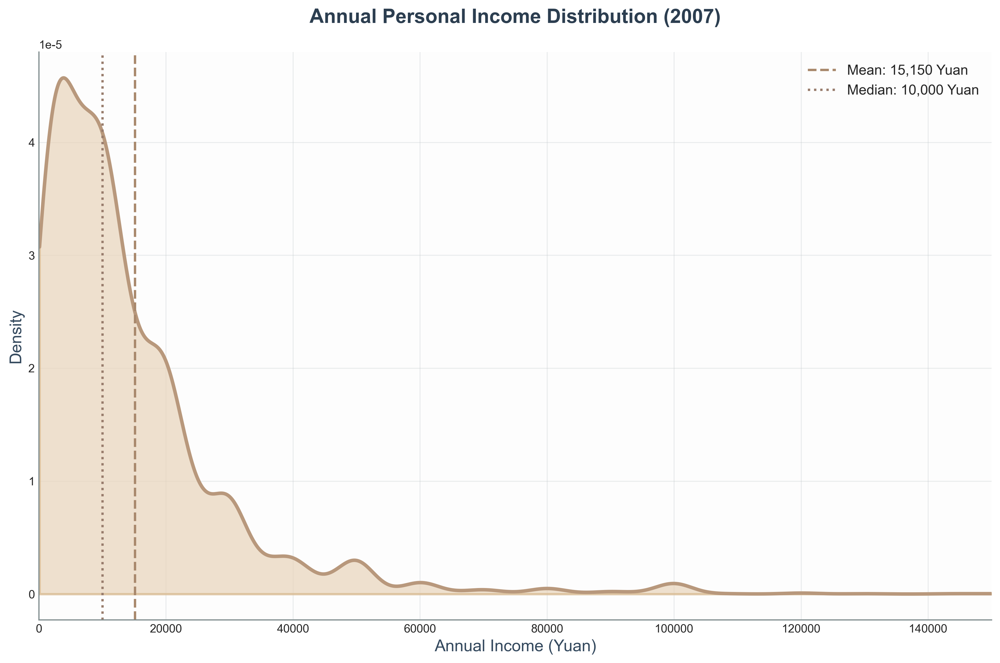

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


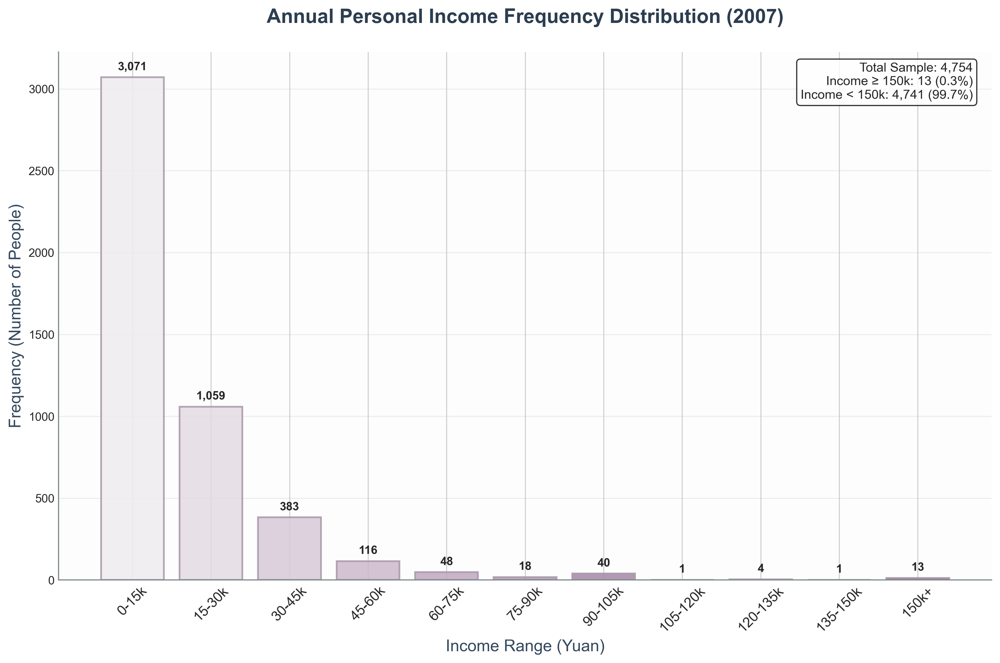

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2008:
- age_distribution_violin_2008.png (Morandi Blue)
- education_violin_plot_2008.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2008.png (Morandi Pink)
- income_density_plot_2008.png (Morandi Orange, 2007 income ≤150k)
- income_histogram_2008.png (Morandi Purple, frequency distribution with 150k+ group)


In [25]:
#  - 2008年调查
# CGSS2008数据可视化 - 2008年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2008 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2008年调查
        current_year = 2008
        age_vars = {}
        
        # Respondent age (from a2 - 出生年份)
        if 'a2' in df.columns:
            # Calculate age from birth year
            valid_birth_years = df['a2'][(df['a2'] > 1900) & (df['a2'] < 2008)]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from b12a - 父亲出生年)
        if 'b12a' in df.columns:
            # Remove missing values and invalid codes (9998=不知道, 9999=拒绝回答等)
            valid_father_birth = df['b12a'][(df['b12a'] > 1900) & (df['b12a'] < 2000)]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from b13a - 母亲出生年)
        if 'b13a' in df.columns:
            # Remove missing values and invalid codes
            valid_mother_birth = df['b13a'][(df['b13a'] > 1900) & (df['b13a'] < 2000)]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from b11a - 配偶出生年)
        if 'b11a' in df.columns:
            # Remove missing values and invalid codes (9998=不知道, 9997, 9999等)
            valid_spouse_birth = df['b11a'][(df['b11a'] > 1900) & (df['b11a'] < 2000)]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2008年教育变量，基于实际数据编码1-13（去掉14=其他）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding 14=其他 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        
        educ_vars = {}
        # Respondent education (from a3a - 最高教育程度)
        if 'a3a' in df.columns:
            educ_clean = df['a3a'][df['a3a'].isin(valid_educ_codes)]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from b12b - 父亲教育程度)
        if 'b12b' in df.columns:
            # Remove 14(其他), 9998 (不知道), 9999 (拒绝回答), and missing values
            f_educ_clean = df['b12b'][(df['b12b'].isin(valid_educ_codes))]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from b13b - 母亲教育程度)  
        if 'b13b' in df.columns:
            # Remove 14(其他), 9998 (不知道), 9999 (拒绝回答), and missing values
            m_educ_clean = df['b13b'][(df['b13b'].isin(valid_educ_codes))]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from b11b - 配偶教育程度)
        if 'b11b' in df.columns:
            # Remove 14(其他), 9998 (不知道), 9999 (拒绝回答), and missing values
            s_educ_clean = df['b11b'][(df['b11b'].isin(valid_educ_codes))]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a21a (个人去年全年的职业收入)
        yearly_income = None
        if 'a21a' in df.columns:
            # Remove 0 (没有收入), 不适用, 不知道, 拒绝回答等无效值
            # Keep only positive numeric income values, remove extreme outliers
            income_clean = df['a21a'][(df['a21a'] > 0) & 
                                      (df['a21a'] < 9999990) & 
                                      (df['a21a'] < 2000000)]  # Remove extreme outliers
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2008)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2008.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2008)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2008年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2008.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2008)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2008.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 150,000 (2008年收入可能更高)
        display_income = yearly_income[yearly_income <= 150000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 150000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_150k = len(yearly_income[yearly_income > 150000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 150000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 150000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2007)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 150000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2008.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 150k+ as the last group (适应2008年更高收入水平)
        bins = [0, 15000, 30000, 45000, 60000, 75000, 90000, 105000, 120000, 135000, 150000, float('inf')]
        bin_labels = ['0-15k', '15-30k', '30-45k', '45-60k', '60-75k', '75-90k', 
                     '90-105k', '105-120k', '120-135k', '135-150k', '150k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 150k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 150k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2007)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_150k = counts[-1]
        above_150k_pct = (above_150k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 150k: {above_150k:,} ({above_150k_pct:.1f}%)\n'
        stats_text += f'Income < 150k: {total_sample - above_150k:,} ({100-above_150k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2008.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2008 data visualization
    """
    # File path - 2008年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\3.CGSS2008_A.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2008 data...")
    print("Data cleaning: Removing age > 100, invalid education codes (including '其他'), income refusals/unknowns, and codes like 9998/9999")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2008 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2007): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2008:")
    print("- age_distribution_violin_2008.png (Morandi Blue)")
    print("- education_violin_plot_2008.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2008.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2008.png (Morandi Orange, 2007 income ≤150k)")
        print("- income_histogram_2008.png (Morandi Purple, frequency distribution with 150k+ group)")

if __name__ == "__main__":
    main()


Loading and processing CGSS2010 data...
Data cleaning: Removing age > 100, invalid education codes (-1, -2, -3), income refusals/unknowns
Data loaded successfully, shape: (11783, 869)

CGSS2010 Data summary after cleaning:
  Respondent age: 11780 valid samples
  Father age: 9031 valid samples
  Mother age: 9364 valid samples
  Spouse age: 9456 valid samples
  Respondent education: 11768 valid samples
  Father education: 11294 valid samples
  Mother education: 11461 valid samples
  Spouse education: 9458 valid samples
  Yearly income (2009): 9000 valid samples
  Income range: 8 - 2,800,000 Yuan
  Mean income: 21,016 Yuan
  Median income: 12,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


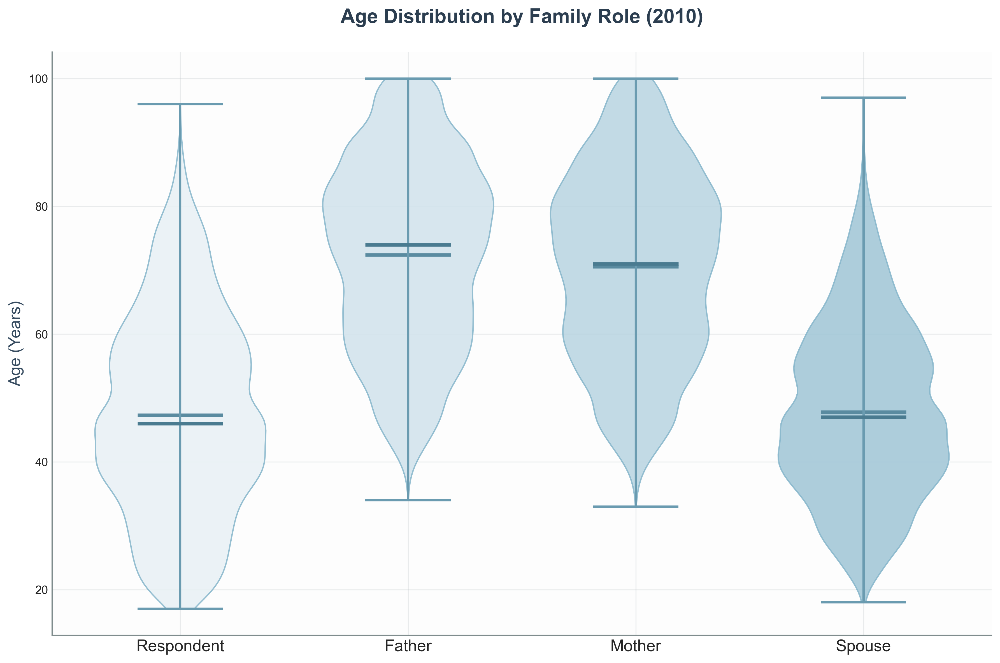

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


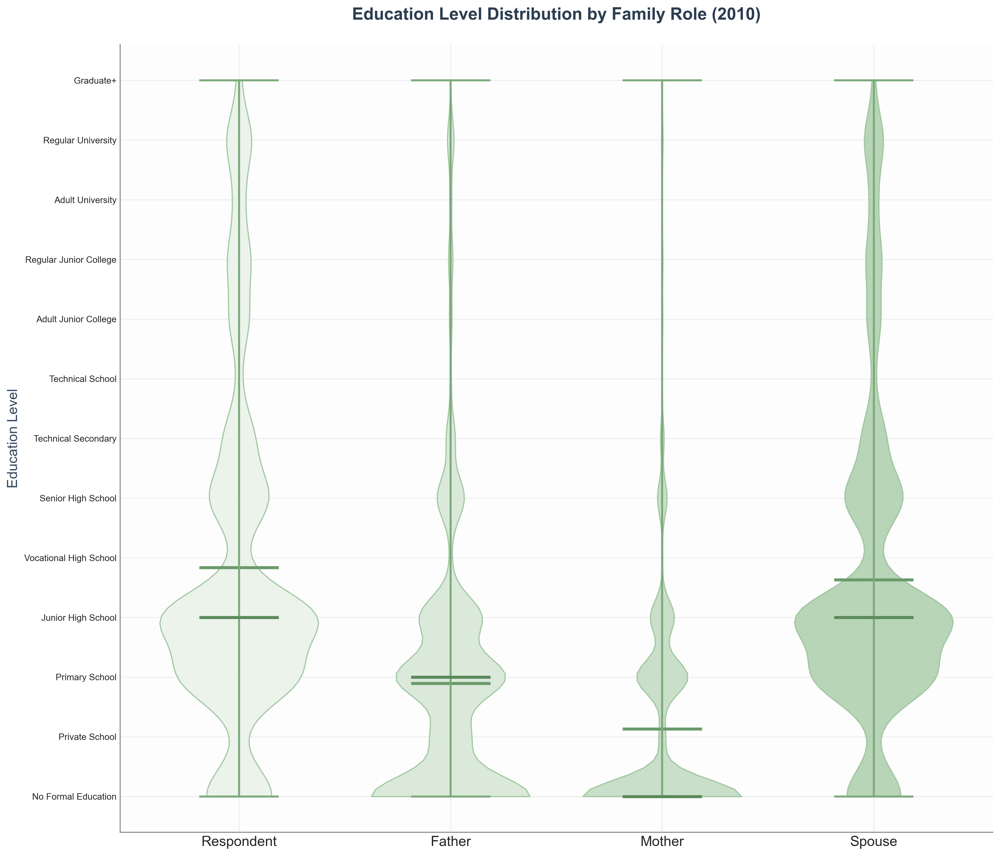

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


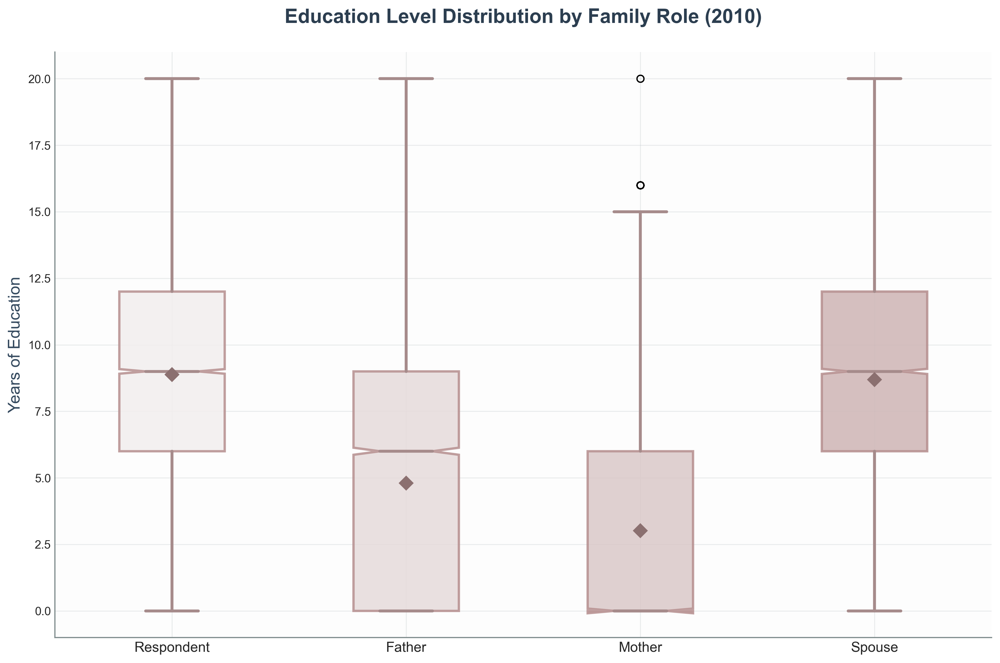

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


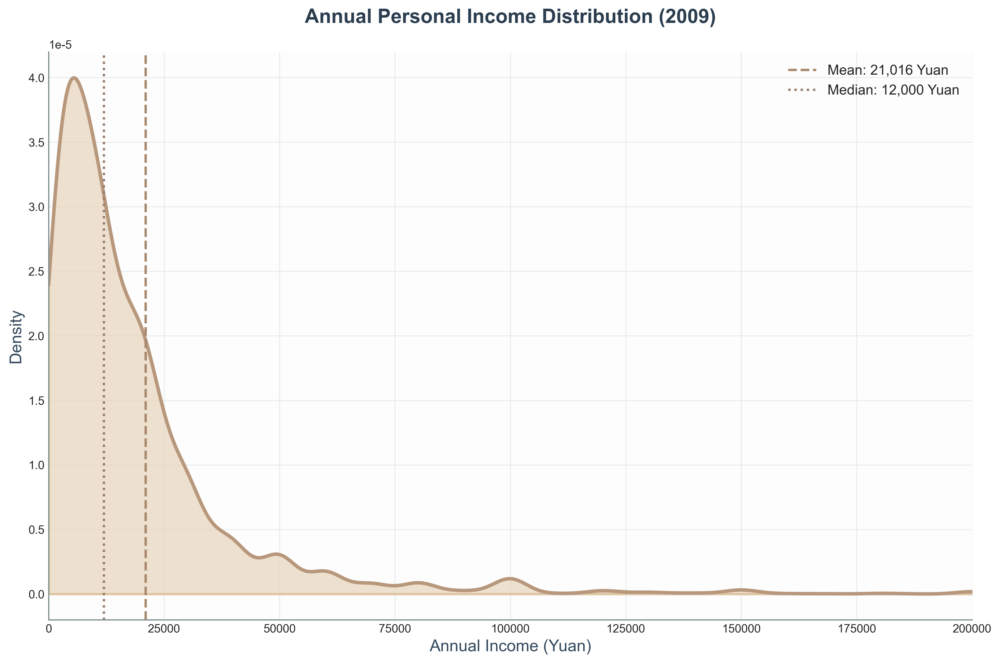

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


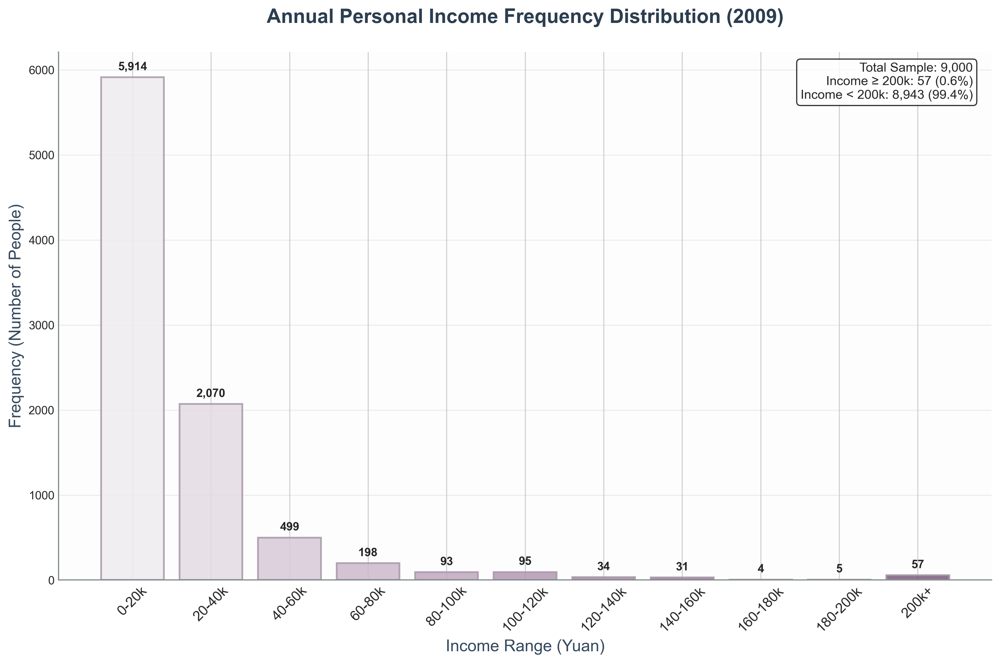

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2010:
- age_distribution_violin_2010.png (Morandi Blue)
- education_violin_plot_2010.png (Morandi Green, with actual education labels)
- education_box_plot_2010.png (Morandi Pink)
- income_density_plot_2010.png (Morandi Orange, 2009 income ≤200k)
- income_histogram_2010.png (Morandi Purple, frequency distribution with 200k+ group)


In [26]:
#2010

# CGSS2010数据可视化 - 2010年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2010 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2010年调查
        current_year = 2010
        age_vars = {}
        
        # Respondent age (from a3a - 出生日期-年)
        if 'a3a' in df.columns:
            # Calculate age from birth year, remove invalid values
            valid_birth_years = df['a3a'][(df['a3a'] > 1900) & (df['a3a'] < 2010)]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 您父亲是哪一年出生的？)
        if 'a89a' in df.columns:
            # Remove missing values and invalid codes (-3=拒绝回答, -2=不知道, -1=不适用)
            valid_father_birth = df['a89a'][(df['a89a'] > 1900) & (df['a89a'] < 2000)]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 您母亲是哪一年出生的?)
        if 'a90a' in df.columns:
            # Remove missing values and invalid codes (-3, -2, -1)
            valid_mother_birth = df['a90a'][(df['a90a'] > 1900) & (df['a90a'] < 2000)]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 您目前的配偶或同居伴侣是哪一年出生的？)
        if 'a71a' in df.columns:
            # Remove missing values and invalid codes (-3, -2, -1)
            valid_spouse_birth = df['a71a'][(df['a71a'] > 1900) & (df['a71a'] < 2000)]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2010年教育变量，基于实际数据编码1-13（没有14=其他）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding missing values and negative codes)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度是)
        if 'a7a' in df.columns:
            # Remove -1, -2, -3 and missing values
            educ_clean = df['a7a'][(df['a7a'].isin(valid_educ_codes))]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度是？)
        if 'a89b' in df.columns:
            # Remove -1, -2, -3 and missing values
            f_educ_clean = df['a89b'][(df['a89b'].isin(valid_educ_codes))]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度是？)  
        if 'a90b' in df.columns:
            # Remove -1, -2, -3 and missing values
            m_educ_clean = df['a90b'][(df['a90b'].isin(valid_educ_codes))]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度是？)
        if 'a72' in df.columns:
            # Remove -1, -2, -3 and missing values
            s_educ_clean = df['a72'][(df['a72'].isin(valid_educ_codes))]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年（2009年）全年的总收入为)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove 0 (没有收入), 负值, 以及极端异常值
            # Keep only positive numeric income values, remove extreme outliers
            income_clean = df['a8a'][(df['a8a'] > 0) & 
                                      (df['a8a'] < 9999990) & 
                                      (df['a8a'] < 3000000)]  # Remove extreme outliers (adjusted for 2009)
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2010)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2010.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2010)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13)
        education_ticks = list(range(1, 14))  # 2010年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2010.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2010)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2010.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 200,000 (2009年收入可能更高)
        display_income = yearly_income[yearly_income <= 200000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 200000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_200k = len(yearly_income[yearly_income > 200000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 200000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 200000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2009)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 200000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2010.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 200k+ as the last group (适应2009年更高收入水平)
        bins = [0, 20000, 40000, 60000, 80000, 100000, 120000, 140000, 160000, 180000, 200000, float('inf')]
        bin_labels = ['0-20k', '20-40k', '40-60k', '60-80k', '80-100k', '100-120k', 
                     '120-140k', '140-160k', '160-180k', '180-200k', '200k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 200k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 200k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2009)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_200k = counts[-1]
        above_200k_pct = (above_200k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 200k: {above_200k:,} ({above_200k_pct:.1f}%)\n'
        stats_text += f'Income < 200k: {total_sample - above_200k:,} ({100-above_200k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2010.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2010 data visualization
    """
    # File path - 2010年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\4.CGSS2010.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2010 data...")
    print("Data cleaning: Removing age > 100, invalid education codes (-1, -2, -3), income refusals/unknowns")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2010 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2009): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2010:")
    print("- age_distribution_violin_2010.png (Morandi Blue)")
    print("- education_violin_plot_2010.png (Morandi Green, with actual education labels)")
    print("- education_box_plot_2010.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2010.png (Morandi Orange, 2009 income ≤200k)")
        print("- income_histogram_2010.png (Morandi Purple, frequency distribution with 200k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2011 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -3, 9998, 9997, 99996, 99999)
               Removing invalid education codes (-1, -2, -3, 9998, 9997, 99996, 99999)
               Removing invalid income codes (9999997, 9999998, 9999999)
Data loaded successfully, shape: (5620, 594)

CGSS2011 Data summary after cleaning:
  Respondent age: 5619 valid samples
  Father age: 3366 valid samples
  Mother age: 3539 valid samples
  Spouse age: 4465 valid samples
  Respondent education: 5618 valid samples
  Father education: 5340 valid samples
  Mother education: 5467 valid samples
  Spouse education: 4457 valid samples
  Yearly income (2010): 4557 valid samples
  Income range: 50 - 1,600,000 Yuan
  Mean income: 18,978 Yuan
  Median income: 11,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


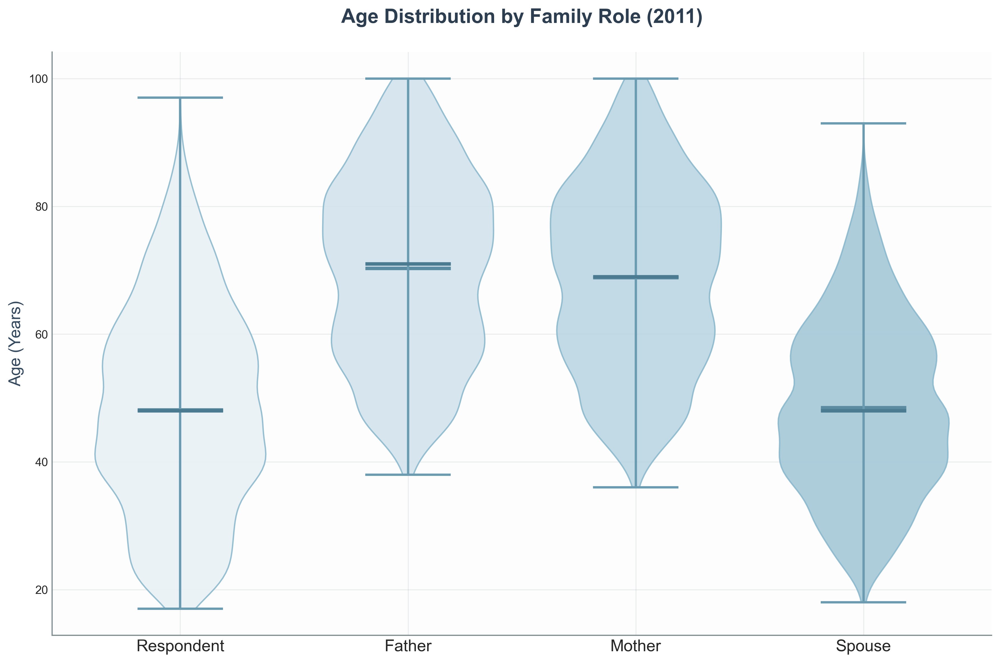

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


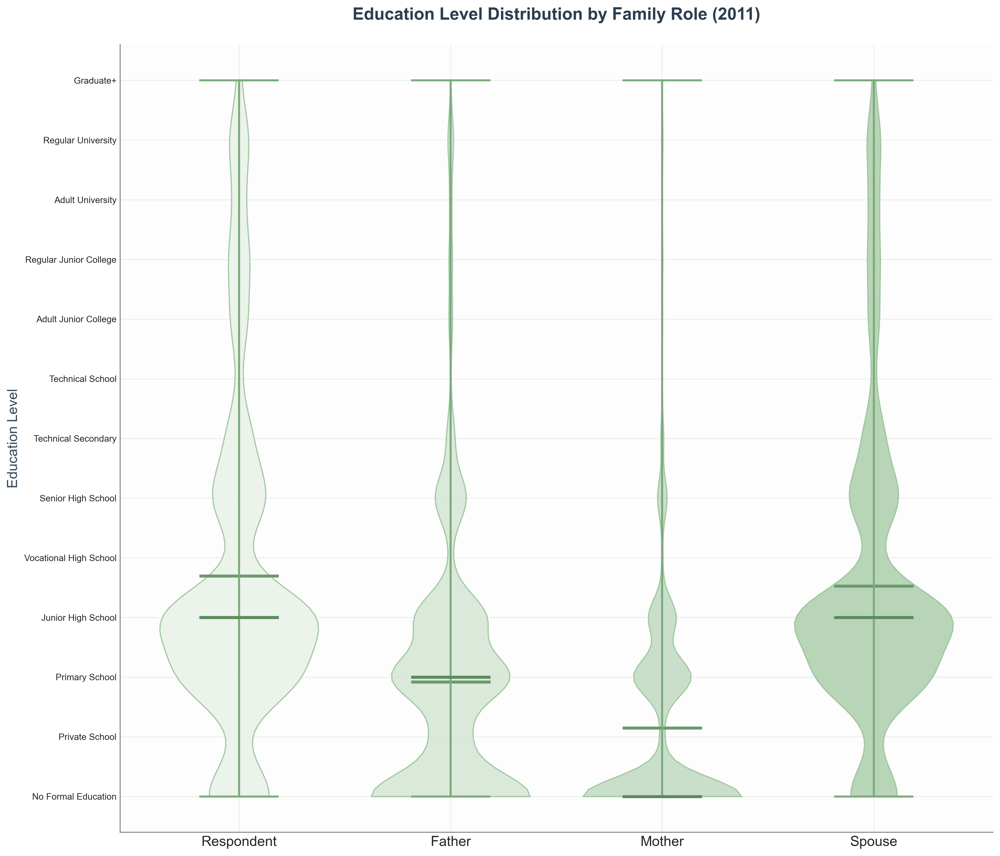

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


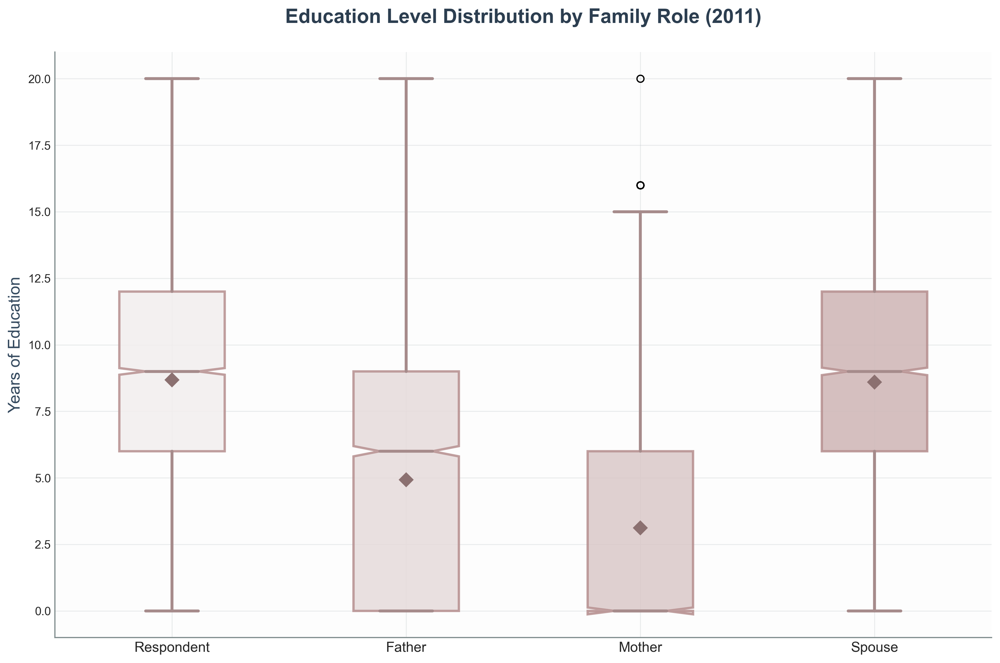

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


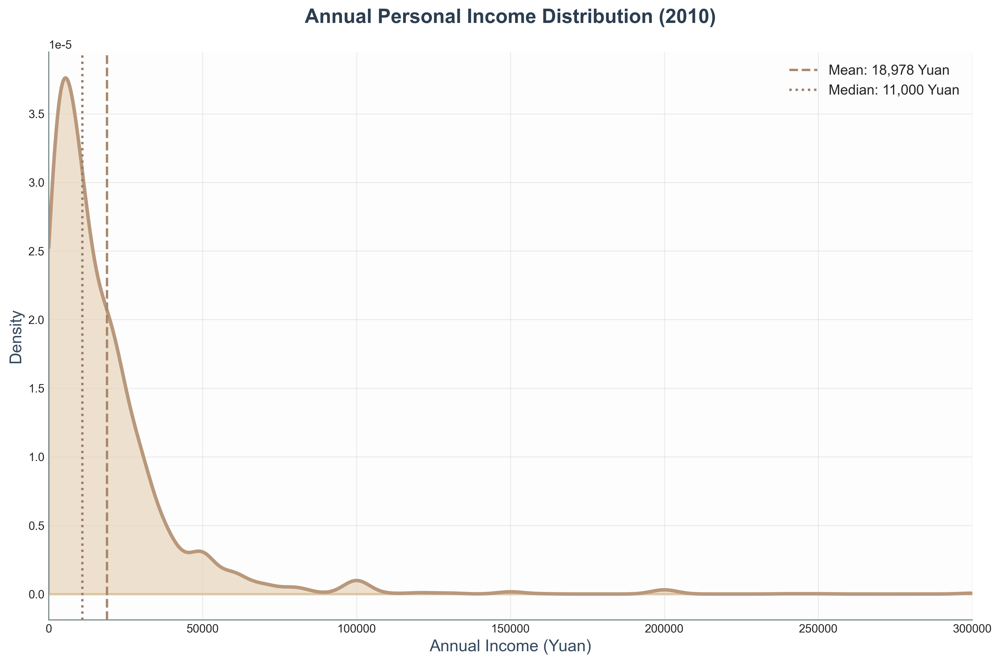

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


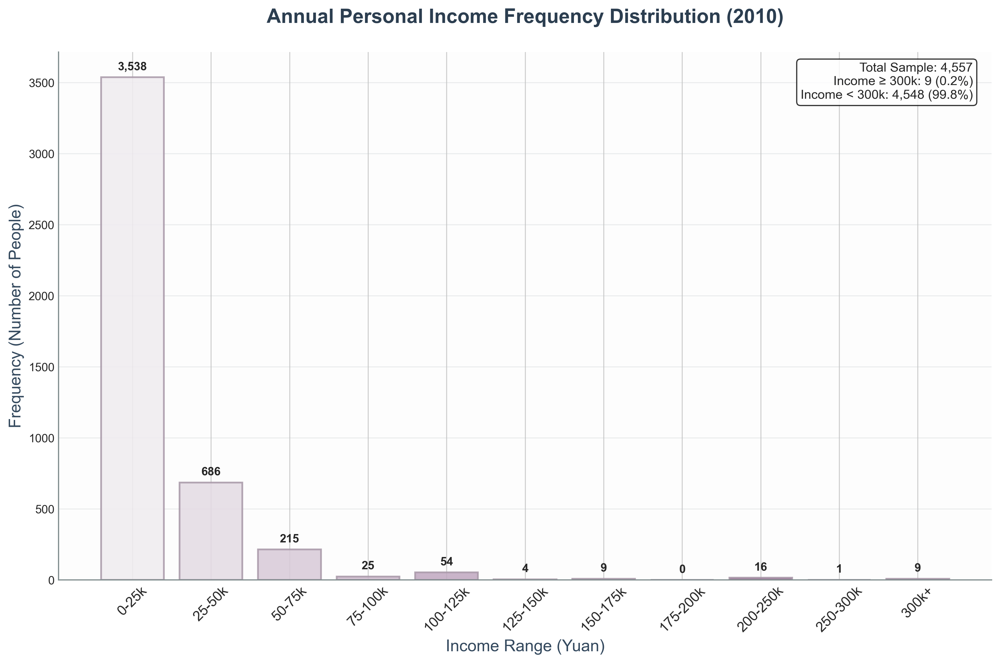

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2011:
- age_distribution_violin_2011.png (Morandi Blue)
- education_violin_plot_2011.png (Morandi Green, with actual education labels)
- education_box_plot_2011.png (Morandi Pink)
- income_density_plot_2011.png (Morandi Orange, 2010 income ≤300k)
- income_histogram_2011.png (Morandi Purple, frequency distribution with 300k+ group)


In [27]:
#2011

# CGSS2011数据可视化 - 2011年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2011 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2011年调查
        current_year = 2011
        age_vars = {}
        
        # Respondent age (from a3a - 您的出生日期-年)
        if 'a3a' in df.columns:
            # Remove invalid values: -1, -3, 9998, 9997, 99996, 99999
            invalid_birth_codes = [-1, -3, 9998, 9997, 99996, 99999]
            valid_birth_years = df['a3a'][
                (~df['a3a'].isin(invalid_birth_codes)) & 
                (df['a3a'] > 1900) & 
                (df['a3a'] < 2011)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 请问您父亲是哪一年出生的)
        if 'a89a' in df.columns:
            # Remove invalid values: -1, -3, 9998, 9997, 99996, 99999
            invalid_birth_codes = [-1, -3, 9998, 9997, 99996, 99999]
            valid_father_birth = df['a89a'][
                (~df['a89a'].isin(invalid_birth_codes)) & 
                (df['a89a'] > 1900) & 
                (df['a89a'] < 2000)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 请问您母亲是哪一年出生的)
        if 'a90a' in df.columns:
            # Remove invalid values: -1, -3, 9998, 9997, 99996, 99999
            invalid_birth_codes = [-1, -3, 9998, 9997, 99996, 99999]
            valid_mother_birth = df['a90a'][
                (~df['a90a'].isin(invalid_birth_codes)) & 
                (df['a90a'] > 1900) & 
                (df['a90a'] < 2000)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 请问您目前的配偶或同居伴侣是哪一年出生的)
        if 'a71a' in df.columns:
            # Remove invalid values: -1, -3, 9998, 9997, 99996, 99999
            invalid_birth_codes = [-1, -3, 9998, 9997, 99996, 99999]
            valid_spouse_birth = df['a71a'][
                (~df['a71a'].isin(invalid_birth_codes)) & 
                (df['a71a'] > 1900) & 
                (df['a71a'] < 2000)
            ]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2011年教育变量，基于实际数据编码1-13（没有14=其他）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding missing values and negative codes)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-1, -2, -3, 9998, 9997, 99996, 99999]
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度是(包括目前在读的))
        if 'a7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['a7a'][
                (~df['a7a'].isin(invalid_educ_codes)) & 
                (df['a7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度是(包括目前在读的))
        if 'a89b' in df.columns:
            # Remove invalid codes and missing values
            f_educ_clean = df['a89b'][
                (~df['a89b'].isin(invalid_educ_codes)) & 
                (df['a89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度是(包括目前在读的))  
        if 'a90b' in df.columns:
            # Remove invalid codes and missing values
            m_educ_clean = df['a90b'][
                (~df['a90b'].isin(invalid_educ_codes)) & 
                (df['a90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度是(包括目前在读的))
        if 'a72' in df.columns:
            # Remove invalid codes and missing values
            s_educ_clean = df['a72'][
                (~df['a72'].isin(invalid_educ_codes)) & 
                (df['a72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年(2010年)全年的总收入是多少？)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove invalid income codes: 9999997, 9999998, 9999999, 不适用, 不知道, 拒绝回答
            # Also remove 0 (没有收入), 负值, 以及极端异常值
            invalid_income_codes = [9999997, 9999998, 9999999]
            income_clean = df['a8a'][
                (~df['a8a'].isin(invalid_income_codes)) & 
                (df['a8a'] > 0) & 
                (df['a8a'] < 5000000)  # Remove extreme outliers (adjusted for 2010)
            ]
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2011)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2011.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2011)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13)
        education_ticks = list(range(1, 14))  # 2011年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2011.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2011)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2011.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 300,000 (2010年收入可能更高)
        display_income = yearly_income[yearly_income <= 300000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 300000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_300k = len(yearly_income[yearly_income > 300000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 300000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 300000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2010)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 300000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2011.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 300k+ as the last group (适应2010年更高收入水平)
        bins = [0, 25000, 50000, 75000, 100000, 125000, 150000, 175000, 200000, 250000, 300000, float('inf')]
        bin_labels = ['0-25k', '25-50k', '50-75k', '75-100k', '100-125k', '125-150k', 
                     '150-175k', '175-200k', '200-250k', '250-300k', '300k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 300k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 300k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2010)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_300k = counts[-1]
        above_300k_pct = (above_300k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 300k: {above_300k:,} ({above_300k_pct:.1f}%)\n'
        stats_text += f'Income < 300k: {total_sample - above_300k:,} ({100-above_300k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2011.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2011 data visualization
    """
    # File path - 2011年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\5.CGSS2011.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2011 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -3, 9998, 9997, 99996, 99999)")
    print("               Removing invalid education codes (-1, -2, -3, 9998, 9997, 99996, 99999)")
    print("               Removing invalid income codes (9999997, 9999998, 9999999)")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2011 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2010): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2011:")
    print("- age_distribution_violin_2011.png (Morandi Blue)")
    print("- education_violin_plot_2011.png (Morandi Green, with actual education labels)")
    print("- education_box_plot_2011.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2011.png (Morandi Orange, 2010 income ≤300k)")
        print("- income_histogram_2011.png (Morandi Purple, frequency distribution with 300k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2012 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)
               Removing invalid education codes (-1, -2, -3, 14=其他, 9997, 9998, 9999)
               Removing invalid income codes and extreme outliers
Data loaded successfully, shape: (11765, 685)

CGSS2012 Data summary after cleaning:
  Respondent age: 11764 valid samples
  Father age: 6967 valid samples
  Mother age: 7264 valid samples
  Spouse age: 9411 valid samples
  Respondent education: 11761 valid samples
  Father education: 11287 valid samples
  Mother education: 11472 valid samples
  Spouse education: 9399 valid samples
  Yearly income (2011): 9698 valid samples
  Income range: 100 - 1,000,000 Yuan
  Mean income: 23,079 Yuan
  Median income: 15,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


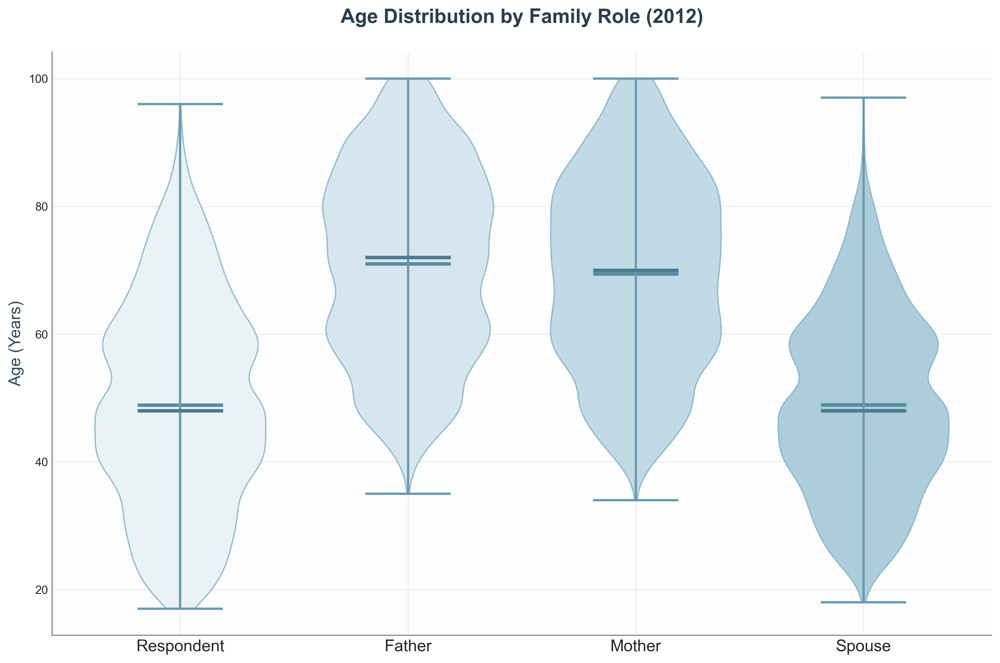

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


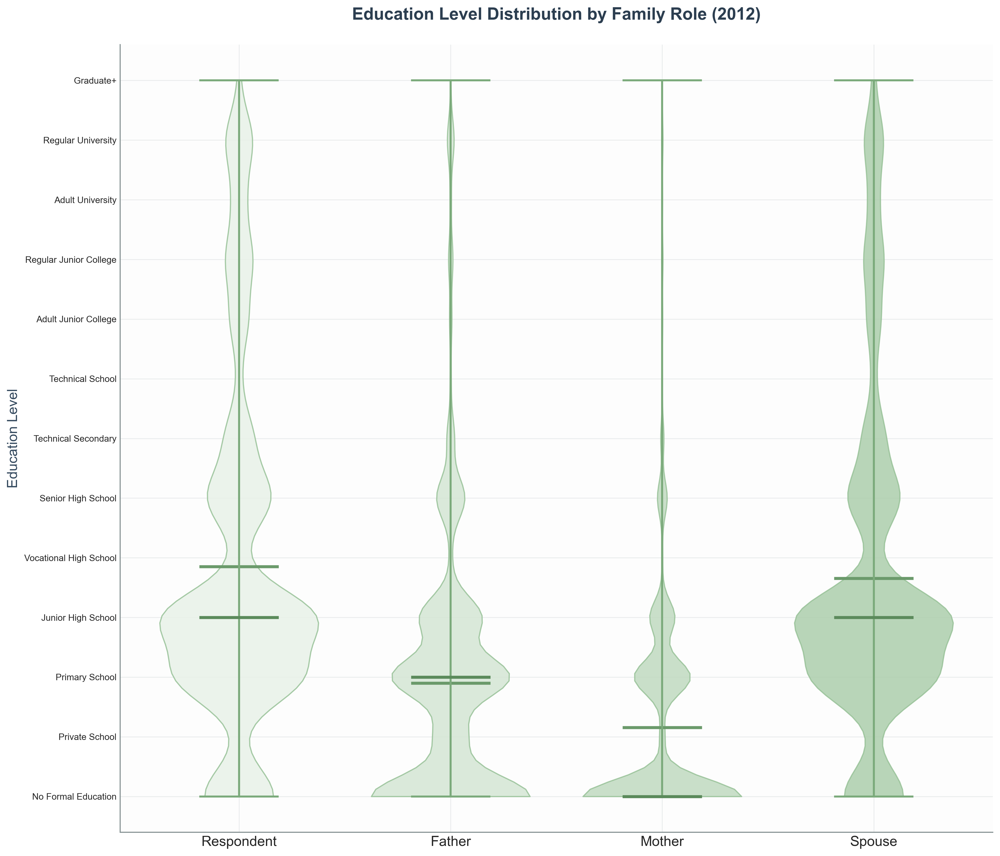

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


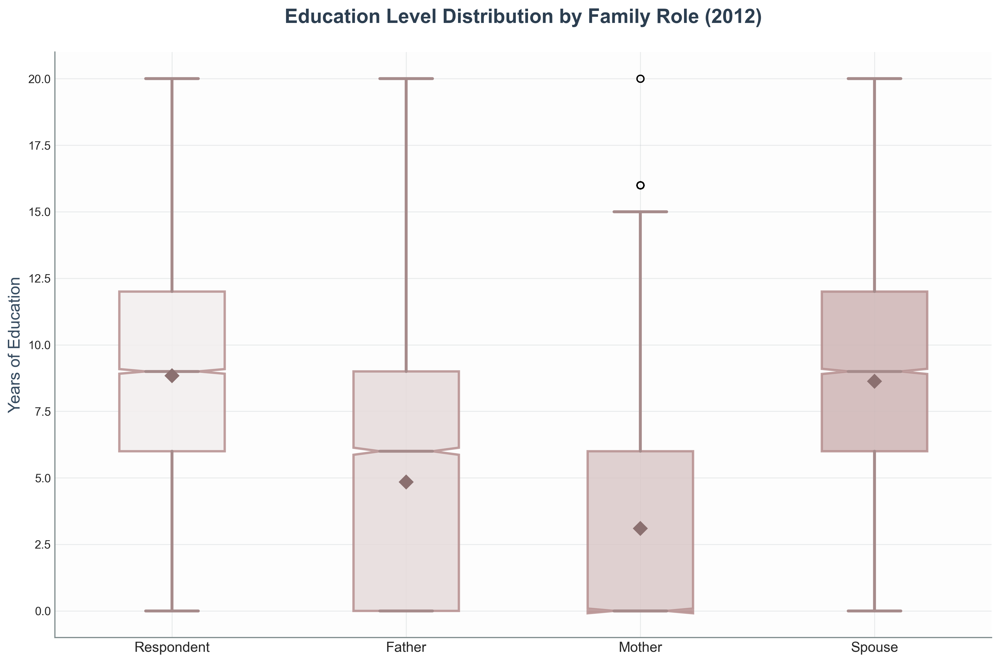

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


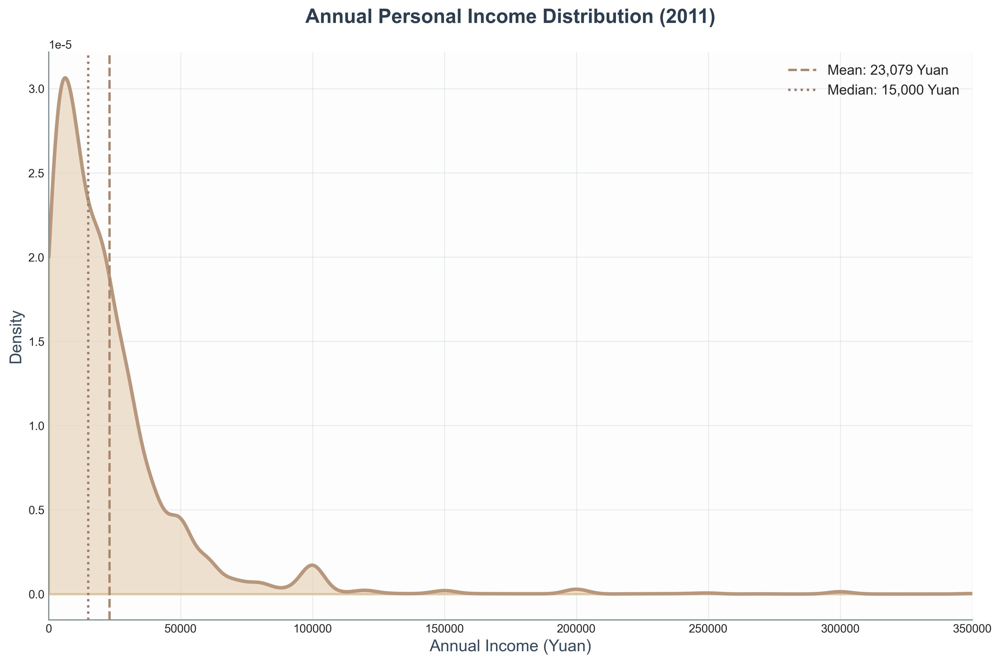

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


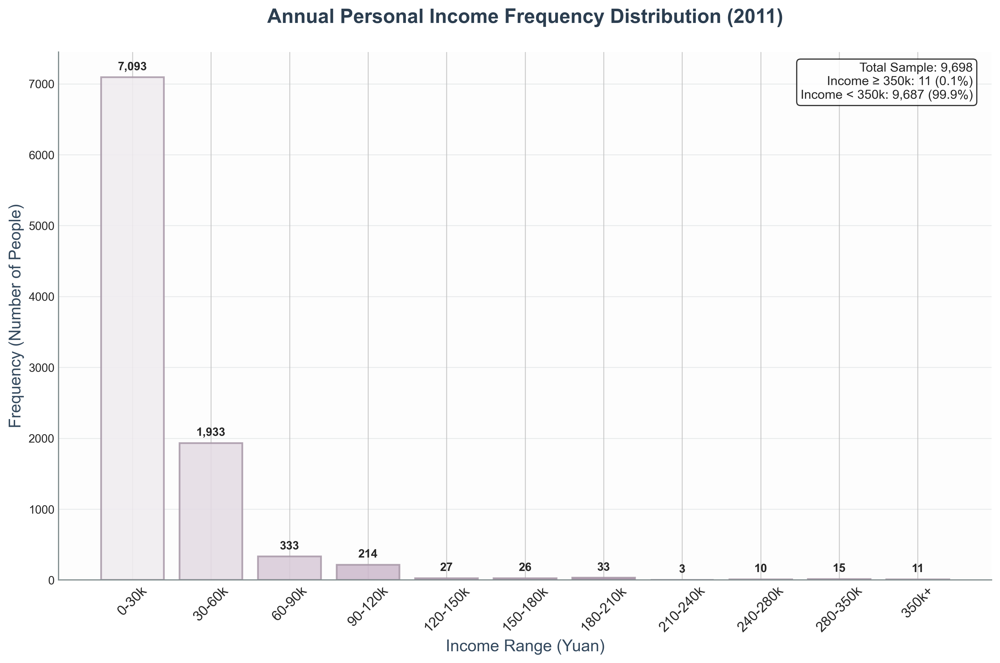

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2012:
- age_distribution_violin_2012.png (Morandi Blue)
- education_violin_plot_2012.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2012.png (Morandi Pink)
- income_density_plot_2012.png (Morandi Orange, 2011 income ≤350k)
- income_histogram_2012.png (Morandi Purple, frequency distribution with 350k+ group)


In [28]:
#2012

# CGSS2012数据可视化 - 2012年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2012 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2012年调查
        current_year = 2012
        age_vars = {}
        
        # Respondent age (from a3a - 您的出生日期-年)
        if 'a3a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999 and other invalid codes
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_birth_years = df['a3a'][
                (~df['a3a'].isin(invalid_birth_codes)) & 
                (df['a3a'] > 1900) & 
                (df['a3a'] < 2012)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 您父亲是哪一年出生的？)
        if 'a89a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_father_birth = df['a89a'][
                (~df['a89a'].isin(invalid_birth_codes)) & 
                (df['a89a'] > 1900) & 
                (df['a89a'] < 2000)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 您母亲是哪一年出生的？)
        if 'a90a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_mother_birth = df['a90a'][
                (~df['a90a'].isin(invalid_birth_codes)) & 
                (df['a90a'] > 1900) & 
                (df['a90a'] < 2000)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 您目前的配偶或同居伴侣是哪一年出生的)
        if 'a71a' in df.columns:
            # Remove invalid values and text entries like "拒绝回答", "不知道"
            # Keep only numeric values within reasonable range
            try:
                # Convert to numeric, coerce errors to NaN
                numeric_spouse_birth = pd.to_numeric(df['a71a'], errors='coerce')
                valid_spouse_birth = numeric_spouse_birth[
                    (numeric_spouse_birth > 1900) & 
                    (numeric_spouse_birth < 2000)
                ]
                if len(valid_spouse_birth) > 0:
                    df['s_age'] = current_year - valid_spouse_birth
                    s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                    age_vars['Spouse'] = s_age_clean.dropna()
            except:
                print("Warning: Spouse age data processing failed")
        
        # Education processing - 2012年教育变量，基于实际数据编码1-13（去掉14=其他）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生以上
        }
        
        # Valid education codes (1-13, excluding 14=其他 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-1, -2, -3, 14, 9997, 9998, 9999]  # 包括14=其他
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度是（包括目前在读的）)
        if 'a7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['a7a'][
                (~df['a7a'].isin(invalid_educ_codes)) & 
                (df['a7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度是)
        if 'a89b' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道
            f_educ_clean = df['a89b'][
                (~df['a89b'].isin(invalid_educ_codes)) & 
                (df['a89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度是)  
        if 'a90b' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道
            m_educ_clean = df['a90b'][
                (~df['a90b'].isin(invalid_educ_codes)) & 
                (df['a90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度是)
        if 'a72' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道
            s_educ_clean = df['a72'][
                (~df['a72'].isin(invalid_educ_codes)) & 
                (df['a72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年（2011）全年的总收入是多少)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove invalid income codes and extreme outliers
            # Keep only positive numeric income values
            try:
                # Convert to numeric, coerce errors to NaN
                numeric_income = pd.to_numeric(df['a8a'], errors='coerce')
                income_clean = numeric_income[
                    (numeric_income > 0) & 
                    (numeric_income < 5000000)  # Remove extreme outliers (adjusted for 2011)
                ]
                if len(income_clean) > 10:
                    yearly_income = income_clean.dropna()
            except:
                print("Warning: Income data processing failed")
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2012)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2012.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2012)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2012年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2012.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2012)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2012.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 350,000 (2011年收入可能更高)
        display_income = yearly_income[yearly_income <= 350000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 350000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_350k = len(yearly_income[yearly_income > 350000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 350000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 350000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2011)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 350000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2012.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 350k+ as the last group (适应2011年更高收入水平)
        bins = [0, 30000, 60000, 90000, 120000, 150000, 180000, 210000, 240000, 280000, 350000, float('inf')]
        bin_labels = ['0-30k', '30-60k', '60-90k', '90-120k', '120-150k', '150-180k', 
                     '180-210k', '210-240k', '240-280k', '280-350k', '350k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 350k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 350k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2011)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_350k = counts[-1]
        above_350k_pct = (above_350k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 350k: {above_350k:,} ({above_350k_pct:.1f}%)\n'
        stats_text += f'Income < 350k: {total_sample - above_350k:,} ({100-above_350k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2012.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2012 data visualization
    """
    # File path - 2012年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\6.CGSS2012.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2012 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)")
    print("               Removing invalid education codes (-1, -2, -3, 14=其他, 9997, 9998, 9999)")
    print("               Removing invalid income codes and extreme outliers")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2012 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2011): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2012:")
    print("- age_distribution_violin_2012.png (Morandi Blue)")
    print("- education_violin_plot_2012.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2012.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2012.png (Morandi Orange, 2011 income ≤350k)")
        print("- income_histogram_2012.png (Morandi Purple, frequency distribution with 350k+ group)")

if __name__ == "__main__":
    main()
    

Loading and processing CGSS2013 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)
               Removing invalid education codes (-1, -2, -3, 14=其他, 9997, 9998, 9999)
               Removing invalid income codes and extreme outliers
Data loaded successfully, shape: (11438, 722)

CGSS2013 Data summary after cleaning:
  Respondent age: 11437 valid samples
  Father age: 6442 valid samples
  Mother age: 6678 valid samples
  Spouse age: 9016 valid samples
  Respondent education: 11432 valid samples
  Father education: 11059 valid samples
  Mother education: 11224 valid samples
  Spouse education: 9015 valid samples
  Yearly income (2012): 9072 valid samples
  Income range: 80 - 1,000,000 Yuan
  Mean income: 26,888 Yuan
  Median income: 20,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


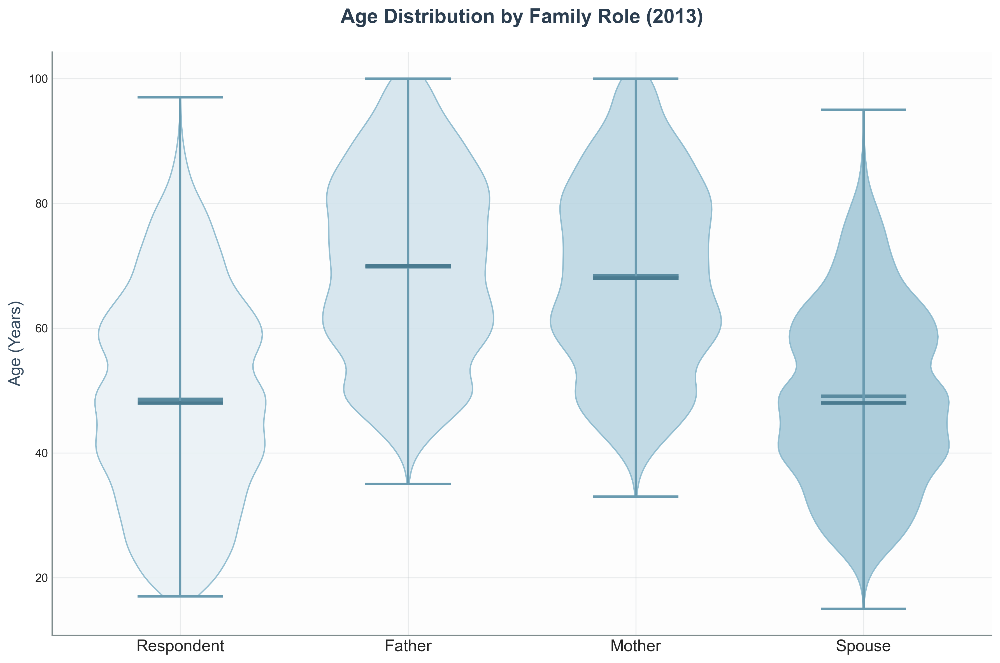

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


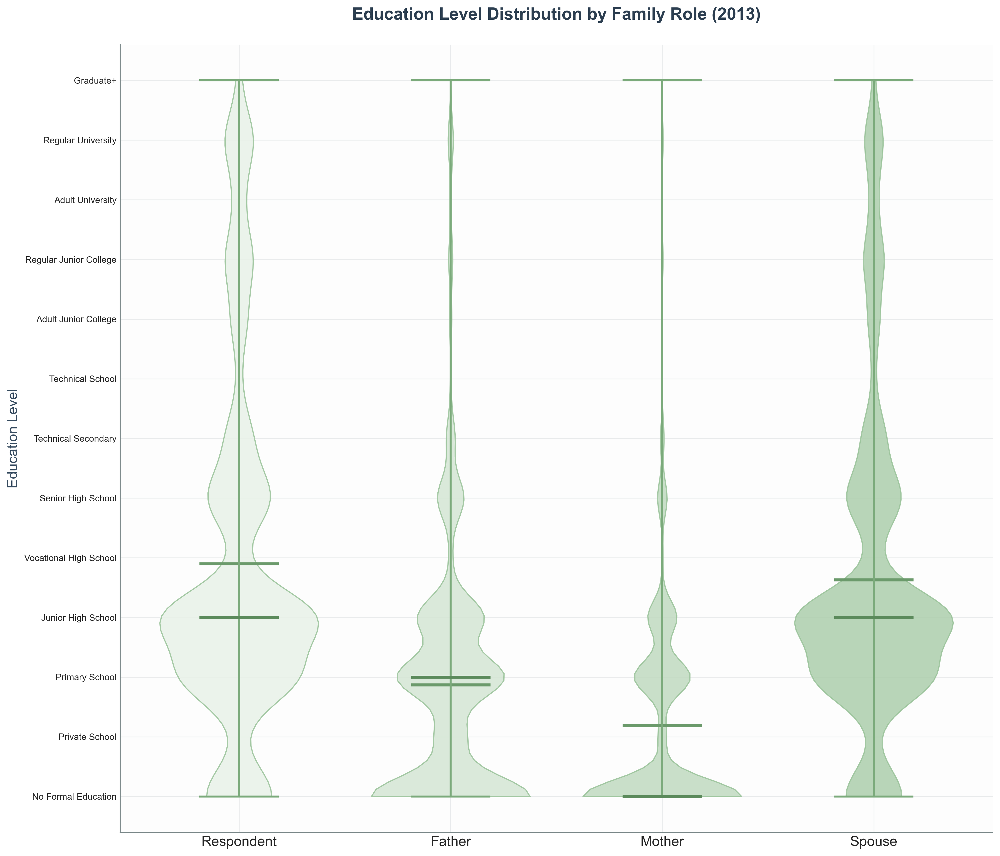

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


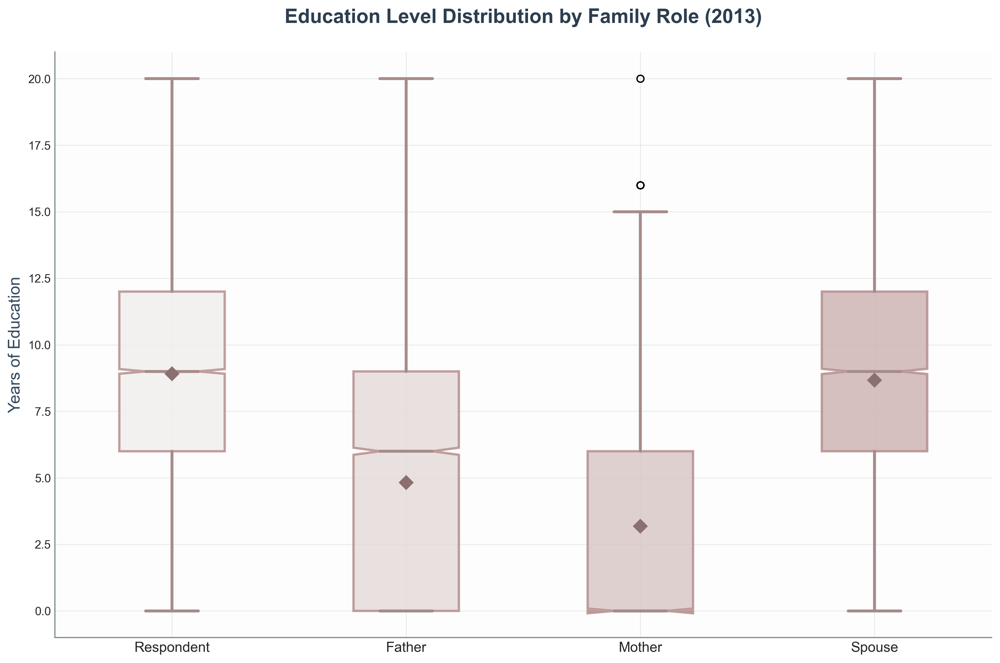

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


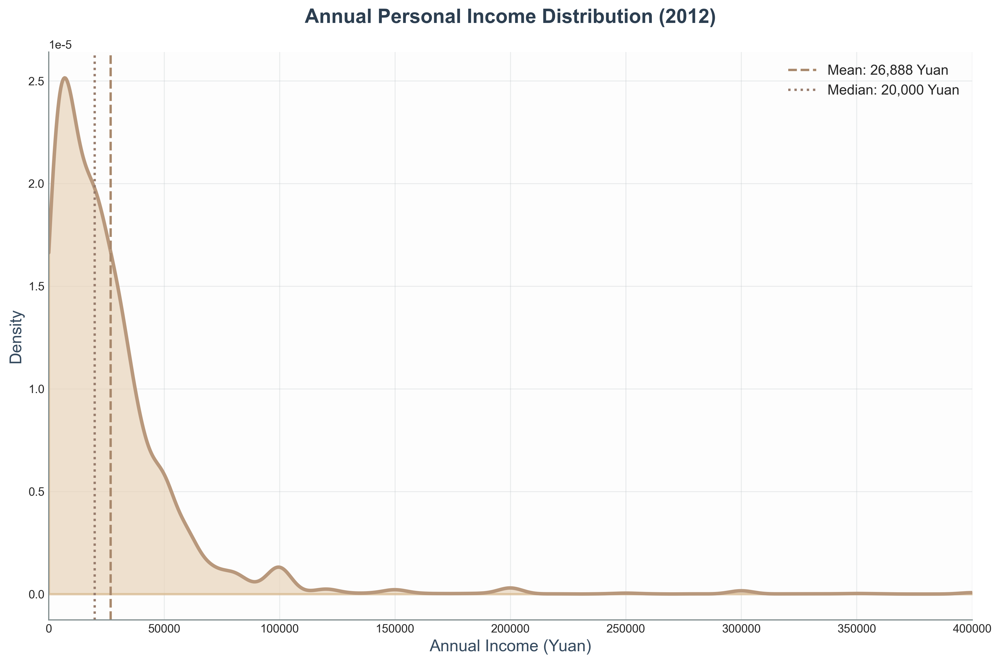

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


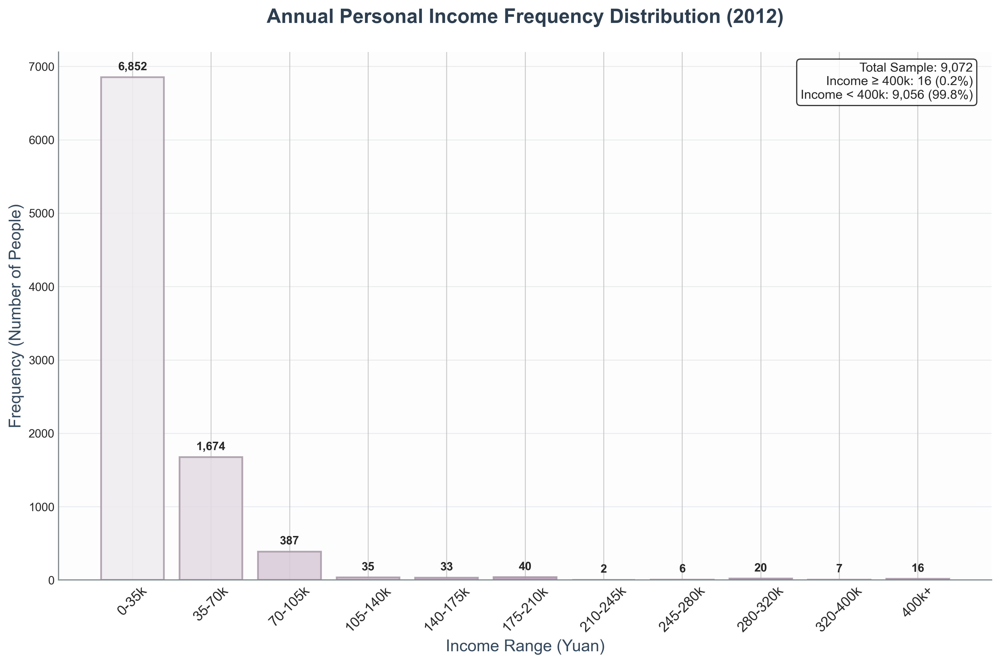

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2013:
- age_distribution_violin_2013.png (Morandi Blue)
- education_violin_plot_2013.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2013.png (Morandi Pink)
- income_density_plot_2013.png (Morandi Orange, 2012 income ≤400k)
- income_histogram_2013.png (Morandi Purple, frequency distribution with 400k+ group)


In [29]:
#2013

# CGSS2013数据可视化 - 2013年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2013 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2013年调查
        current_year = 2013
        age_vars = {}
        
        # Respondent age (from a3a - 您的出生日期-年)
        if 'a3a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999 and other invalid codes
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_birth_years = df['a3a'][
                (~df['a3a'].isin(invalid_birth_codes)) & 
                (df['a3a'] > 1900) & 
                (df['a3a'] < 2013)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 您父亲是哪一年出生的？)
        if 'a89a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_father_birth = df['a89a'][
                (~df['a89a'].isin(invalid_birth_codes)) & 
                (df['a89a'] > 1900) & 
                (df['a89a'] < 2000)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 您母亲是哪一年出生的？)
        if 'a90a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_mother_birth = df['a90a'][
                (~df['a90a'].isin(invalid_birth_codes)) & 
                (df['a90a'] > 1900) & 
                (df['a90a'] < 2000)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 您目前的配偶或同居伴侣是哪一年出生的)
        if 'a71a' in df.columns:
            # Remove invalid values: -1 (不适用), -2 (不知道), -3 (拒绝回答)
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_spouse_birth = df['a71a'][
                (~df['a71a'].isin(invalid_birth_codes)) & 
                (df['a71a'] > 1900) & 
                (df['a71a'] < 2000)
            ]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2013年教育变量，基于实际数据编码1-13（去掉14=其他）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生以上
        }
        
        # Valid education codes (1-13, excluding 14=其他 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-1, -2, -3, 14, 9997, 9998, 9999]  # 包括14=其他
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度是（包括目前在读的）)
        if 'a7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['a7a'][
                (~df['a7a'].isin(invalid_educ_codes)) & 
                (df['a7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度是)
        if 'a89b' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道, -1=不适用
            f_educ_clean = df['a89b'][
                (~df['a89b'].isin(invalid_educ_codes)) & 
                (df['a89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度是)  
        if 'a90b' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道, -1=不适用
            m_educ_clean = df['a90b'][
                (~df['a90b'].isin(invalid_educ_codes)) & 
                (df['a90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度是)
        if 'a72' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道, -1=不适用
            s_educ_clean = df['a72'][
                (~df['a72'].isin(invalid_educ_codes)) & 
                (df['a72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年（2012）全年的总收入是多少)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove invalid income codes and extreme outliers
            # Keep only positive numeric income values
            income_clean = df['a8a'][
                (df['a8a'] > 0) & 
                (df['a8a'] < 5000000)  # Remove extreme outliers (adjusted for 2012)
            ]
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2013)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2013.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2013)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2013年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2013.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2013)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2013.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 400,000 (2012年收入可能更高)
        display_income = yearly_income[yearly_income <= 400000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 400000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_400k = len(yearly_income[yearly_income > 400000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 400000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 400000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2012)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 400000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2013.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 400k+ as the last group (适应2012年更高收入水平)
        bins = [0, 35000, 70000, 105000, 140000, 175000, 210000, 245000, 280000, 320000, 400000, float('inf')]
        bin_labels = ['0-35k', '35-70k', '70-105k', '105-140k', '140-175k', '175-210k', 
                     '210-245k', '245-280k', '280-320k', '320-400k', '400k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 400k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 400k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2012)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_400k = counts[-1]
        above_400k_pct = (above_400k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 400k: {above_400k:,} ({above_400k_pct:.1f}%)\n'
        stats_text += f'Income < 400k: {total_sample - above_400k:,} ({100-above_400k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2013.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2013 data visualization
    """
    # File path - 2013年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11组数据（按年份分类）\7.CGSS2013.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2013 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)")
    print("               Removing invalid education codes (-1, -2, -3, 14=其他, 9997, 9998, 9999)")
    print("               Removing invalid income codes and extreme outliers")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2013 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2012): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2013:")
    print("- age_distribution_violin_2013.png (Morandi Blue)")
    print("- education_violin_plot_2013.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2013.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2013.png (Morandi Orange, 2012 income ≤400k)")
        print("- income_histogram_2013.png (Morandi Purple, frequency distribution with 400k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2015 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)
               Removing invalid education codes (-8, -1, -2, -3, 14=其他, 9997, 9998, 9999)
               Removing invalid income codes and extreme outliers
Data loaded successfully, shape: (10968, 1395)

CGSS2015 Data summary after cleaning:
  Respondent age: 10968 valid samples
  Father age: 5924 valid samples
  Mother age: 6237 valid samples
  Spouse age: 8599 valid samples
  Respondent education: 10939 valid samples
  Father education: 10055 valid samples
  Mother education: 10251 valid samples
  Spouse education: 8541 valid samples
  Yearly income (2014): 8717 valid samples
  Income range: 50 - 2,000,000 Yuan
  Mean income: 33,957 Yuan
  Median income: 20,400 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


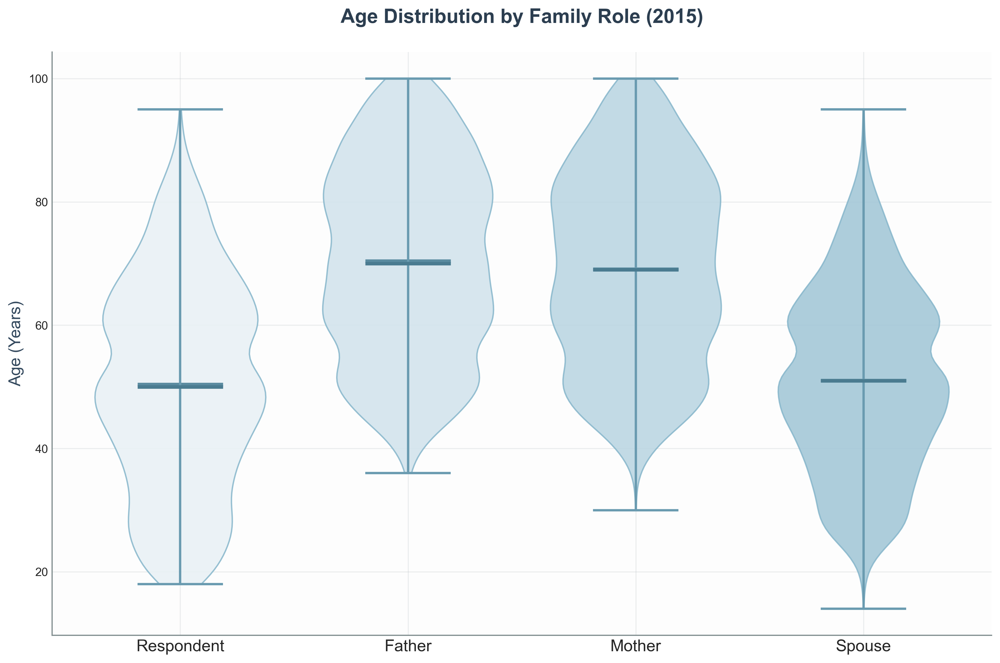

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


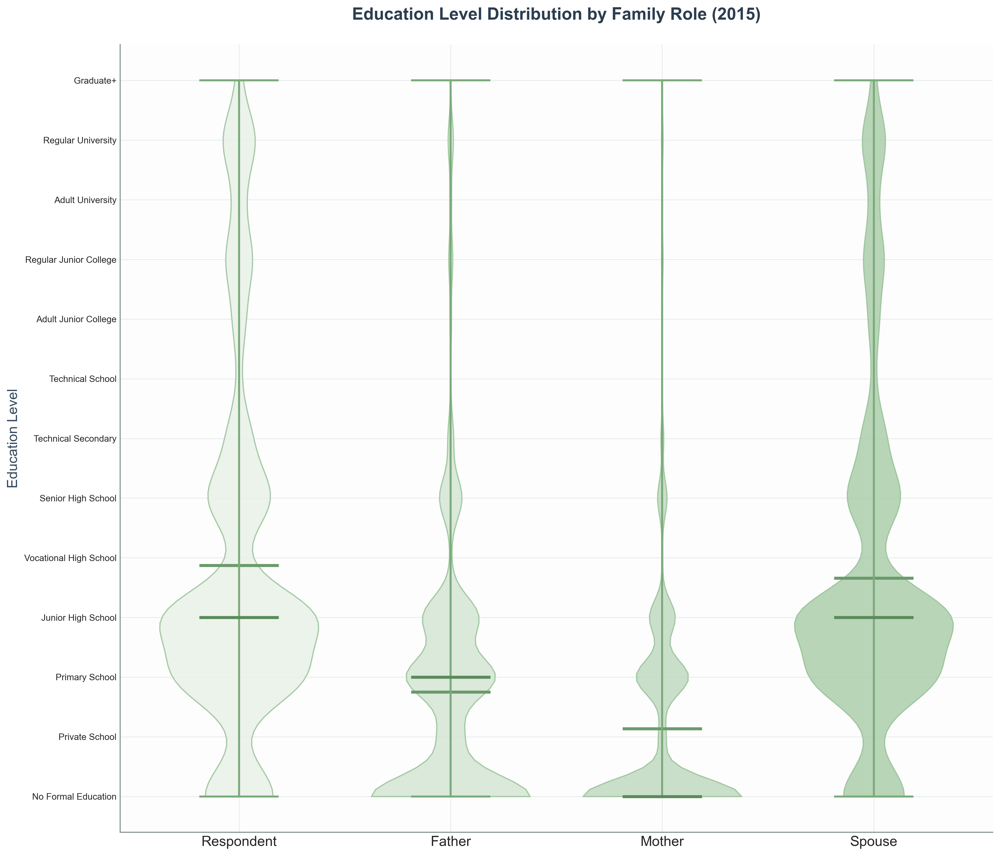

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


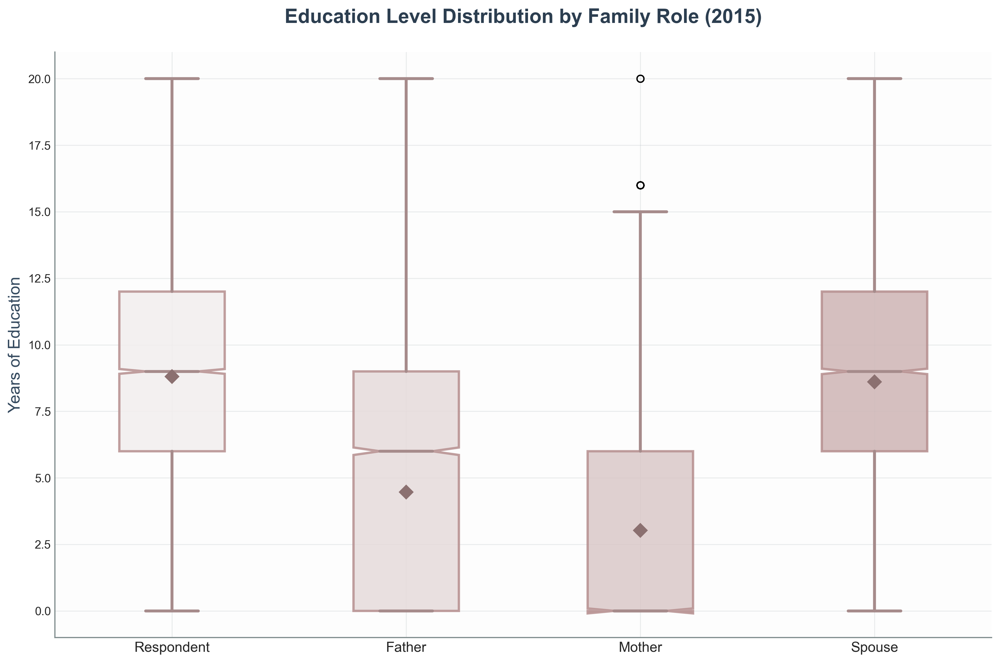

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


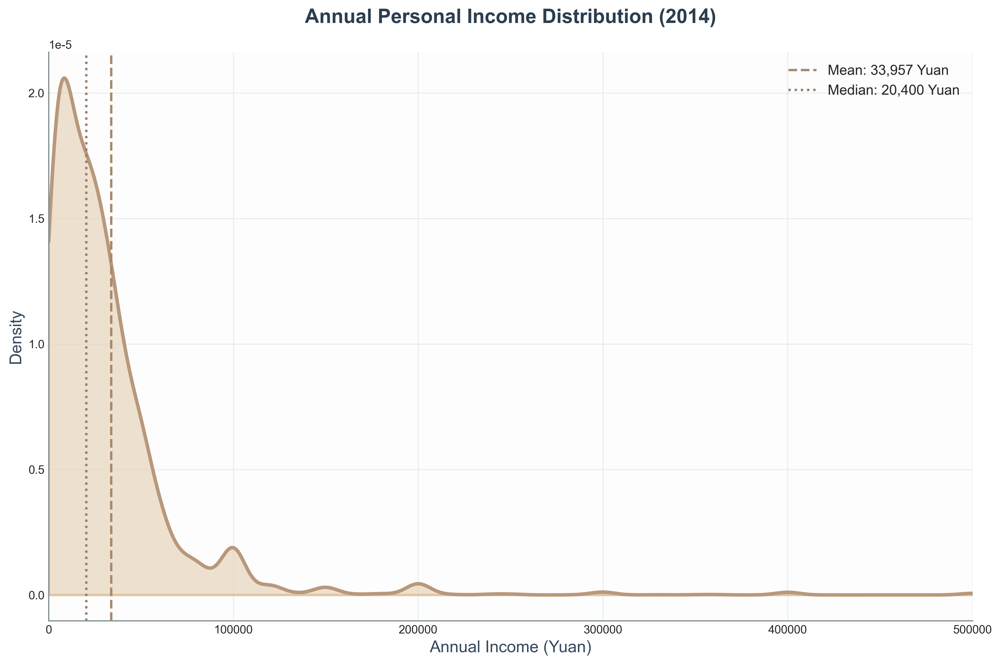

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


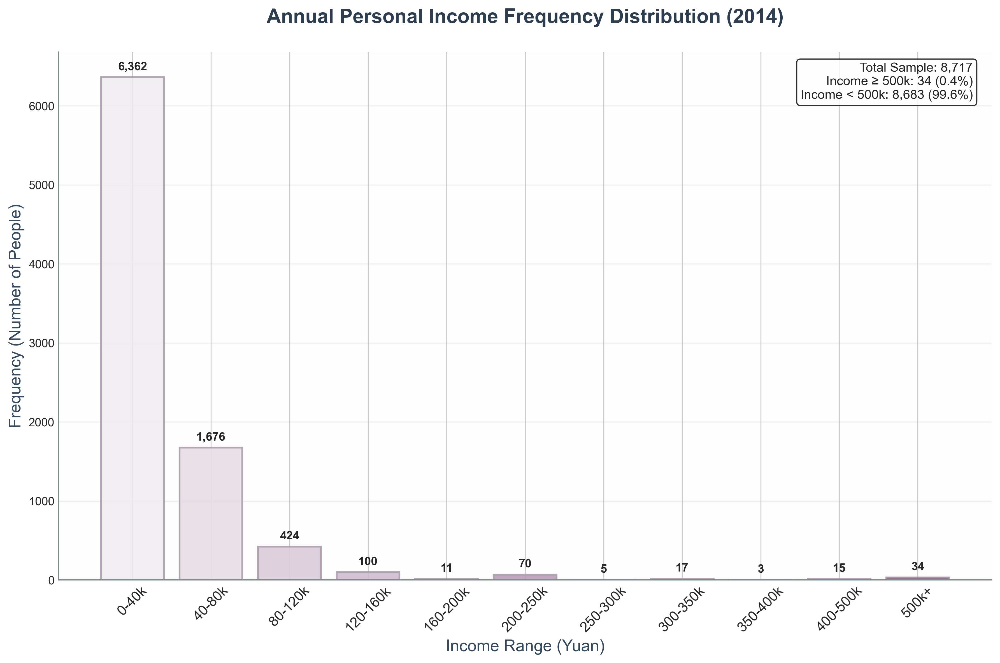

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2015:
- age_distribution_violin_2015.png (Morandi Blue)
- education_violin_plot_2015.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2015.png (Morandi Pink)
- income_density_plot_2015.png (Morandi Orange, 2014 income ≤500k)
- income_histogram_2015.png (Morandi Purple, frequency distribution with 500k+ group)


In [31]:
#2015

# CGSS2015数据可视化 - 2015年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2015 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2015年调查
        current_year = 2015
        age_vars = {}
        
        # Respondent age (from a301 - 您的出生日期-年)
        if 'a301' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999 and other invalid codes
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_birth_years = df['a301'][
                (~df['a301'].isin(invalid_birth_codes)) & 
                (df['a301'] > 1900) & 
                (df['a301'] < 2015)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 您父亲是哪一年出生的？)
        if 'a89a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_father_birth = df['a89a'][
                (~df['a89a'].isin(invalid_birth_codes)) & 
                (df['a89a'] > 1900) & 
                (df['a89a'] < 2002)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 您母亲是哪一年出生的？)
        if 'a90a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_mother_birth = df['a90a'][
                (~df['a90a'].isin(invalid_birth_codes)) & 
                (df['a90a'] > 1900) & 
                (df['a90a'] < 2002)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 您目前的配偶或同居伴侣是哪一年出生的)
        if 'a71a' in df.columns:
            # Remove invalid values: -1 (不适用), -2 (不知道), -3 (拒绝回答)
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_spouse_birth = df['a71a'][
                (~df['a71a'].isin(invalid_birth_codes)) & 
                (df['a71a'] > 1900) & 
                (df['a71a'] < 2002)
            ]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2015年教育变量，基于实际数据编码1-13（去掉14=其他）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾、扫盲班
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding 14=其他 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-8, -1, -2, -3, 14, 9997, 9998, 9999]  # 包括-8=无法回答和14=其他
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度（包括目前在读的）)
        if 'a7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['a7a'][
                (~df['a7a'].isin(invalid_educ_codes)) & 
                (df['a7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度)
        if 'a89b' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道, -1=不适用
            f_educ_clean = df['a89b'][
                (~df['a89b'].isin(invalid_educ_codes)) & 
                (df['a89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度)  
        if 'a90b' in df.columns:
            # Remove invalid codes including 14=其他, -3=拒绝回答, -2=不知道, -1=不适用
            m_educ_clean = df['a90b'][
                (~df['a90b'].isin(invalid_educ_codes)) & 
                (df['a90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度)
        if 'a72' in df.columns:
            # Remove invalid codes including 14=其他, -8=无法回答, -3=拒绝回答, -2=不知道, -1=不适用
            s_educ_clean = df['a72'][
                (~df['a72'].isin(invalid_educ_codes)) & 
                (df['a72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年（2014）全年的总收入)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove invalid income codes and extreme outliers
            # Keep only positive numeric income values
            income_clean = df['a8a'][
                (df['a8a'] > 0) & 
                (df['a8a'] < 5000000)  # Remove extreme outliers (adjusted for 2014)
            ]
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2015)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2015.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2015)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2015年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2015.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2015)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2015.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 500,000 (2014年收入可能更高)
        display_income = yearly_income[yearly_income <= 500000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 500000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_500k = len(yearly_income[yearly_income > 500000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 500000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 500000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2014)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 500000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2015.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 500k+ as the last group (适应2014年更高收入水平)
        bins = [0, 40000, 80000, 120000, 160000, 200000, 250000, 300000, 350000, 400000, 500000, float('inf')]
        bin_labels = ['0-40k', '40-80k', '80-120k', '120-160k', '160-200k', '200-250k', 
                     '250-300k', '300-350k', '350-400k', '400-500k', '500k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 500k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 500k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2014)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_500k = counts[-1]
        above_500k_pct = (above_500k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 500k: {above_500k:,} ({above_500k_pct:.1f}%)\n'
        stats_text += f'Income < 500k: {total_sample - above_500k:,} ({100-above_500k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2015.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2015 data visualization
    """
    # File path - 2015年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\8.CGSS2015.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2015 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)")
    print("               Removing invalid education codes (-8, -1, -2, -3, 14=其他, 9997, 9998, 9999)")
    print("               Removing invalid income codes and extreme outliers")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2015 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2014): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2015:")
    print("- age_distribution_violin_2015.png (Morandi Blue)")
    print("- education_violin_plot_2015.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2015.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2015.png (Morandi Orange, 2014 income ≤500k)")
        print("- income_histogram_2015.png (Morandi Purple, frequency distribution with 500k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2018 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9999996-9999999)
               Removing invalid education codes (-1, -2, -3, 14=其他, 98=不知道, 99=拒绝回答, 9999996-9999999)
               Removing invalid income codes and extreme outliers
Data loaded successfully, shape: (12787, 1030)

CGSS2018 Data summary after cleaning:
  Respondent age: 12783 valid samples
  Father age: 7310 valid samples
  Mother age: 7668 valid samples
  Spouse age: 9630 valid samples
  Respondent education: 12758 valid samples
  Father education: 11952 valid samples
  Mother education: 12241 valid samples
  Spouse education: 9774 valid samples
  Yearly income (2017): 10156 valid samples
  Income range: 1 - 1,500,000 Yuan
  Mean income: 45,188 Yuan
  Median income: 30,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


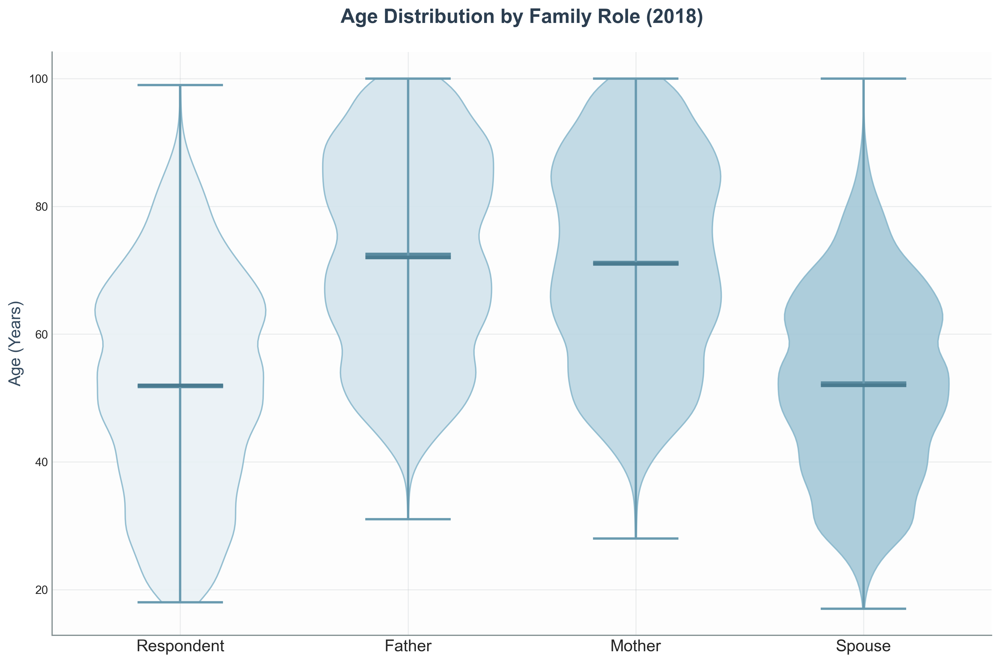

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


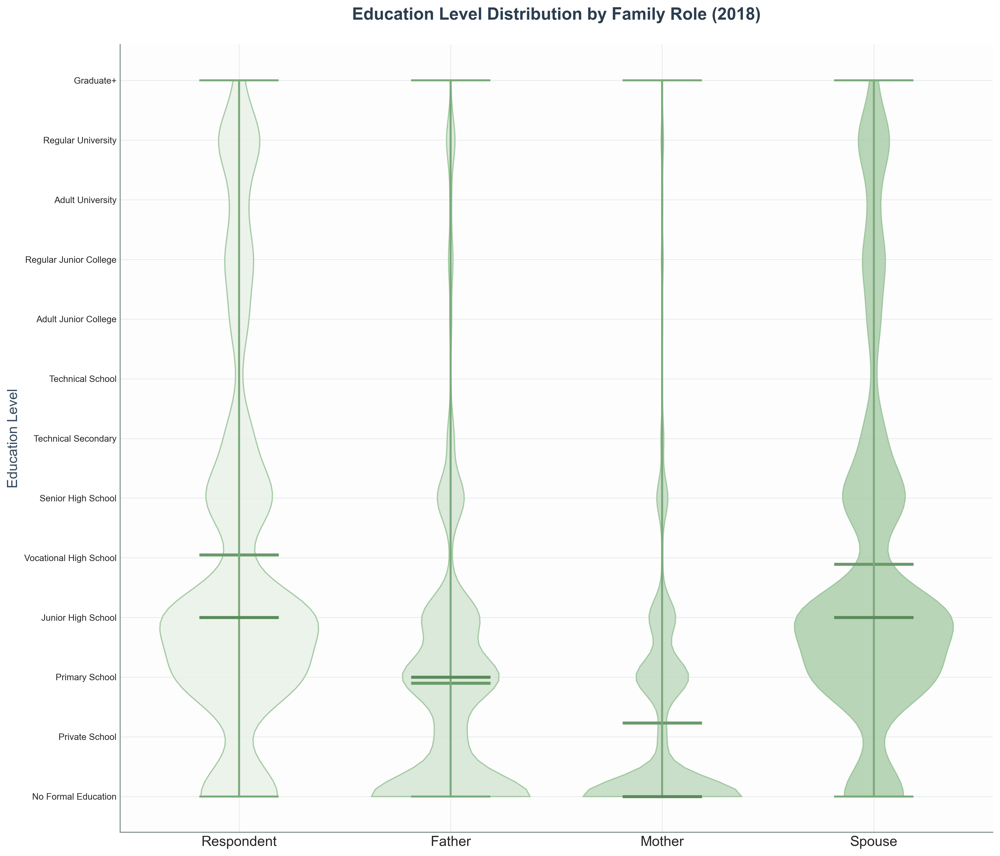

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


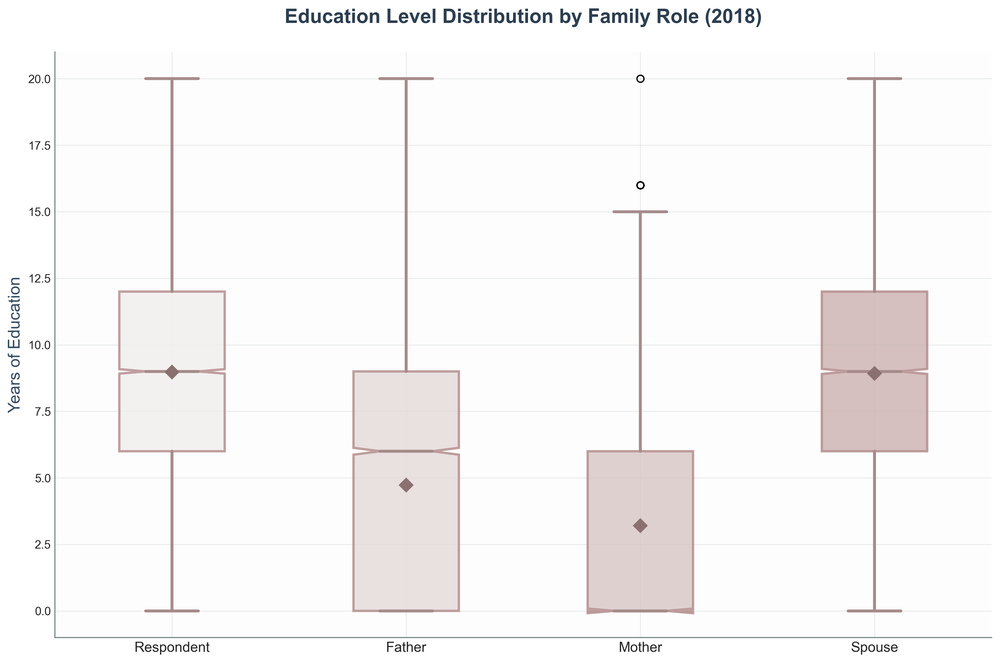

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


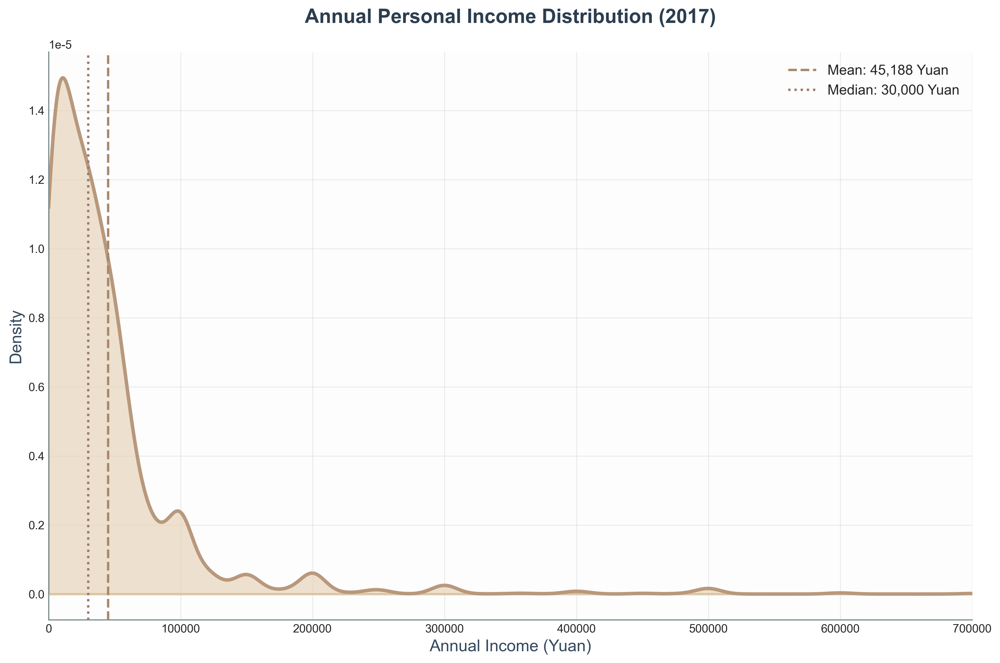

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


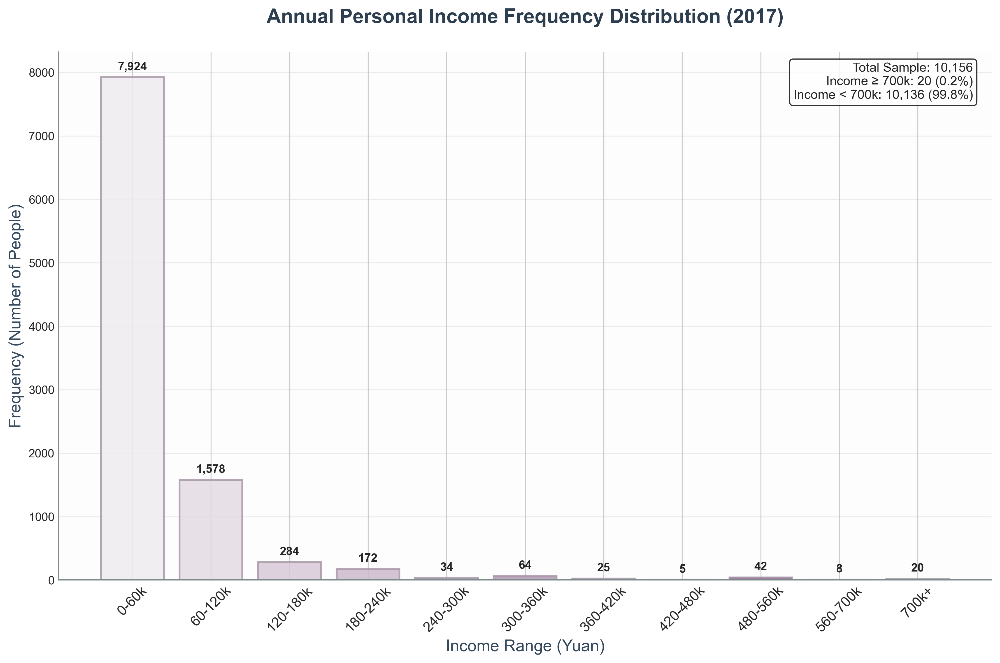

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2018:
- age_distribution_violin_2018.png (Morandi Blue)
- education_violin_plot_2018.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2018.png (Morandi Pink)
- income_density_plot_2018.png (Morandi Orange, 2017 income ≤700k)
- income_histogram_2018.png (Morandi Purple, frequency distribution with 700k+ group)


In [32]:
#2018

# CGSS2018数据可视化 - 2018年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2018 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2018年调查
        current_year = 2018
        age_vars = {}
        
        # Respondent age (from a31 - [年] 您的出生日期是什么？)
        if 'a31' in df.columns:
            # Remove invalid values: -1, -2, -3, 9999996, 9999997, 9999998, 9999999 and other invalid codes
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_birth_years = df['a31'][
                (~df['a31'].isin(invalid_birth_codes)) & 
                (df['a31'] > 1900) & 
                (df['a31'] < 2018)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 请问您父亲是哪一年出生的？)
        if 'a89a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9999996, 9999997, 9999998, 9999999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_father_birth = df['a89a'][
                (~df['a89a'].isin(invalid_birth_codes)) & 
                (df['a89a'] > 1900) & 
                (df['a89a'] < 2005)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 请问您母亲是哪一年出生的？)
        if 'a90a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9999996, 9999997, 9999998, 9999999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_mother_birth = df['a90a'][
                (~df['a90a'].isin(invalid_birth_codes)) & 
                (df['a90a'] > 1900) & 
                (df['a90a'] < 2005)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 请问您目前的配偶或同居伴侣是哪一年出生的？)
        if 'a71a' in df.columns:
            # Remove invalid values: -1 (不适用), -2 (不知道), -3 (拒绝回答), 9999996-9999999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_spouse_birth = df['a71a'][
                (~df['a71a'].isin(invalid_birth_codes)) & 
                (df['a71a'] > 1900) & 
                (df['a71a'] < 2005)
            ]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2018年教育变量，基于实际数据编码1-13（去掉14=其他、98=不知道、99=拒绝回答）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾、扫盲班
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding 14=其他, 98=不知道, 99=拒绝回答 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-1, -2, -3, 14, 98, 99, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]  # 包括14=其他, 98=不知道, 99=拒绝回答
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度是：)
        if 'a7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['a7a'][
                (~df['a7a'].isin(invalid_educ_codes)) & 
                (df['a7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度是：)
        if 'a89b' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            f_educ_clean = df['a89b'][
                (~df['a89b'].isin(invalid_educ_codes)) & 
                (df['a89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度是：)  
        if 'a90b' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            m_educ_clean = df['a90b'][
                (~df['a90b'].isin(invalid_educ_codes)) & 
                (df['a90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度是：)
        if 'a72' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            s_educ_clean = df['a72'][
                (~df['a72'].isin(invalid_educ_codes)) & 
                (df['a72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年（2017）全年的总收入)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove invalid income codes and extreme outliers
            # Keep only positive numeric income values
            income_clean = df['a8a'][
                (df['a8a'] > 0) & 
                (df['a8a'] < 5000000)  # Remove extreme outliers (adjusted for 2017)
            ]
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2018)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2018.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2018)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2018年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2018.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2018)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2018.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 700,000 (2017年收入可能更高)
        display_income = yearly_income[yearly_income <= 700000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 700000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_700k = len(yearly_income[yearly_income > 700000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 700000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 700000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2017)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 700000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2018.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 700k+ as the last group (适应2017年更高收入水平)
        bins = [0, 60000, 120000, 180000, 240000, 300000, 360000, 420000, 480000, 560000, 700000, float('inf')]
        bin_labels = ['0-60k', '60-120k', '120-180k', '180-240k', '240-300k', '300-360k', 
                     '360-420k', '420-480k', '480-560k', '560-700k', '700k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 700k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 700k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2017)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_700k = counts[-1]
        above_700k_pct = (above_700k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 700k: {above_700k:,} ({above_700k_pct:.1f}%)\n'
        stats_text += f'Income < 700k: {total_sample - above_700k:,} ({100-above_700k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2018.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2018 data visualization
    """
    # File path - 2018年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\10.CGSS2018.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2018 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9999996-9999999)")
    print("               Removing invalid education codes (-1, -2, -3, 14=其他, 98=不知道, 99=拒绝回答, 9999996-9999999)")
    print("               Removing invalid income codes and extreme outliers")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2018 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2017): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2018:")
    print("- age_distribution_violin_2018.png (Morandi Blue)")
    print("- education_violin_plot_2018.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2018.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2018.png (Morandi Orange, 2017 income ≤700k)")
        print("- income_histogram_2018.png (Morandi Purple, frequency distribution with 700k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2017 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)
               Removing invalid education codes (-1, -2, -3, 14=其他, 98=不知道, 99=拒绝回答, 9997, 9998, 9999)
               Removing invalid income codes and extreme outliers
Data loaded successfully, shape: (12582, 786)

CGSS2017 Data summary after cleaning:
  Respondent age: 12580 valid samples
  Father age: 7390 valid samples
  Mother age: 7775 valid samples
  Spouse age: 9577 valid samples
  Respondent education: 12561 valid samples
  Father education: 11683 valid samples
  Mother education: 12059 valid samples
  Spouse education: 9666 valid samples
  Yearly income (2016): 9984 valid samples
  Income range: 80 - 4,424,444 Yuan
  Mean income: 43,078 Yuan
  Median income: 30,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


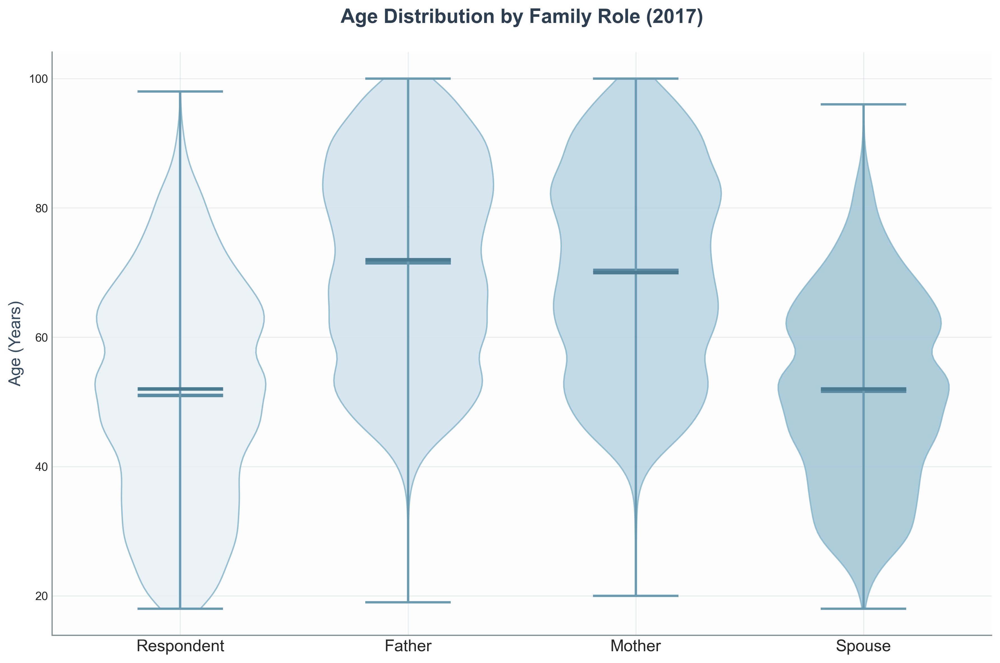

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


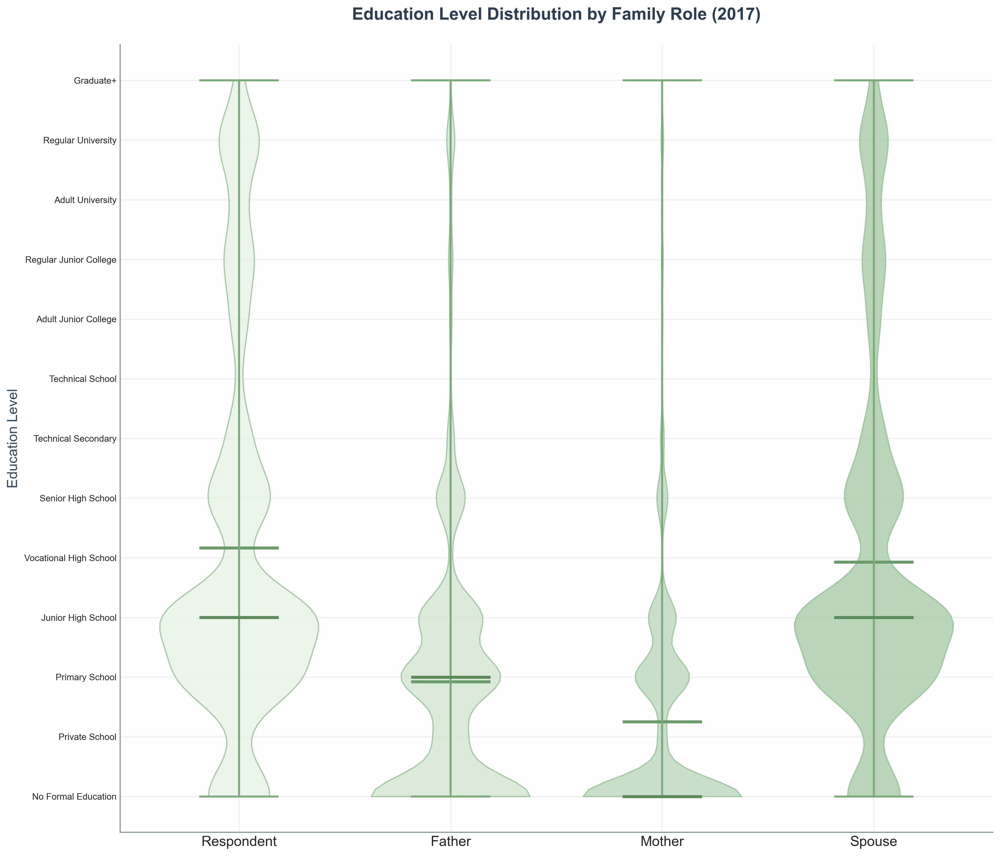

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


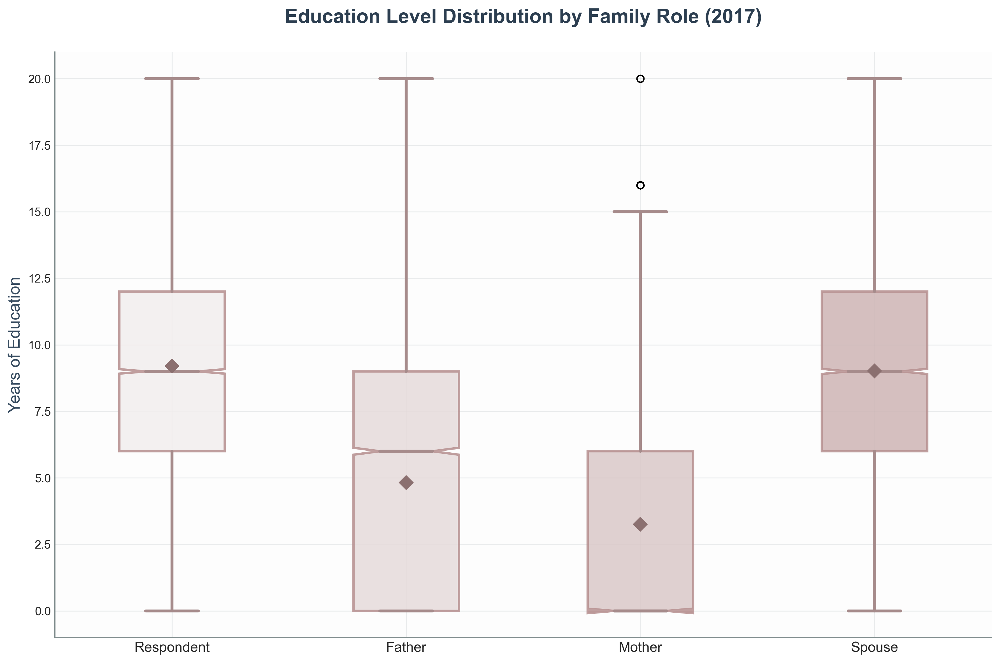

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


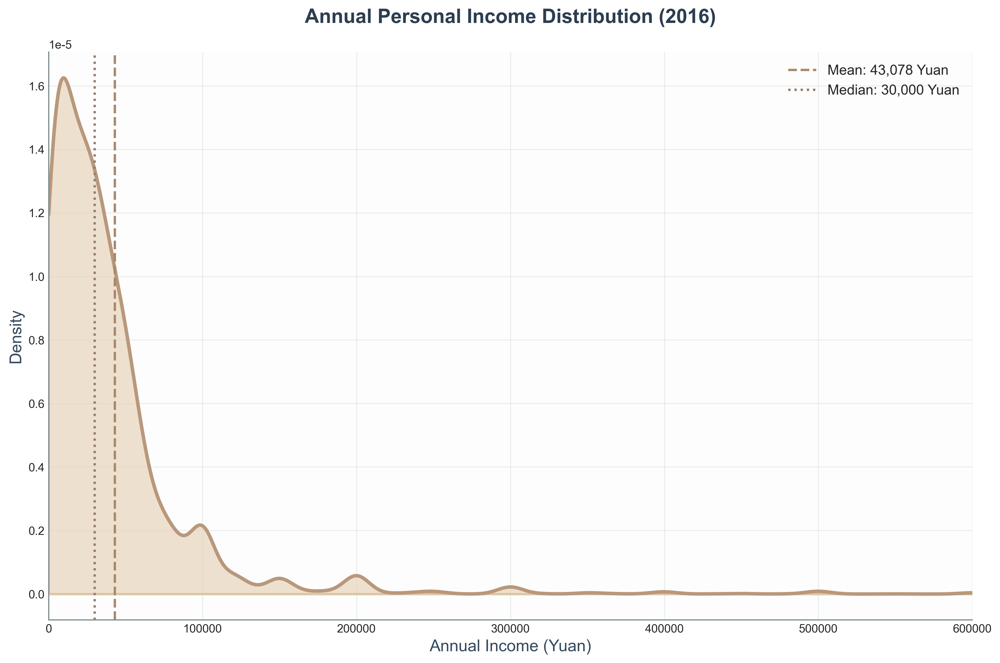

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


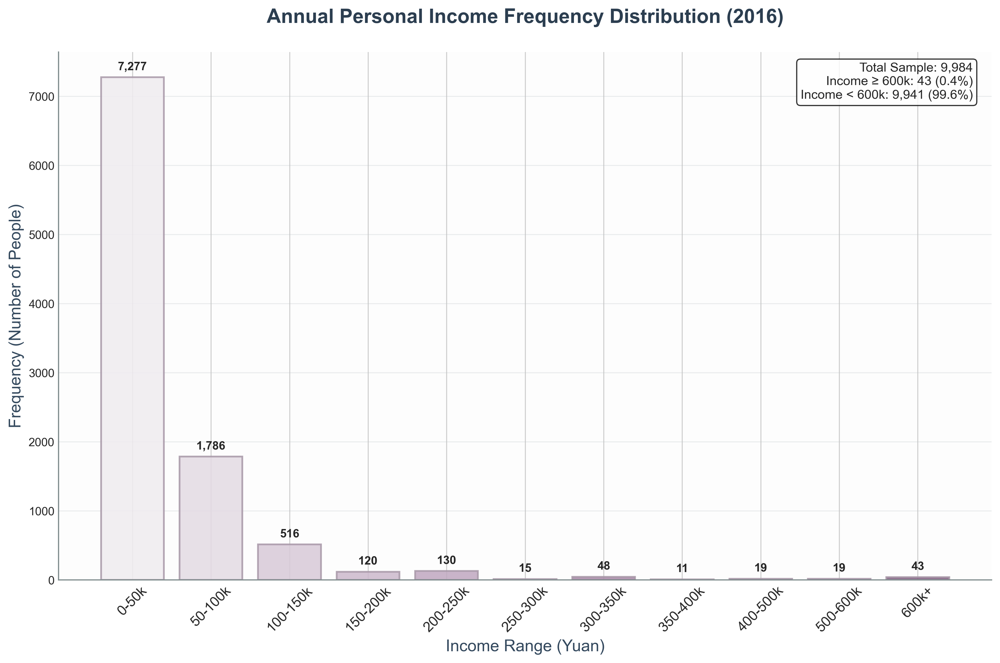

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2017:
- age_distribution_violin_2017.png (Morandi Blue)
- education_violin_plot_2017.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2017.png (Morandi Pink)
- income_density_plot_2017.png (Morandi Orange, 2016 income ≤600k)
- income_histogram_2017.png (Morandi Purple, frequency distribution with 600k+ group)


In [33]:
#2017

# CGSS2017数据可视化 - 2017年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2017 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2017年调查
        current_year = 2017
        age_vars = {}
        
        # Respondent age (from a31 - [年] 您的出生日期是什么？)
        if 'a31' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999 and other invalid codes
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_birth_years = df['a31'][
                (~df['a31'].isin(invalid_birth_codes)) & 
                (df['a31'] > 1900) & 
                (df['a31'] < 2017)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from a89a - 请问您父亲是哪一年出生的？)
        if 'a89a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_father_birth = df['a89a'][
                (~df['a89a'].isin(invalid_birth_codes)) & 
                (df['a89a'] > 1900) & 
                (df['a89a'] < 2004)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from a90a - 请问您母亲是哪一年出生的？)
        if 'a90a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9997, 9998, 9999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_mother_birth = df['a90a'][
                (~df['a90a'].isin(invalid_birth_codes)) & 
                (df['a90a'] > 1900) & 
                (df['a90a'] < 2004)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from a71a - 请问您目前的配偶或同居伴侣是哪一年出生的？)
        if 'a71a' in df.columns:
            # Remove invalid values: -1 (不适用), -2 (不知道), -3 (拒绝回答)
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999]
            valid_spouse_birth = df['a71a'][
                (~df['a71a'].isin(invalid_birth_codes)) & 
                (df['a71a'] > 1900) & 
                (df['a71a'] < 2004)
            ]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2017年教育变量，基于实际数据编码1-13（去掉14=其他和98=不知道、99=拒绝回答）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾、扫盲班
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding 14=其他, 98=不知道, 99=拒绝回答 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-1, -2, -3, 14, 98, 99, 9997, 9998, 9999]  # 包括14=其他, 98=不知道, 99=拒绝回答
        
        educ_vars = {}
        # Respondent education (from a7a - 您目前的最高教育程度是：)
        if 'a7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['a7a'][
                (~df['a7a'].isin(invalid_educ_codes)) & 
                (df['a7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from a89b - 您父亲的最高教育程度是：)
        if 'a89b' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            f_educ_clean = df['a89b'][
                (~df['a89b'].isin(invalid_educ_codes)) & 
                (df['a89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from a90b - 您母亲的最高教育程度是：)  
        if 'a90b' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            m_educ_clean = df['a90b'][
                (~df['a90b'].isin(invalid_educ_codes)) & 
                (df['a90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from a72 - 您配偶或同居伴侣目前的最高教育程度是：)
        if 'a72' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            s_educ_clean = df['a72'][
                (~df['a72'].isin(invalid_educ_codes)) & 
                (df['a72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用a8a (您个人去年（2016年）全年总收入)
        yearly_income = None
        if 'a8a' in df.columns:
            # Remove invalid income codes and extreme outliers
            # Keep only positive numeric income values
            income_clean = df['a8a'][
                (df['a8a'] > 0) & 
                (df['a8a'] < 5000000)  # Remove extreme outliers (adjusted for 2016)
            ]
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2017)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2017.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2017)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2017年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2017.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2017)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2017.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 600,000 (2016年收入可能更高)
        display_income = yearly_income[yearly_income <= 600000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 600000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_600k = len(yearly_income[yearly_income > 600000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 600000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 600000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2016)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 600000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2017.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 600k+ as the last group (适应2016年更高收入水平)
        bins = [0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, 500000, 600000, float('inf')]
        bin_labels = ['0-50k', '50-100k', '100-150k', '150-200k', '200-250k', '250-300k', 
                     '300-350k', '350-400k', '400-500k', '500-600k', '600k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 600k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 600k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2016)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_600k = counts[-1]
        above_600k_pct = (above_600k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 600k: {above_600k:,} ({above_600k_pct:.1f}%)\n'
        stats_text += f'Income < 600k: {total_sample - above_600k:,} ({100-above_600k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2017.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2017 data visualization
    """
    # File path - 2017年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\9.CGSS2017.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2017 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9997, 9998, 9999)")
    print("               Removing invalid education codes (-1, -2, -3, 14=其他, 98=不知道, 99=拒绝回答, 9997, 9998, 9999)")
    print("               Removing invalid income codes and extreme outliers")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2017 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2016): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2017:")
    print("- age_distribution_violin_2017.png (Morandi Blue)")
    print("- education_violin_plot_2017.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2017.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2017.png (Morandi Orange, 2016 income ≤600k)")
        print("- income_histogram_2017.png (Morandi Purple, frequency distribution with 600k+ group)")

if __name__ == "__main__":
    main()

Loading and processing CGSS2021 data...
Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9999996-9999999)
               Removing invalid education codes (-1, -2, -3, 14=其他, 98=不知道, 99=拒绝回答, 9999996-9999999)
               Removing invalid income codes and extreme outliers
Data loaded successfully, shape: (8148, 700)

CGSS2021 Data summary after cleaning:
  Respondent age: 8148 valid samples
  Father age: 4346 valid samples
  Mother age: 4612 valid samples
  Spouse age: 5800 valid samples
  Respondent education: 8127 valid samples
  Father education: 7390 valid samples
  Mother education: 7697 valid samples
  Spouse education: 5945 valid samples
  Yearly income (2020): 5856 valid samples
  Income range: 20 - 2,000,000 Yuan
  Mean income: 50,016 Yuan
  Median income: 30,000 Yuan

1. Generating age distribution violin plot (Morandi Blue)...


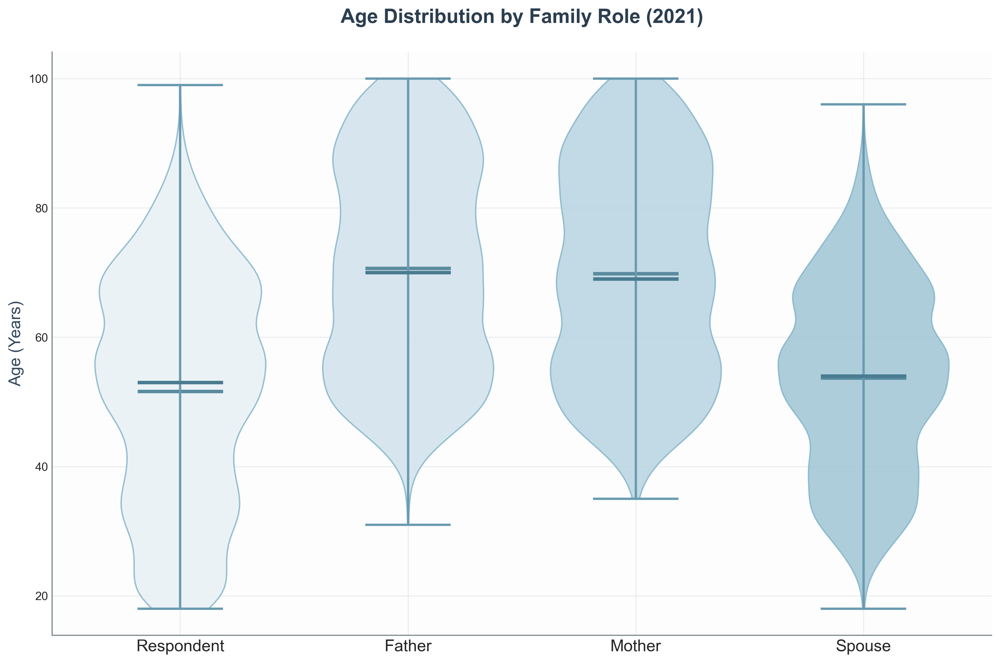

Age violin plot saved successfully!

2. Generating education violin plot with actual labels (Morandi Green)...


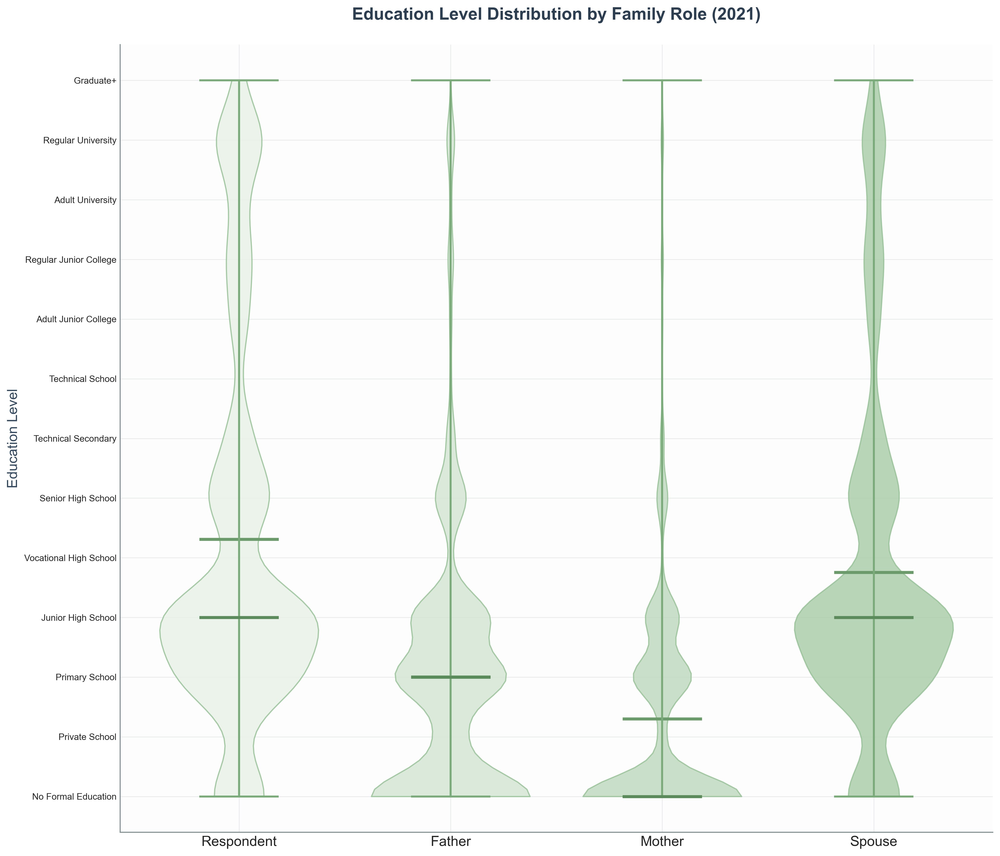

Education violin plot saved successfully!

3. Generating education box plot (Morandi Pink)...


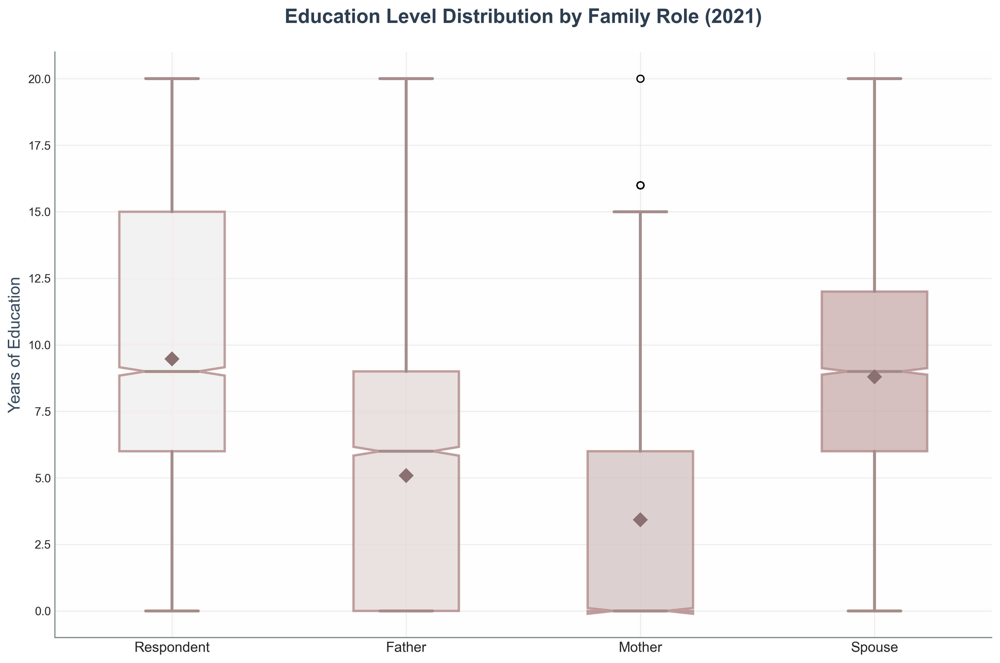

Education box plot saved successfully!

4. Generating yearly income density plot (Morandi Orange)...


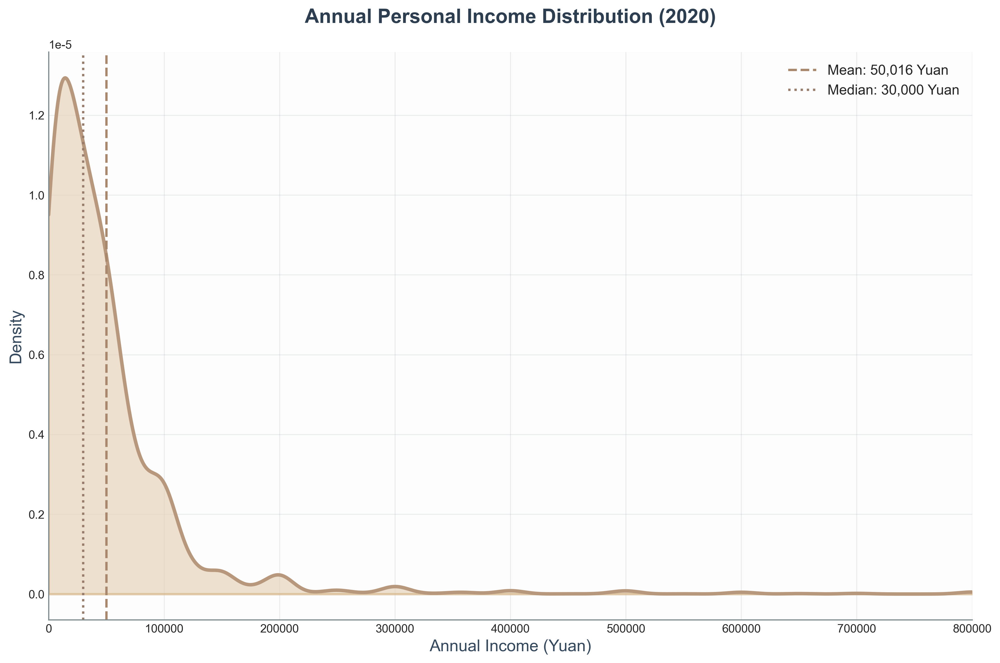

Income density plot saved successfully!

5. Generating yearly income histogram (Morandi Purple)...


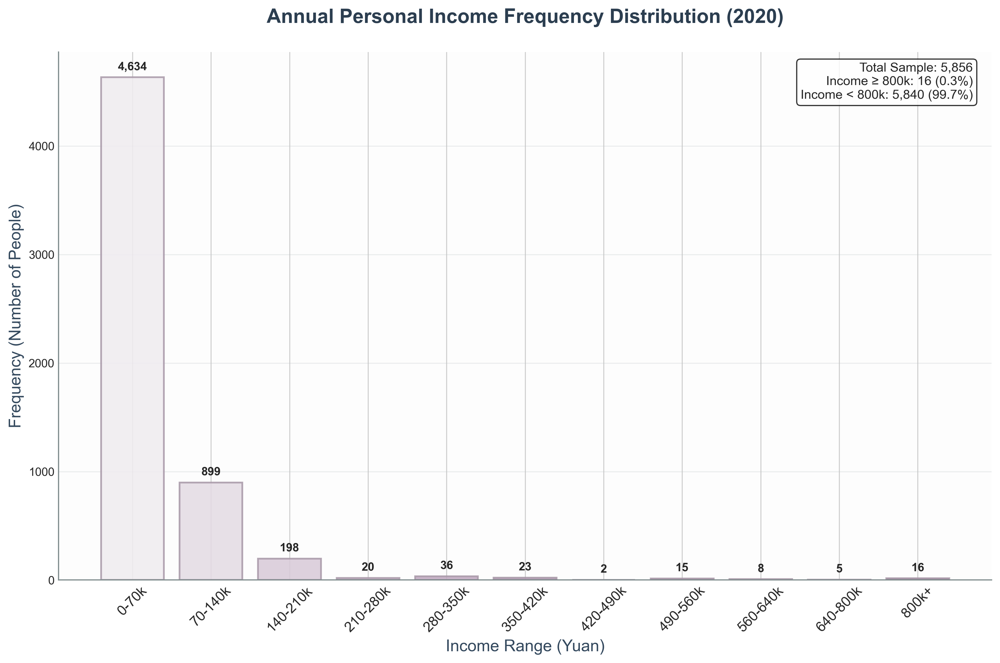

Income histogram saved successfully!

All visualizations completed! Files saved to: E:\标贝数据分析\0526画图
Generated files for CGSS2021:
- age_distribution_violin_2021.png (Morandi Blue)
- education_violin_plot_2021.png (Morandi Green, with actual education labels, excluding '其他')
- education_box_plot_2021.png (Morandi Pink)
- income_density_plot_2021.png (Morandi Orange, 2020 income ≤800k)
- income_histogram_2021.png (Morandi Purple, frequency distribution with 800k+ group)


In [34]:
#2021

#2021

# CGSS2021数据可视化 - 2021年调查

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import font_manager
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import warnings
warnings.filterwarnings('ignore')

# Set English font
plt.rcParams['font.family'] = 'Arial'
plt.rcParams['axes.unicode_minus'] = False

def load_and_process_data(file_path):
    """
    Load and process CGSS2021 data with proper data cleaning
    """
    try:
        # Read dta file
        df = pd.read_stata(file_path, convert_categoricals=False)
        print(f"Data loaded successfully, shape: {df.shape}")
        
        # Age processing - 2021年调查
        current_year = 2021
        age_vars = {}
        
        # Respondent age (from A3_1 - [年] A3. 您的出生日期是什么？)
        if 'A3_1' in df.columns:
            # Remove invalid values: -1, -2, -3, 9999996, 9999997, 9999998, 9999999 and other invalid codes
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_birth_years = df['A3_1'][
                (~df['A3_1'].isin(invalid_birth_codes)) & 
                (df['A3_1'] > 1900) & 
                (df['A3_1'] < 2021)
            ]
            if len(valid_birth_years) > 0:
                df['age'] = current_year - valid_birth_years
                age_clean = df['age'][(df['age'] >= 0) & (df['age'] <= 100)]
                age_vars['Respondent'] = age_clean.dropna()
        
        # Father age (from A89a - A89a. 请问您父亲是哪一年出生的？)
        if 'A89a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9999996, 9999997, 9999998, 9999999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_father_birth = df['A89a'][
                (~df['A89a'].isin(invalid_birth_codes)) & 
                (df['A89a'] > 1900) & 
                (df['A89a'] < 2008)
            ]
            if len(valid_father_birth) > 0:
                df['f_age'] = current_year - valid_father_birth
                f_age_clean = df['f_age'][(df['f_age'] >= 0) & (df['f_age'] <= 100)]
                age_vars['Father'] = f_age_clean.dropna()
        
        # Mother age (from A90a - A90a. 请问您母亲是哪一年出生的？)
        if 'A90a' in df.columns:
            # Remove invalid values: -1, -2, -3, 9999996, 9999997, 9999998, 9999999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_mother_birth = df['A90a'][
                (~df['A90a'].isin(invalid_birth_codes)) & 
                (df['A90a'] > 1900) & 
                (df['A90a'] < 2008)
            ]
            if len(valid_mother_birth) > 0:
                df['m_age'] = current_year - valid_mother_birth
                m_age_clean = df['m_age'][(df['m_age'] >= 0) & (df['m_age'] <= 100)]
                age_vars['Mother'] = m_age_clean.dropna()
        
        # Spouse age (from A71a - A71a. 请问您目前的配偶或同居伴侣是哪一年出生的？)
        if 'A71a' in df.columns:
            # Remove invalid values: -1 (不适用), -2 (不知道), -3 (拒绝回答), 9999996-9999999
            invalid_birth_codes = [-1, -2, -3, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]
            valid_spouse_birth = df['A71a'][
                (~df['A71a'].isin(invalid_birth_codes)) & 
                (df['A71a'] > 1900) & 
                (df['A71a'] < 2008)
            ]
            if len(valid_spouse_birth) > 0:
                df['s_age'] = current_year - valid_spouse_birth
                s_age_clean = df['s_age'][(df['s_age'] >= 0) & (df['s_age'] <= 100)]
                age_vars['Spouse'] = s_age_clean.dropna()
        
        # Education processing - 2021年教育变量，基于实际数据编码1-13（去掉14=其他、98=不知道、99=拒绝回答）
        education_labels = {
            1: 'No Formal Education',        # 没有受过任何教育
            2: 'Private School',             # 私塾、扫盲班
            3: 'Primary School',             # 小学
            4: 'Junior High School',         # 初中
            5: 'Vocational High School',     # 职业高中
            6: 'Senior High School',         # 普通高中
            7: 'Technical Secondary',        # 中专
            8: 'Technical School',           # 技校
            9: 'Adult Junior College',       # 大学专科（成人高等教育）
            10: 'Regular Junior College',    # 大学专科（正规高等教育）
            11: 'Adult University',          # 大学本科（成人高等教育）
            12: 'Regular University',        # 大学本科（正规高等教育）
            13: 'Graduate+'                  # 研究生及以上
        }
        
        # Valid education codes (1-13, excluding 14=其他, 98=不知道, 99=拒绝回答 and missing values)
        valid_educ_codes = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
        # Invalid education codes to remove
        invalid_educ_codes = [-1, -2, -3, 14, 98, 99, 9997, 9998, 9999, 9999996, 9999997, 9999998, 9999999]  # 包括14=其他, 98=不知道, 99=拒绝回答
        
        educ_vars = {}
        # Respondent education (from A7a - A7a. 您目前的最高教育程度是：)
        if 'A7a' in df.columns:
            # Remove invalid codes and missing values
            educ_clean = df['A7a'][
                (~df['A7a'].isin(invalid_educ_codes)) & 
                (df['A7a'].isin(valid_educ_codes))
            ]
            if len(educ_clean) > 0:
                educ_vars['Respondent'] = educ_clean.dropna()
        
        # Father education (from A89b - A89b. 您父亲的最高教育程度是：)
        if 'A89b' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            f_educ_clean = df['A89b'][
                (~df['A89b'].isin(invalid_educ_codes)) & 
                (df['A89b'].isin(valid_educ_codes))
            ]
            if len(f_educ_clean) > 0:
                educ_vars['Father'] = f_educ_clean.dropna()
        
        # Mother education (from A90b - A90b. 您母亲的最高教育程度是：)  
        if 'A90b' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            m_educ_clean = df['A90b'][
                (~df['A90b'].isin(invalid_educ_codes)) & 
                (df['A90b'].isin(valid_educ_codes))
            ]
            if len(m_educ_clean) > 0:
                educ_vars['Mother'] = m_educ_clean.dropna()
        
        # Spouse education (from A72 - A72. 您配偶或同居伴侣目前的最高教育程度是：)
        if 'A72' in df.columns:
            # Remove invalid codes including 14=其他, 98=不知道, 99=拒绝回答, -3=拒绝回答, -2=不知道, -1=不适用
            s_educ_clean = df['A72'][
                (~df['A72'].isin(invalid_educ_codes)) & 
                (df['A72'].isin(valid_educ_codes))
            ]
            if len(s_educ_clean) > 0:
                educ_vars['Spouse'] = s_educ_clean.dropna()
        
        # Income processing - 使用A8a (您个人去年（2020年）全年的总收入是)
        yearly_income = None
        if 'A8a' in df.columns:
            # Remove invalid income codes and extreme outliers
            # Keep only positive numeric income values
            income_clean = df['A8a'][
                (df['A8a'] > 0) & 
                (df['A8a'] < 5000000)  # Remove extreme outliers (adjusted for 2020)
            ]
            if len(income_clean) > 10:
                yearly_income = income_clean.dropna()
        
        return df, age_vars, educ_vars, yearly_income, education_labels
    
    except Exception as e:
        print(f"Data loading failed: {e}")
        return None, None, None, None, None

def create_age_violin_plot(age_vars, output_path):
    """
    Create violin plot for age distribution - Morandi Blue
    """
    morandi_blues = ['#E8F1F5', '#D1E3EC', '#B8D4E1', '#9FC5D6']
    
    # Prepare data
    main_ages = ['Respondent', 'Father', 'Mother', 'Spouse']
    box_data = []
    box_labels = []
    
    for role in main_ages:
        if role in age_vars and len(age_vars[role]) > 10:
            box_data.append(age_vars[role])
            box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi blue gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_blues)
            pc.set_facecolor(morandi_blues[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#86B6CB')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#5A8BA0')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#4A7B90')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#6A9BB0')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Age Distribution by Family Role (2021)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Age (Years)', fontsize=14, color='#34495E')
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/age_distribution_violin_2021.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Age violin plot saved successfully!")

def create_education_violin_plot(educ_vars, education_labels, output_path):
    """
    Create violin plot for education levels with actual education labels - Morandi Green
    """
    morandi_greens = ['#E8F2E8', '#D4E6D4', '#C0DAC0', '#ACCEAC']
    
    # Prepare data - keep original education codes
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            box_data.append(data)
            box_labels.append(role)
    
    plt.figure(figsize=(14, 12), dpi=300)  # Increased height for better label display
    if len(box_data) > 1:
        parts = plt.violinplot([data for data in box_data], positions=range(len(box_labels)),
                              showmeans=True, showmedians=True, widths=0.75)
        
        # Apply Morandi green gradient
        for i, pc in enumerate(parts['bodies']):
            color_index = i % len(morandi_greens)
            pc.set_facecolor(morandi_greens[color_index])
            pc.set_alpha(0.85)
            pc.set_edgecolor('#98C298')
            pc.set_linewidth(1.2)
        
        # Style lines
        if 'cmeans' in parts:
            parts['cmeans'].set_color('#6B9A6B')
            parts['cmeans'].set_linewidth(3)
        
        if 'cmedians' in parts:
            parts['cmedians'].set_color('#5B8A5B')
            parts['cmedians'].set_linewidth(3)
        
        for partname in ('cbars', 'cmins', 'cmaxes'):
            if partname in parts:
                parts[partname].set_color('#7BAA7B')
                parts[partname].set_linewidth(2)
        
        plt.xticks(range(len(box_labels)), box_labels, fontsize=14)
        plt.title('Education Level Distribution by Family Role (2021)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Education Level', fontsize=14, color='#34495E')
        
        # Set y-axis ticks and labels to show actual education meanings (1-13, 去掉14=其他)
        education_ticks = list(range(1, 14))  # 2021年教育编码从1到13
        education_tick_labels = [education_labels[i] for i in education_ticks]
        plt.yticks(education_ticks, education_tick_labels, fontsize=9, rotation=0)
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_violin_plot_2021.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education violin plot saved successfully!")

def create_education_box_plot(educ_vars, education_labels, output_path):
    """
    Create box plot for education levels - Morandi Pink
    """
    morandi_pinks = ['#F2EEEE', '#E6DBDB', '#DAC8C8', '#CEB5B5']
    
    # Prepare data - convert education codes to numeric scores for box plot
    education_scores = {
        1: 0,   # No Formal Education
        2: 2,   # Private School
        3: 6,   # Primary School
        4: 9,   # Junior High School
        5: 12,  # Vocational High School
        6: 12,  # Senior High School
        7: 15,  # Technical Secondary
        8: 12,  # Technical School
        9: 15,  # Adult Junior College
        10: 15, # Regular Junior College
        11: 16, # Adult University
        12: 16, # Regular University
        13: 20  # Graduate+
    }
    
    box_data = []
    box_labels = []
    
    for role, data in educ_vars.items():
        if len(data) > 10:
            # Convert education codes to years of education
            education_years = data.map(education_scores).dropna()
            if len(education_years) > 0:
                box_data.append(education_years)
                box_labels.append(role)
    
    plt.figure(figsize=(12, 8), dpi=300)
    
    if len(box_data) > 0:
        bp = plt.boxplot(box_data, labels=box_labels, patch_artist=True,
                        notch=True, showmeans=True)
        
        # Apply Morandi pink colors
        for i, patch in enumerate(bp['boxes']):
            patch.set_facecolor(morandi_pinks[i % len(morandi_pinks)])
            patch.set_alpha(0.85)
            patch.set_edgecolor('#B68F8F')
            patch.set_linewidth(2)
        
        # Style other elements
        for element in ['whiskers', 'fliers', 'medians', 'caps']:
            plt.setp(bp[element], color='#A68B8B', linewidth=2.5)
        
        plt.setp(bp['means'], marker='D', markerfacecolor='#8B7070', 
                markeredgecolor='#8B7070', markersize=8)
        
        plt.title('Education Level Distribution by Family Role (2021)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.ylabel('Years of Education', fontsize=14, color='#34495E')
        plt.xticks(fontsize=12)
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
    
    plt.tight_layout()
    plt.savefig(f'{output_path}/education_box_plot_2021.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Education box plot saved successfully!")

def create_income_density_plot(yearly_income, output_path):
    """
    Create density plot for yearly income distribution - Morandi Orange
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Limit display range to 800,000 (2020年收入可能更高)
        display_income = yearly_income[yearly_income <= 800000]
        
        # Create density plot
        density = stats.gaussian_kde(display_income)
        x_range = np.linspace(display_income.min(), 800000, 1000)
        density_values = density(x_range)
        
        # Fill the area under the curve with Morandi orange gradient
        plt.fill_between(x_range, density_values, alpha=0.7, 
                        color='#E8D4BA', edgecolor='#D8B88C', linewidth=2)
        
        # Add the density line
        plt.plot(x_range, density_values, color='#B8987C', linewidth=3)
        
        # Add statistics text (for all data, not just display range)
        mean_income = yearly_income.mean()
        median_income = yearly_income.median()
        above_800k = len(yearly_income[yearly_income > 800000])
        
        # Add vertical lines for mean and median (only if within display range)
        if mean_income <= 800000:
            plt.axvline(mean_income, color='#A8886C', linestyle='--', linewidth=2, 
                       label=f'Mean: {mean_income:,.0f} Yuan')
        if median_income <= 800000:
            plt.axvline(median_income, color='#987C6C', linestyle=':', linewidth=2, 
                       label=f'Median: {median_income:,.0f} Yuan')
        
        plt.title('Annual Personal Income Distribution (2020)', fontsize=17, fontweight='bold', 
                 pad=25, color='#2C3E50')
        plt.xlabel('Annual Income (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Density', fontsize=14, color='#34495E')
        
        # Set x-axis limit
        plt.xlim(0, 800000)
        
        # Add legend
        plt.legend(fontsize=12, framealpha=0.9, loc='upper right')
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8)
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
        # Format x-axis
        plt.ticklabel_format(style='plain', axis='x')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_density_plot_2021.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income density plot saved successfully!")

def create_income_histogram(yearly_income, output_path):
    """
    Create histogram for yearly income frequency distribution - Morandi Purple
    """
    plt.figure(figsize=(12, 8), dpi=300)
    
    if yearly_income is not None and len(yearly_income) > 10:
        # Create income bins with 800k+ as the last group (适应2020年更高收入水平)
        bins = [0, 70000, 140000, 210000, 280000, 350000, 420000, 490000, 560000, 640000, 800000, float('inf')]
        bin_labels = ['0-70k', '70-140k', '140-210k', '210-280k', '280-350k', '350-420k', 
                     '420-490k', '490-560k', '560-640k', '640-800k', '800k+']
        
        # Calculate frequencies
        counts, _ = np.histogram(yearly_income, bins=bins)
        
        # Create bar chart with Morandi purple gradient colors
        morandi_purples = ['#F0ECF0', '#E4DBE4', '#D8CAD8', '#CCB9CC', '#C0A8C0', 
                          '#B498B4', '#A888A8', '#9C789C', '#906890', '#845884']
        
        # Create gradient colors for bars
        bar_colors = []
        for i in range(len(bin_labels)):
            if i < len(morandi_purples):
                bar_colors.append(morandi_purples[i])
            else:
                bar_colors.append(morandi_purples[-1])
        
        # Highlight the 800k+ bar with special color
        bar_colors[-1] = '#7D5A7D'  # Darker purple for 800k+
        
        bars = plt.bar(range(len(bin_labels)), counts, 
                      color=bar_colors, edgecolor='#A898A8', 
                      linewidth=1.5, alpha=0.85)
        
        # Add value labels on bars
        for i, (bar, count) in enumerate(zip(bars, counts)):
            height = bar.get_height()
            plt.text(bar.get_x() + bar.get_width()/2., height + max(counts)*0.01,
                    f'{count:,}', ha='center', va='bottom', fontsize=10, fontweight='bold')
        
        plt.xticks(range(len(bin_labels)), bin_labels, fontsize=12, rotation=45)
        plt.title('Annual Personal Income Frequency Distribution (2020)', 
                 fontsize=17, fontweight='bold', pad=25, color='#2C3E50')
        plt.xlabel('Income Range (Yuan)', fontsize=14, color='#34495E')
        plt.ylabel('Frequency (Number of People)', fontsize=14, color='#34495E')
        
        # Add statistics
        total_sample = len(yearly_income)
        above_800k = counts[-1]
        above_800k_pct = (above_800k / total_sample) * 100
        
        # Add statistics box
        stats_text = f'Total Sample: {total_sample:,}\n'
        stats_text += f'Income ≥ 800k: {above_800k:,} ({above_800k_pct:.1f}%)\n'
        stats_text += f'Income < 800k: {total_sample - above_800k:,} ({100-above_800k_pct:.1f}%)'
        
        plt.text(0.98, 0.98, stats_text, transform=plt.gca().transAxes, 
                fontsize=11, verticalalignment='top', horizontalalignment='right',
                bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        plt.grid(True, alpha=0.3, color='#BDC3C7', linestyle='-', linewidth=0.8, axis='y')
        
        # Professional styling
        plt.gca().set_facecolor('#FDFDFD')
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)
        plt.gca().spines['left'].set_color('#7F8C8D')
        plt.gca().spines['bottom'].set_color('#7F8C8D')
        
    plt.tight_layout()
    plt.savefig(f'{output_path}/income_histogram_2021.png', dpi=600, bbox_inches='tight',
                facecolor='white', edgecolor='none')
    plt.show()
    print("Income histogram saved successfully!")

def main():
    """
    Main function for CGSS2021 data visualization
    """
    # File path - 2021年数据
    file_path = r"E:\标贝数据分析\0526画图\11组数据（按年份分类）\11.CGSS2021.dta"
    output_path = r"E:\标贝数据分析\0526画图"
    
    print("Loading and processing CGSS2021 data...")
    print("Data cleaning: Removing age > 100, invalid birth year codes (-1, -2, -3, 9999996-9999999)")
    print("               Removing invalid education codes (-1, -2, -3, 14=其他, 98=不知道, 99=拒绝回答, 9999996-9999999)")
    print("               Removing invalid income codes and extreme outliers")
    
    # Load data
    df, age_vars, educ_vars, yearly_income, education_labels = load_and_process_data(file_path)
    
    if df is None:
        print("Data loading failed, please check file path and format")
        return
    
    print(f"\nCGSS2021 Data summary after cleaning:")
    for role, data in age_vars.items():
        print(f"  {role} age: {len(data)} valid samples")
    
    for role, data in educ_vars.items():
        print(f"  {role} education: {len(data)} valid samples")
    
    if yearly_income is not None:
        print(f"  Yearly income (2020): {len(yearly_income)} valid samples")
        print(f"  Income range: {yearly_income.min():,.0f} - {yearly_income.max():,.0f} Yuan")
        print(f"  Mean income: {yearly_income.mean():,.0f} Yuan")
        print(f"  Median income: {yearly_income.median():,.0f} Yuan")
    else:
        print("  Warning: No valid yearly income data found")
    
    # Create visualizations with different Morandi colors
    print("\n1. Generating age distribution violin plot (Morandi Blue)...")
    create_age_violin_plot(age_vars, output_path)
    
    print("\n2. Generating education violin plot with actual labels (Morandi Green)...")
    create_education_violin_plot(educ_vars, education_labels, output_path)
    
    print("\n3. Generating education box plot (Morandi Pink)...")
    create_education_box_plot(educ_vars, education_labels, output_path)
    
    if yearly_income is not None:
        print("\n4. Generating yearly income density plot (Morandi Orange)...")
        create_income_density_plot(yearly_income, output_path)
        
        print("\n5. Generating yearly income histogram (Morandi Purple)...")
        create_income_histogram(yearly_income, output_path)
    else:
        print("\n4-5. Skipping income plots due to lack of valid data")
    
    print(f"\nAll visualizations completed! Files saved to: {output_path}")
    print("Generated files for CGSS2021:")
    print("- age_distribution_violin_2021.png (Morandi Blue)")
    print("- education_violin_plot_2021.png (Morandi Green, with actual education labels, excluding '其他')")
    print("- education_box_plot_2021.png (Morandi Pink)")
    if yearly_income is not None:
        print("- income_density_plot_2021.png (Morandi Orange, 2020 income ≤800k)")
        print("- income_histogram_2021.png (Morandi Purple, frequency distribution with 800k+ group)")

if __name__ == "__main__":
    main()